# Graph Embedding Approaches

# Exercise1: Normalized Laplacians:

The normalized Laplacians $L_{\text{sym}}$ and $L_{\text{rw}}$ have several important properties that make them useful for graph analysis and spectral methods. Below is a detailed breakdown of their key properties:

##### 1. Symmetric Normalized Laplacian ($L_{\text{sym}} = D^{-\frac{1}{2}} L D^{-\frac{1}{2}}$)

##### Properties:
- **Symmetry**:  
  $L_{\text{sym}}$ is symmetric, meaning $L_{\text{sym}} = L_{\text{sym}}^\top$. This property makes it well-suited for eigenvalue decomposition and spectral clustering tasks.

- **Positive Semi-Definiteness**:  
  All eigenvalues of $L_{\text{sym}}$ are non-negative ($\lambda_i \geq 0$), similar to the unnormalized Laplacian.

- **Smallest Eigenvalue**:  
  The smallest eigenvalue of $L_{\text{sym}}$ is always $0$, representing the trivial eigenvector associated with the constant function over the graph.

- **Clustering and Balance**:  
  Normalization ensures that $L_{\text{sym}}$ balances the influence of nodes with different degrees, avoiding biases toward high-degree nodes. Eigenvectors of $L_{\text{sym}}$ can be used for balanced graph partitioning in spectral clustering.

- **Spectrum (Eigenvalues)**:  
  - The number of eigenvalues equal to $0$ corresponds to the number of connected components in the graph.  
  - For a connected graph, there is exactly one $0$-eigenvalue.

- **Row and Column Sums**:  
  The rows and columns of $L_{\text{sym}}$ do not sum to $0$, unlike the random walk Laplacian. Instead, the normalization ensures proper scaling based on node degrees.

---

##### 2. Random Walk Laplacian ($L_{\text{rw}} = D^{-1} L$)

##### Properties:
- **Asymmetry**:  
  $L_{\text{rw}}$ is generally not symmetric. This reflects its connection to random walk dynamics, which are inherently directional processes.

- **Positive Semi-Definiteness**:  
  Like $L_{\text{sym}}$, all eigenvalues of $L_{\text{rw}}$ are non-negative ($\lambda_i \geq 0$).

- **Smallest Eigenvalue**:  
  The smallest eigenvalue of $L_{\text{rw}}$ is $0$, corresponding to the constant eigenvector.

- **Interpretation as a Markov Process**:  
  $L_{\text{rw}}$ relates closely to the transition matrix of a random walk on the graph:
  $$
  P = D^{-1}A \quad \text{(random walk transition matrix)}, \quad L_{\text{rw}} = I - P
  $$  
  This means $L_{\text{rw}}$ models deviations from the stationary distribution of a random walk.

- **Row Sums**:  
  Each row of $L_{\text{rw}}$ sums to $0$. This reflects the conservation property of the random walk probabilities.

- **Clustering**:  
  The eigenvectors of $L_{\text{rw}}$ can be used for spectral clustering, especially when modeling diffusion-like processes in the graph.

---

##### 3. Shared Properties of $L_{\text{sym}}$ and $L_{\text{rw}}$
- **Non-Negative Eigenvalues**:  
  Both normalized Laplacians are positive semi-definite, ensuring non-negative eigenvalues.

- **Connected Components**:  
  For both $L_{\text{sym}}$ and $L_{\text{rw}}$, the number of $0$-eigenvalues indicates the number of connected components in the graph.

- **Normalization**:  
  Both Laplacians adjust for the degree of nodes, ensuring that the influence of high-degree nodes is normalized.

- **Applications**:  
  Both $L_{\text{sym}}$ and $L_{\text{rw}}$ are widely used in spectral clustering, graph signal processing, and random walk modeling.

---

##### 4. Comparison Between $L_{\text{sym}}$ and $L_{\text{rw}}$

| **Property** | **$L_{\text{sym}}$** | **$L_{\text{rw}}$** |
|--------------|---------------------|-------------------|
| **Symmetry** | Symmetric | Not symmetric |
| **Row Sums** | Rows do not sum to 0 | Rows sum to 0 |
| **Clustering Focus** | Balanced clusters | Diffusion-like clusters |
| **Spectral Clustering** | Well-suited for eigenvalue decomposition | Used for Markov processes or random walks |
| **Normalization Type** | Symmetric normalization | Row normalization |


## Example 1.1. Simple Custom Graph (4-node graph with a cycle)

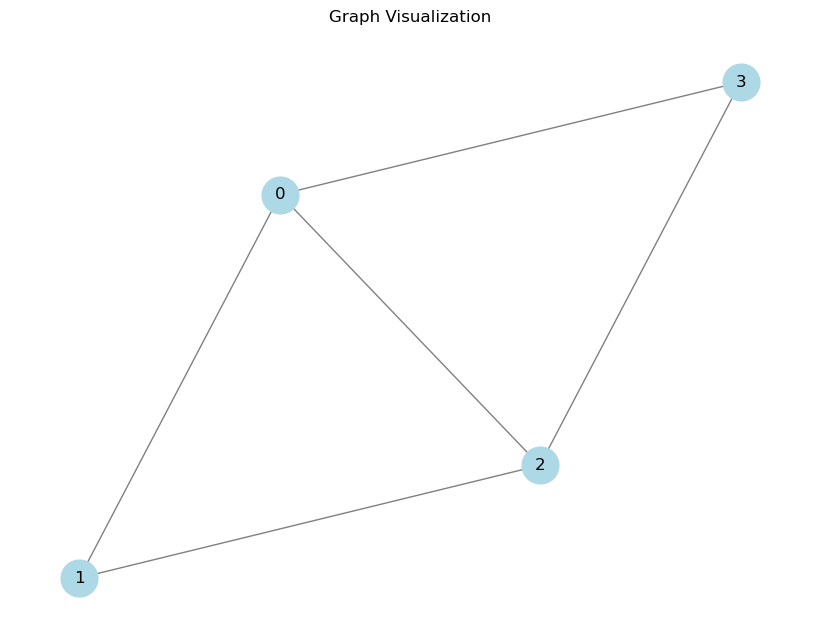

In [1]:
import networkx as nx
import numpy as np
from scipy.linalg import eigvals
import matplotlib.pyplot as plt

# 1. Create a simple graph
G = nx.Graph()
edges = [(0, 1), (1, 2), (2, 3), (3, 0), (0, 2)]  
G.add_edges_from(edges)

# Graph visualization
pos = nx.spring_layout(G)  
plt.figure(figsize=(8, 6))
nx.draw(
    G, pos, with_labels=True, node_color='lightblue', edge_color='gray', node_size=700, font_size=12
)
plt.title("Graph Visualization")
plt.show()


In [2]:
# 2. Compute adjacency matrix and degree matrix
A = nx.adjacency_matrix(G).toarray()
degrees = np.sum(A, axis=1)
D = np.diag(degrees)


In [3]:
# 3. Compute unnormalized Laplacian
L = D - A

In [4]:
# 4. Compute normalized Laplacians

D_inv_sqrt = np.diag(1 / np.sqrt(degrees))
D_inv = np.diag(1 / degrees)
L_sym = D_inv_sqrt @ L @ D_inv_sqrt  # Symmetric normalized Laplacian
L_rw = D_inv @ L                     # Random walk Laplacian

In [5]:
# 5. Analyze properties

In [6]:
# Symmetry
print("Is L_sym symmetric?", np.allclose(L_sym, L_sym.T))


Is L_sym symmetric? True


In [7]:
# Eigenvalues
eig_L_sym = eigvals(L_sym)
print("Eigenvalues of L_sym:", eig_L_sym)


Eigenvalues of L_sym: [0.        +0.j 1.33333333+0.j 1.66666667+0.j 1.        +0.j]


In [8]:
eig_L_rw = eigvals(L_rw)
print("Eigenvalues of L_rw:", eig_L_rw)

Eigenvalues of L_rw: [0.        +0.j 1.33333333+0.j 1.66666667+0.j 1.        +0.j]


In [9]:
# Smallest Eigenvalue

print("Smallest eigenvalue of L_sym:", np.min(eig_L_sym))
print("Smallest eigenvalue of L_rw:", np.min(eig_L_rw))


Smallest eigenvalue of L_sym: 0j
Smallest eigenvalue of L_rw: 0j


In [10]:
# Row sums

print("Row sums of L_sym:", np.sum(L_sym, axis=1))
print("Row sums of L_rw:", np.sum(L_rw, axis=1))

Row sums of L_sym: [-0.14982991  0.18350342 -0.14982991  0.18350342]
Row sums of L_rw: [1.11022302e-16 0.00000000e+00 5.55111512e-17 0.00000000e+00]


In [11]:
# Connected components

num_zero_eigenvalues_L_sym = np.sum(np.isclose(eig_L_sym, 0))
num_zero_eigenvalues_L_rw = np.sum(np.isclose(eig_L_rw, 0))
print("Number of connected components (L_sym):", num_zero_eigenvalues_L_sym)
print("Number of connected components (L_rw):", num_zero_eigenvalues_L_rw)

Number of connected components (L_sym): 1
Number of connected components (L_rw): 1


## Example 1.2 Protein-Protein Interaction (PPI) Network

##### Understanding the Biological Context

Proteins in a cell **interact** to perform biological functions. These interactions can be represented as a **graph**, where:
- **Nodes** represent **proteins**.
- **Edges** represent **interactions** between proteins.

##### Protein Hubs and Sparse Interactions
- Some proteins interact with **many** others. These are called **hubs** (e.g., TP53, a key protein in cancer research).
- Other proteins interact with **only a few** specific partners.

#####  Why Use Normalized Laplacians?
Since some proteins are **highly connected** while others are not, we need a fair way to **group similar proteins**. **Normalized Laplacians** help:
1. **Balance connections** so that hubs do not dominate.
2. **Identify protein clusters** that work together in biological processes.
3. **Model information flow** in the network, like how signals pass in a cell.

This helps in tasks like **drug discovery, disease gene identification, and metabolic pathway analysis**.


In [12]:
# Load a Real PPI Network from STRING Database

In [13]:
# pip install pyvis

In [14]:
import networkx as nx
import pandas as pd
from pyvis.network import Network

# Load STRING PPI network data (E. coli protein interactions)
url = "https://stringdb-static.org/download/protein.links.v11.5/511145.protein.links.v11.5.txt.gz"
df = pd.read_csv(url, sep=" ", compression="gzip")

# Filter to get the top 200 strongest interactions
df_filtered = df.sort_values("combined_score", ascending=False).head(200)

# Create a NetworkX graph
G = nx.Graph()
for _, row in df_filtered.iterrows():
    G.add_edge(row["protein1"], row["protein2"], weight=row["combined_score"])

# Compute node degrees
degree_dict = dict(G.degree())

# Generate optimized node layout
pos = nx.spring_layout(G, k=0.25, seed=42)

# Identify top 10 hub proteins (highest degree nodes)
top_hubs = sorted(degree_dict, key=degree_dict.get, reverse=True)[:10]

# Create a Pyvis interactive network
net = Network(notebook=True, height="750px", width="100%", bgcolor="white", font_color="black")

# ====== Stable Physics Settings ======
net.barnes_hut(gravity=-2000,  # Lower gravity to prevent excessive node spreading
               central_gravity=0.1,  # Keeps nodes loosely attracted to the center
               spring_length=300,  # Increase to prevent nodes from clustering too much
               spring_strength=0.01,  # Keeps spacing gentle
               damping=1)  # Slows down movement for a more stable layout

# Add nodes with professional styling
for node in G.nodes():
    net.add_node(
        node, 
        title=f"Protein: {node}<br>Degree: {degree_dict[node]}",
        size=(degree_dict[node] * 2) if node in top_hubs else (degree_dict[node] * 1.5),
        color="red" if node in top_hubs else "blue"
    )

# Add edges with weight-based transparency and thickness
for edge in G.edges(data=True):
    net.add_edge(edge[0], edge[1], 
                 width=edge[2]['weight'] / 500,  # Scale edge thickness
                 color="gray")

# Enable physics with stabilized settings
net.toggle_physics(True)

# Save as an interactive HTML file
net.show("ppi_network.html")


ppi_network.html


In [15]:
# Compute Normalized Laplacians

In [16]:
from scipy.linalg import fractional_matrix_power

In [17]:
# Compute adjacency and degree matrices

A = nx.to_numpy_array(G, weight='weight')  # Adjacency matrix
D = np.diag(A.sum(axis=1))  # Degree matrix
L = D - A  # Standard Laplacian

# Compute Normalized Laplacians
D_inv_sqrt = fractional_matrix_power(D, -0.5)  # D^(-1/2)
L_sym = D_inv_sqrt @ L @ D_inv_sqrt  # Symmetric normalized Laplacian
L_rw = np.linalg.inv(D) @ L  # Random walk Laplacian

# Display Matrices
df_L_sym = pd.DataFrame(L_sym)
df_L_rw = pd.DataFrame(L_rw)

# print("Symmetric Normalized Laplacian (L_sym)", df_L_sym)
# print("Random Walk Laplacian (L_rw)", df_L_rw)


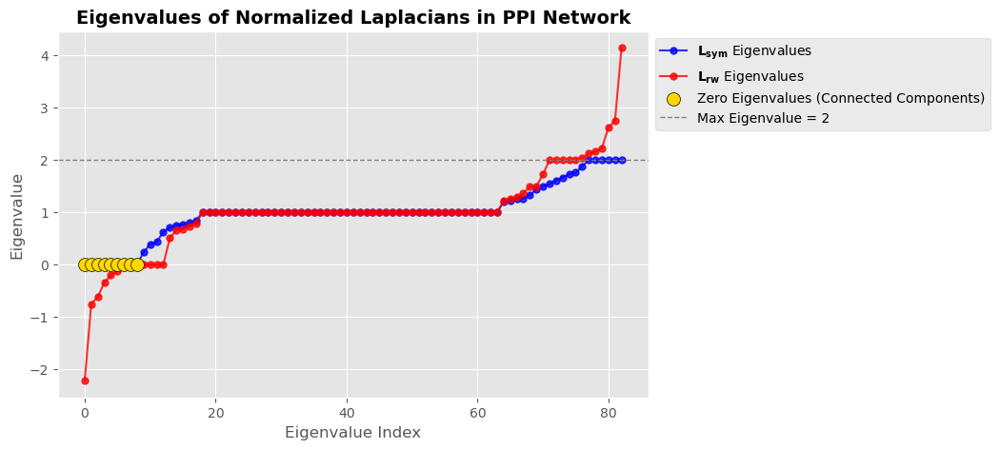

In [18]:
import numpy as np
import matplotlib.pyplot as plt

# Compute eigenvalues
eigenvalues_Lsym, _ = np.linalg.eigh(L_sym)
eigenvalues_Lrw, _ = np.linalg.eigh(L_rw)

# Sort eigenvalues for plotting
eigenvalues_Lsym_sorted = sorted(eigenvalues_Lsym)
eigenvalues_Lrw_sorted = sorted(eigenvalues_Lrw)

# Define figure size and style
plt.figure(figsize=(8, 5))
plt.style.use("ggplot")  # Improved styling

# Plot L_sym eigenvalues
plt.plot(eigenvalues_Lsym_sorted, 'bo-', label=r'$\mathbf{L_{sym}}$ Eigenvalues', markersize=5, alpha=0.8)

# Plot L_rw eigenvalues
plt.plot(eigenvalues_Lrw_sorted, 'ro-', label=r'$\mathbf{L_{rw}}$ Eigenvalues', markersize=5, alpha=0.8)

# Highlight zero eigenvalues (connected components)
zero_indices = np.where(np.isclose(eigenvalues_Lsym_sorted, 0, atol=1e-3))[0]
if len(zero_indices) > 0:
    plt.scatter(zero_indices, np.zeros_like(zero_indices), color='gold', s=100, edgecolors='black', 
                label="Zero Eigenvalues (Connected Components)", zorder=3)

# Add max eigenvalue reference line
plt.axhline(y=2, color='gray', linestyle="dashed", linewidth=1, label="Max Eigenvalue = 2")

# Labels and title
plt.xlabel("Eigenvalue Index", fontsize=12)
plt.ylabel("Eigenvalue", fontsize=12)
plt.title("Eigenvalues of Normalized Laplacians in PPI Network", fontsize=14, fontweight="bold")

# Add legend outside the plot
plt.legend(loc="upper left", bbox_to_anchor=(1, 1), fontsize=10)

# Show plot
plt.show()


#### Eigenvalue Analysis of the PPI Network

The sorted eigenvalues of the **symmetric normalized Laplacian** (\(\mathbf{L_{sym}}\)) and **random walk Laplacian** (\(\mathbf{L_{rw}}\)) reveal important structural properties of the protein-protein interaction (PPI) network.

##### **Observations**
- **Zero Eigenvalues & Disconnected Components**  
  - Multiple eigenvalues are **extremely close to zero**, indicating **several disconnected subgraphs**.  
  - **Biological Interpretation**: These represent **independent functional pathways or protein families**.

- **Maximum Eigenvalues Near 2**  
  - The largest eigenvalues in \( \mathbf{L_{rw}} \) **slightly exceed 2**, suggesting **numerical instability or weakly connected components**.  
  - **Biological Interpretation**: Some **loosely connected proteins** might act as **peripheral nodes**.

- **Large Eigenvalue Gap (~1.0 to 1.2, 1.7 to 2.0)**  
  - Significant jumps in eigenvalues suggest **natural spectral clusters**.  
  - **Biological Interpretation**: The network contains **distinct protein communities**, likely representing **functionally different biological pathways**.

- **Eigenvalues Clustered Around 1.0**  
  - Most eigenvalues **concentrate near 1.0**, indicating **similar node connectivity**.  
  - **Biological Interpretation**: The network is **moderately connected**, without extreme **central hubs dominating the structure**.

##### **Conclusion**
These spectral properties suggest that the **PPI network consists of well-defined functional modules** with **weakly connected outliers**. Spectral clustering can help identify **biologically meaningful protein groups**.


In [19]:
# Clustering Proteins using Spectral Clustering

Proteins that cluster together based on eigenvectors of normalized Laplacians are likely to perform similar biological functions.

In [20]:
import networkx as nx
import numpy as np
import pandas as pd
from pyvis.network import Network
from sklearn.cluster import KMeans

# Number of clusters
num_clusters = 4  

# Compute eigenvectors for clustering (skip first eigenvector)
eigenvectors = np.linalg.eigh(L_sym)[1][:, 1:num_clusters]  

# Apply K-Means clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=42, n_init=10)
clusters = kmeans.fit_predict(eigenvectors)

# Assign cluster labels to proteins
protein_labels = {protein: clusters[i] for i, protein in enumerate(G.nodes)}

# Compute node degrees
degree_dict = dict(G.degree())

# Generate fixed node positions using NetworkX
pos = nx.spring_layout(G, k=0.3, seed=42)  # Stable node positioning

# Create a PyVis interactive network (Enable notebook mode)
net = Network(height="750px", width="100%", bgcolor="white", font_color="black", notebook=True)

# Define color palette for clusters
color_palette = ["#FF5733", "#33FF57", "#3357FF", "#F0E68C"]  # Use distinct colors

# Add nodes with clustering information
for node in G.nodes():
    x, y = pos[node]  # Get fixed positions
    net.add_node(
        node,
        title=f"Protein: {node}<br>Degree: {degree_dict[node]}<br>Cluster: {protein_labels[node]}",
        size=np.log1p(degree_dict[node]) * 10,  # Scale node size based on degree
        color=color_palette[protein_labels[node] % len(color_palette)],
        x=x * 1000,  # Scale position for PyVis
        y=y * 1000
    )

# Add edges with proper width scaling
for edge in G.edges(data=True):
    net.add_edge(edge[0], edge[1], width=max(edge[2]["weight"] / 500, 0.5), color="gray")

# Disable excessive movement by adjusting physics settings
net.barnes_hut(gravity=-3000, central_gravity=0.1, spring_length=250, damping=0.8)

# Render directly in Jupyter Notebook or a script
net.show("notebook.html")  # In Jupyter Notebook, renders inline


notebook.html


### Choosing Optimal Clusters Using Spectral Gap

The **sorted eigenvalues** of the **normalized Laplacian** reveal a **large gap** between **λ₄ ≈ 0.629** and **λ₅ ≈ 0.709**. This suggests an **optimal cluster number** of **k ≈ 4**.

##### **Insights**
- **Spectral Gap Method**: The **largest jump in eigenvalues** indicates the **best partitioning**.
- **Before λ₄**: Eigenvalues are **small and stable**, suggesting **well-formed clusters**.
- **After λ₅**: Eigenvalues approach **1**, meaning **less structured data**.
- **Conclusion**: **k = 4** is optimal, but **k = 5** is an alternative.

Using **k = 4** ensures **clear biological clusters** in the protein network.


### Interpretation of Clustering in the PPI Network

| **Feature**                           | **What It Means for Clustering?**                  | **Biological Insight**                         |
|----------------------------------------|--------------------------------------------------|-----------------------------------------------|
| **Tightly grouped same-colored nodes** | Proteins in the same cluster have strong relationships | Likely **functionally related proteins**     |
| **Large nodes within a cluster**       | Hub proteins play a central role in a pathway     | Key **regulators or essential proteins**     |
| **Fewer edges between clusters**       | Weak interaction between different groups        | Different **protein families or pathways**   |
| **Hovering over a node shows its cluster ID** | Confirms correct cluster assignment | Ensures **clustering is meaningful**        |

##### **Main Points**
- **Proteins in the same cluster** are **likely part of the same biological function**.
- **Hub proteins (large nodes)** highlight **central players in a biological pathway**.
- **Fewer connections between clusters** indicate **distinct protein families**.
- **Hovering over nodes** helps **verify clustering accuracy**.

This helps in **identifying functional modules** and **understanding biological relationships** within the PPI network.


# Exercise 2: Compare the different Clusterings using different Laplacian Eigenmaps

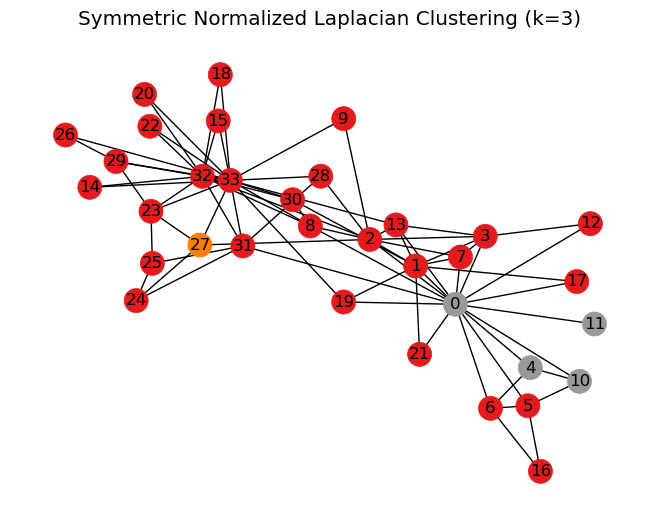

In [21]:
import networkx as nx
import numpy as np
from scipy.sparse.linalg import eigsh
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score
import matplotlib.pyplot as plt
import pandas as pd

# Step 1: Create a graph
G = nx.karate_club_graph()  # Example graph (Karate Club)

# Step 2: Compute different Laplacians
# Degree matrix
degrees = np.diag([d for _, d in G.degree()])
adjacency = nx.to_numpy_array(G)

# Unnormalized Laplacian
L = degrees - adjacency

# Symmetric normalized Laplacian
D_sqrt_inv = np.linalg.inv(np.sqrt(degrees))
L_sym = D_sqrt_inv @ L @ D_sqrt_inv

# Random walk Laplacian
D_inv = np.linalg.inv(degrees)
L_rw = D_inv @ L

# Step 3: Compute the k smallest eigenvectors for each Laplacian
def compute_eigenvectors(L, k):
    eigvals, eigvecs = eigsh(L, k=k, which='SM')  # Smallest k eigenvalues
    return eigvecs

k_values = [2, 3, 4, 5]  # Different numbers of clusters to test
results = []

for k in k_values:
    eigvecs_unnormalized = compute_eigenvectors(L, k)
    eigvecs_sym = compute_eigenvectors(L_sym, k)
    eigvecs_rw = compute_eigenvectors(L_rw, k)

    # Step 4: Apply k-means clustering
    def apply_kmeans(eigvecs, k):
        kmeans = KMeans(n_clusters=k, random_state=0).fit(eigvecs)
        return kmeans.labels_

    labels_unnormalized = apply_kmeans(eigvecs_unnormalized, k)
    labels_sym = apply_kmeans(eigvecs_sym, k)
    labels_rw = apply_kmeans(eigvecs_rw, k)

    # Step 5: Evaluate clustering
    def evaluate_clustering(labels, adjacency):
        # Compute silhouette score (higher is better)
        return silhouette_score(adjacency, labels, metric='euclidean')

    silhouette_unnormalized = evaluate_clustering(labels_unnormalized, adjacency)
    silhouette_sym = evaluate_clustering(labels_sym, adjacency)
    silhouette_rw = evaluate_clustering(labels_rw, adjacency)

    # Collect results for each k and Laplacian type
    results.append({
        "k": k,
        "Laplacian": "Unnormalized",
        "Silhouette Score": silhouette_unnormalized
    })
    results.append({
        "k": k,
        "Laplacian": "Symmetric Normalized",
        "Silhouette Score": silhouette_sym
    })
    results.append({
        "k": k,
        "Laplacian": "Random Walk",
        "Silhouette Score": silhouette_rw
    })

# Convert results to a DataFrame for better visualization
results_df = pd.DataFrame(results)


# Visualize clustering for a specific k and Laplacian type
def visualize_clustering(G, labels, title):
    pos = nx.spring_layout(G)  # Layout for graph visualization
    nx.draw(G, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1)
    plt.title(title)
    plt.show()

# Example visualization for k=3
k_to_visualize = 3
eigvecs_sym_to_visualize = compute_eigenvectors(L_sym, k_to_visualize)
labels_sym_to_visualize = apply_kmeans(eigvecs_sym_to_visualize, k_to_visualize)
visualize_clustering(G, labels_sym_to_visualize, f"Symmetric Normalized Laplacian Clustering (k={k_to_visualize})")


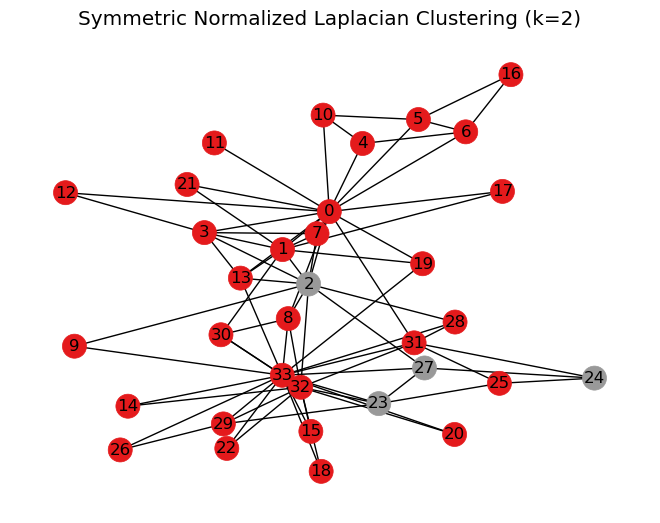

In [22]:
# Example visualization for k=3
k_to_visualize = 2
eigvecs_sym_to_visualize = compute_eigenvectors(L_sym, k_to_visualize)
labels_sym_to_visualize = apply_kmeans(eigvecs_sym_to_visualize, k_to_visualize)
visualize_clustering(G, labels_sym_to_visualize, f"Symmetric Normalized Laplacian Clustering (k={k_to_visualize})")


In [23]:
# Modify the Laplacian computation to handle singular matrices
def test_spectral_clustering_on_graph_fixed(graph, graph_name, k_values):
    # Remove isolated nodes to avoid singular degree matrices
    graph = graph.copy()
    graph.remove_nodes_from(list(nx.isolates(graph)))

    # Adjacency matrix and degree matrix
    adjacency = nx.to_numpy_array(graph)
    degrees = np.diag([d for _, d in graph.degree()])

    # Compute Laplacians
    L = degrees - adjacency  # Unnormalized Laplacian
    with np.errstate(divide='ignore', invalid='ignore'):  # Ignore warnings for division by zero
        D_sqrt_inv = np.linalg.pinv(np.sqrt(degrees))  # Use pseudo-inverse to handle singular matrices
        L_sym = D_sqrt_inv @ L @ D_sqrt_inv  # Symmetric normalized Laplacian
        D_inv = np.linalg.pinv(degrees)
        L_rw = D_inv @ L  # Random walk Laplacian

    results = []

    for k in k_values:
        # Compute eigenvectors
        eigvecs_unnormalized = compute_eigenvectors(L, k)
        eigvecs_sym = compute_eigenvectors(L_sym, k)
        eigvecs_rw = compute_eigenvectors(L_rw, k)

        # Apply k-means clustering
        labels_unnormalized = apply_kmeans(eigvecs_unnormalized, k)
        labels_sym = apply_kmeans(eigvecs_sym, k)
        labels_rw = apply_kmeans(eigvecs_rw, k)

        # Evaluate clustering
        silhouette_unnormalized = evaluate_clustering(labels_unnormalized, adjacency)
        silhouette_sym = evaluate_clustering(labels_sym, adjacency)
        silhouette_rw = evaluate_clustering(labels_rw, adjacency)

        # Store results
        results.append({
            "Graph": graph_name,
            "k": k,
            "Laplacian": "Unnormalized",
            "Silhouette Score": silhouette_unnormalized
        })
        results.append({
            "Graph": graph_name,
            "k": k,
            "Laplacian": "Symmetric Normalized",
            "Silhouette Score": silhouette_sym
        })
        results.append({
            "Graph": graph_name,
            "k": k,
            "Laplacian": "Random Walk",
            "Silhouette Score": silhouette_rw
        })

    return results

# Run spectral clustering tests on each graph with fixed Laplacian computation
all_results_fixed = []

graphs = {
    "Karate Club": nx.karate_club_graph(),
    "Erdős-Rényi": nx.erdos_renyi_graph(34, 0.1),  # Random graph
    "Erdős-Rényi_Dense_Graph": nx.erdos_renyi_graph(50, 0.8),  # Dense graph
    "Erdős-Rényi_Sparse_Graph": nx.erdos_renyi_graph(50, 0.1),  # Sparse graph
    "Barabási-Albert": nx.barabasi_albert_graph(34, 2)  # Scale-free graph
}

for graph_name, graph in graphs.items():
    results = test_spectral_clustering_on_graph_fixed(graph, graph_name, k_values)
    all_results_fixed.extend(results)

# Convert results to a DataFrame for better visualization
all_results_fixed_df = pd.DataFrame(all_results_fixed)



In [24]:
print(all_results_fixed_df)


                       Graph  k             Laplacian  Silhouette Score
0                Karate Club  2          Unnormalized          0.051609
1                Karate Club  2  Symmetric Normalized          0.122548
2                Karate Club  2           Random Walk         -0.021340
3                Karate Club  3          Unnormalized         -0.253062
4                Karate Club  3  Symmetric Normalized         -0.062811
5                Karate Club  3           Random Walk         -0.076897
6                Karate Club  4          Unnormalized         -0.263564
7                Karate Club  4  Symmetric Normalized         -0.117984
8                Karate Club  4           Random Walk         -0.036807
9                Karate Club  5          Unnormalized         -0.264034
10               Karate Club  5  Symmetric Normalized         -0.141516
11               Karate Club  5           Random Walk         -0.175155
12               Erdős-Rényi  2          Unnormalized         -0

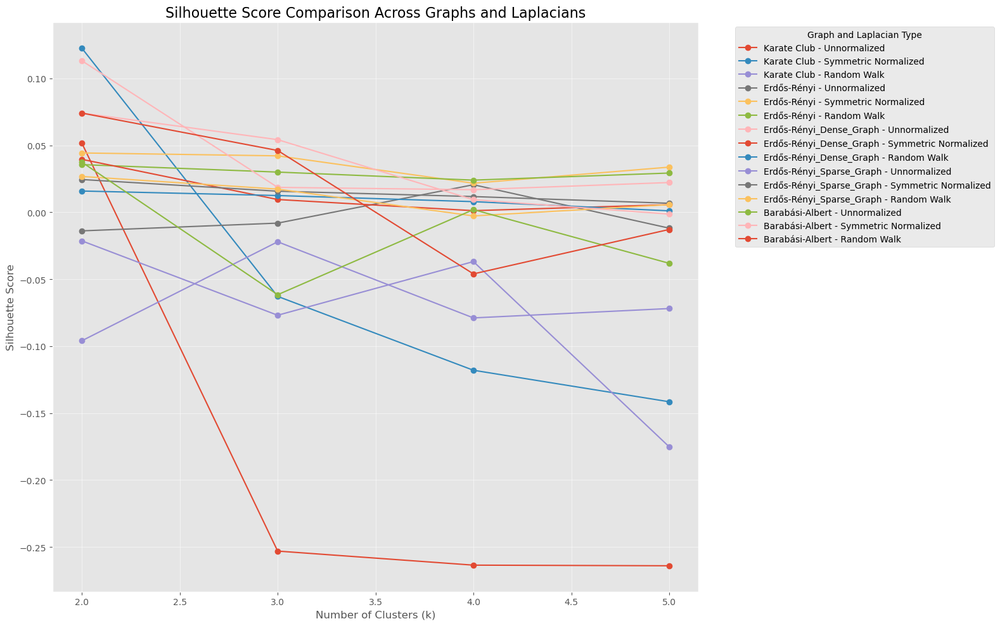

In [25]:
plt.figure(figsize=(16, 10))

# Iterate over each graph type and create a subplot
graphs = all_results_fixed_df["Graph"].unique()
for graph in graphs:
    graph_data = all_results_fixed_df[all_results_fixed_df["Graph"] == graph]
    for laplacian in graph_data["Laplacian"].unique():
        subset = graph_data[graph_data["Laplacian"] == laplacian]
        plt.plot(
            subset["k"],
            subset["Silhouette Score"],
            marker='o',
            label=f"{graph} - {laplacian}"
        )

plt.title("Silhouette Score Comparison Across Graphs and Laplacians", fontsize=16)
plt.xlabel("Number of Clusters (k)", fontsize=12)
plt.ylabel("Silhouette Score", fontsize=12)
plt.legend(title="Graph and Laplacian Type", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(alpha=0.5)
plt.tight_layout()
plt.show()

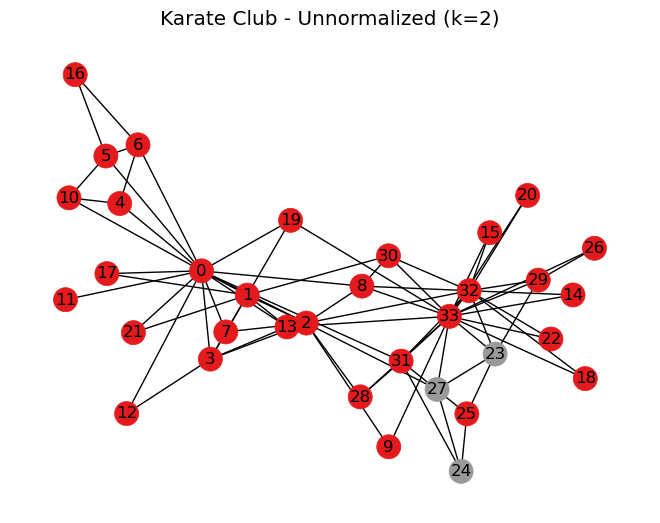

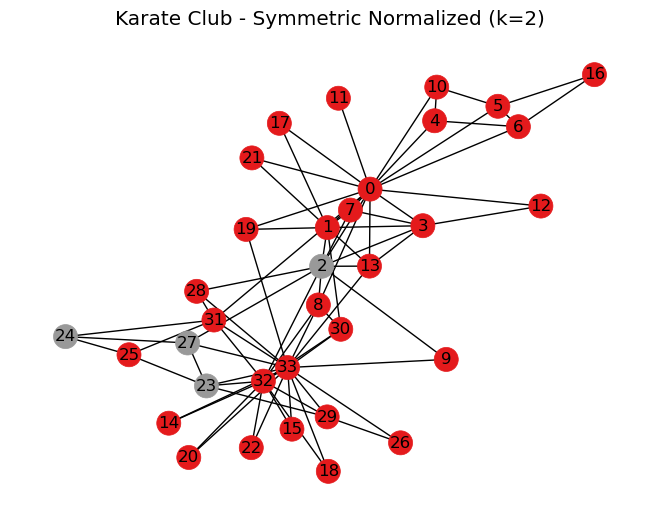

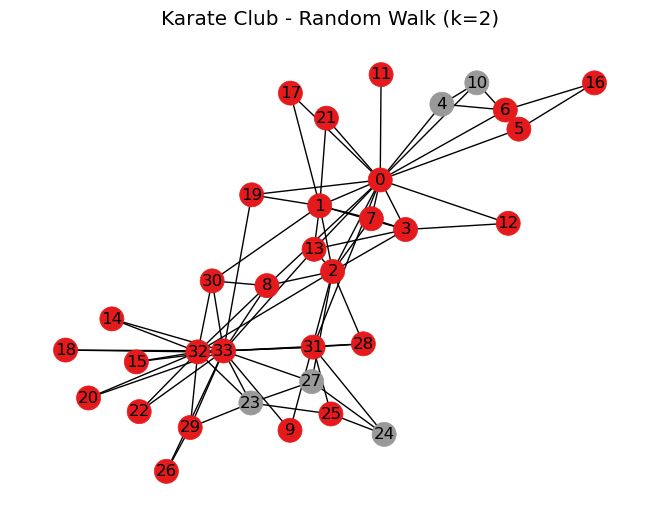

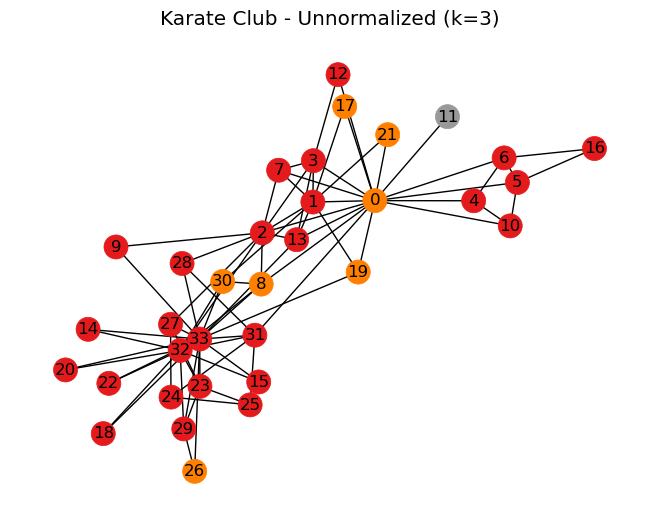

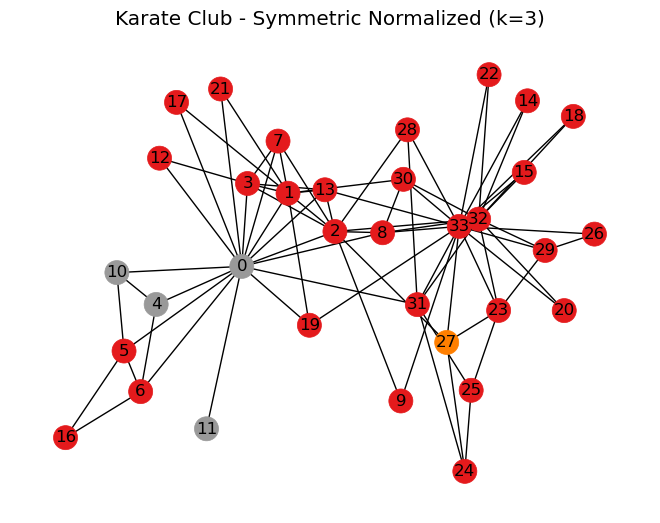

...

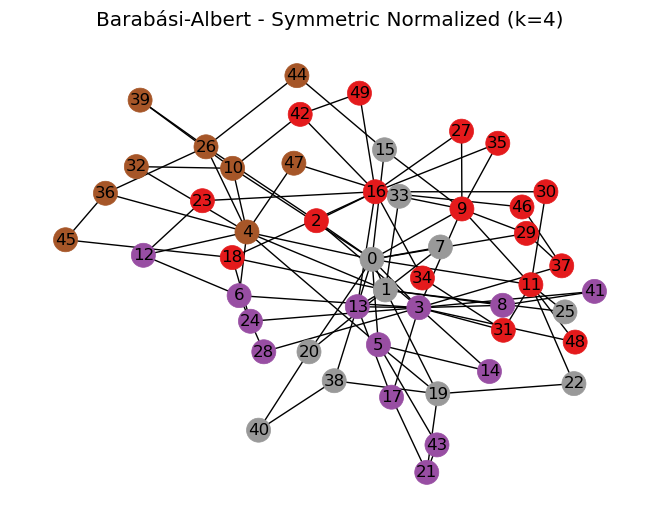

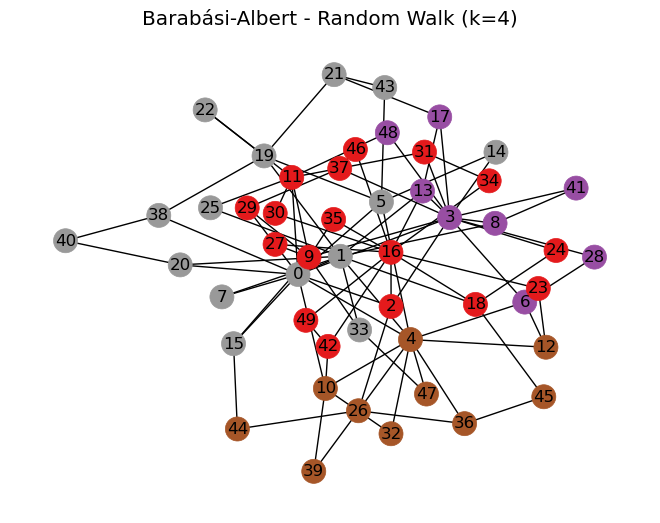

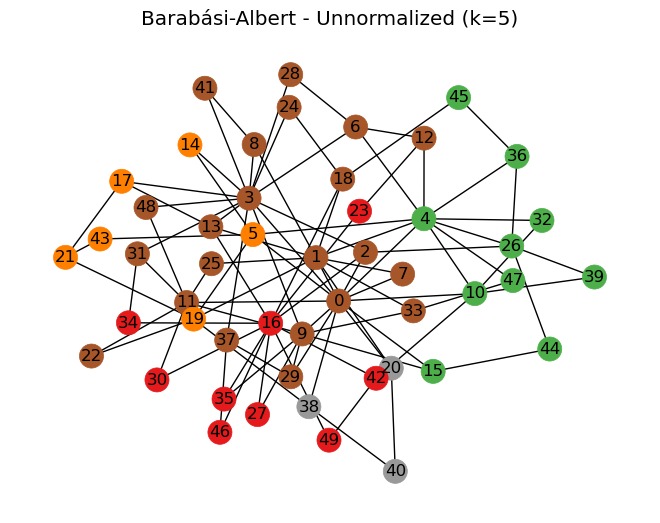

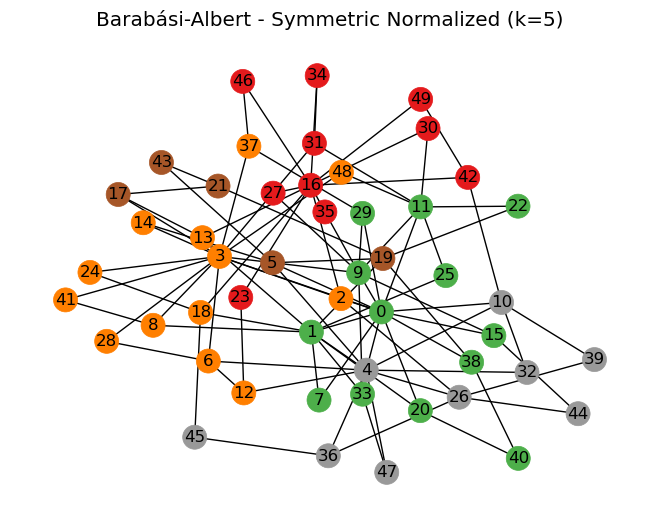

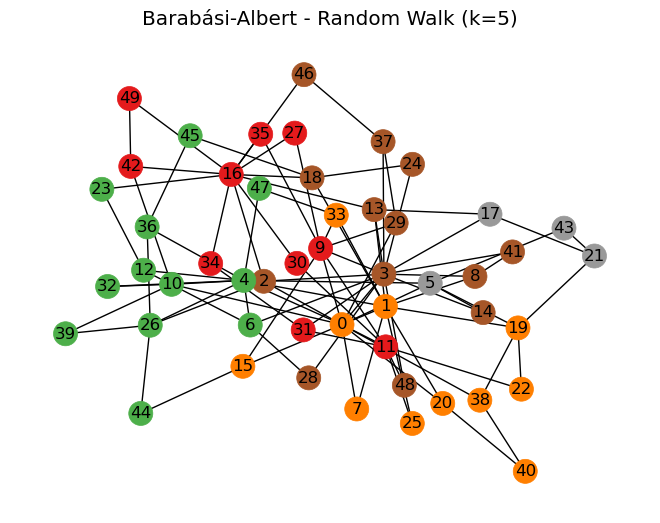

In [26]:
# Visualize clustering for a specific k and Laplacian type
# Function to visualize clustering for all rows in the given DataFrame
def visualize_all_clusters(dataframe, graphs_dict):
    for _, row in dataframe.iterrows():
        graph_name = row['Graph']
        k = row['k']
        laplacian = row['Laplacian']

        # Retrieve the graph from the dictionary
        if graph_name in graphs_dict:
            G = graphs_dict[graph_name]
        else:
            continue

        # Compute Laplacians and eigenvectors for the graph
        adjacency = nx.to_numpy_array(G)
        degrees = np.diag([d for _, d in G.degree()])
        L = degrees - adjacency  # Unnormalized Laplacian
        D_sqrt_inv = np.linalg.pinv(np.sqrt(degrees))
        L_sym = D_sqrt_inv @ L @ D_sqrt_inv  # Symmetric normalized Laplacian
        D_inv = np.linalg.pinv(degrees)
        L_rw = D_inv @ L  # Random walk Laplacian

        if laplacian == "Unnormalized":
            eigvecs = compute_eigenvectors(L, k)
        elif laplacian == "Symmetric Normalized":
            eigvecs = compute_eigenvectors(L_sym, k)
        elif laplacian == "Random Walk":
            eigvecs = compute_eigenvectors(L_rw, k)
        else:
            continue

        # Apply k-means clustering
        labels = apply_kmeans(eigvecs, k)

        # Visualize clustering
        title = f"{graph_name} - {laplacian} (k={k})"
        visualize_clustering(G, labels, title)

# Prepare a dictionary of graphs from the previous tests
graphs_to_visualize = {
    "Karate Club": nx.karate_club_graph(),
    "Erdős-Rényi": nx.erdos_renyi_graph(34, 0.1),
    "Erdős-Rényi_Dense_Graph": nx.erdos_renyi_graph(50, 0.8),
    "Erdős-Rényi_Sparse_Graph": nx.erdos_renyi_graph(50, 0.2),
    "Barabási-Albert": nx.barabasi_albert_graph(50, 2),
}

# Visualize all clusters for the provided DataFrame and graph dictionary
visualize_all_clusters(all_results_fixed_df, graphs_to_visualize)



##### Key Aspects of the Data

The table showcases the clustering performance across different types of graphs, Laplacian variants, and cluster numbers (\( k \)). The graphs include the **Karate Club**, a small social network; **Erdős-Rényi**, random graphs with varying densities; and **Barabási-Albert**, graphs generated using preferential attachment, which are scale-free. Erdős-Rényi graphs are further divided into **Dense Graphs** (high edge density) and **Sparse Graphs** (low edge density). The clustering performance is evaluated using the **Silhouette Score**, which measures the quality of clustering. Scores close to 1 indicate well-separated clusters, scores near 0 indicate overlapping clusters, and negative scores represent poor clustering.

##### General Observations

For the **Karate Club** graph, the **Symmetric Normalized Laplacian** performs the best for \( k = 2 \) with a Silhouette Score of 0.122548. However, for higher \( k \), the clustering quality declines, particularly for the Unnormalized Laplacian, with negative Silhouette Scores for \( k = 3, 4, \) and \( 5 \). The **Random Walk Laplacian** performs poorly overall for this graph. In **Erdős-Rényi graphs**, Dense Graphs generally have better Silhouette Scores than Sparse Graphs, reflecting the effect of higher connectivity. For Dense Graphs, the **Unnormalized Laplacian** performs better for \( k = 2 \) and \( k = 3 \). Sparse graphs, on the other hand, show consistently lower scores, although the Symmetric Normalized Laplacian occasionally performs slightly better for \( k = 5 \).

The **Barabási-Albert graphs** exhibit the best performance across all graph types, with relatively higher Silhouette Scores. For \( k = 2 \) and \( k = 3 \), all Laplacians yield positive scores, with the Unnormalized Laplacian slightly outperforming others. However, as \( k \) increases, the scores decrease slightly but remain mostly positive.

##### Insights

- **Normalized Laplacians**: The **Symmetric Normalized Laplacian** generally performs better for balanced and well-separated clusters, particularly for small \( k \) (e.g., \( k = 2 \)).
- **Random Walk Laplacian**: Tends to perform poorly for most graphs, likely due to its asymmetry.
- **Graph Type**: Dense graphs, such as Barabási-Albert and Dense Erdős-Rényi, are easier to cluster due to their higher connectivity. Sparse graphs, particularly Sparse Erdős-Rényi graphs, consistently show low or negative scores, reflecting poor clustering quality.
- **Impact of \( k \)**: Clustering quality tends to decrease as \( k \) increases, particularly for less structured graphs like Erdős-Rényi.

##### Conclusion

The **Symmetric Normalized Laplacian** is the most robust choice for spectral clustering, especially for \( k = 2 \) or \( k = 3 \). Graph characteristics like density and structure significantly affect clustering, with Barabási-Albert graphs performing the best overall. This analysis provides practical insights for selecting the appropriate Laplacian and \( k \) based on graph properties and clustering objectives.


### Interpretation of Clustering Results Across Laplacian Eigenmaps

The clustering results highlight how different Laplacian matrices affect the structure of clusters in the **Karate Club** network. The **Unnormalized Laplacian** resulted in highly imbalanced clusters using K-Means, while DBSCAN collapsed into a single large cluster, indicating difficulty in identifying meaningful communities. In contrast, the **Symmetric Normalized Laplacian** provided better-balanced clusters with K-Means, demonstrating that normalization helps distribute node influence more evenly. However, DBSCAN continued to fail due to the uniform density structure. Similarly, the **Random Walk Laplacian** exhibited clustering results nearly identical to the Symmetric Laplacian, further reinforcing that proper normalization aids in capturing the network's natural community structure.

##### **Observations**
- **Unnormalized Laplacian** resulted in **poorly separated clusters** for K-Means and **collapsed clusters** for DBSCAN.
- **Symmetric and Random Walk Laplacians** produced **more balanced clusters** with K-Means, confirming the **importance of normalization**.
- **DBSCAN consistently failed** across all Laplacians, suggesting it is **not well-suited** for this dataset due to the uniform density distribution.


/tmp/ipykernel_246506/3735437576.py:53: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.
  sns.scatterplot(x=eigenmaps[lap][:, 0], y=eigenmaps[lap][:, 1], hue=clusters, palette=colors, ax=axes[i, j])
/tmp/ipykernel_246506/3735437576.py:53: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.
  sns.scatterplot(x=eigenmaps[lap][:, 0], y=eigenmaps[lap][:, 1], hue=clusters, palette=colors, ax=axes[i, j])
/tmp/ipykernel_246506/3735437576.py:53: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.
  sns.scatterplot(x=eigenmaps[lap][:, 0], y=eigenmaps[lap][:, 1], hue=clusters, palette=colors, ax=axes[i, j])


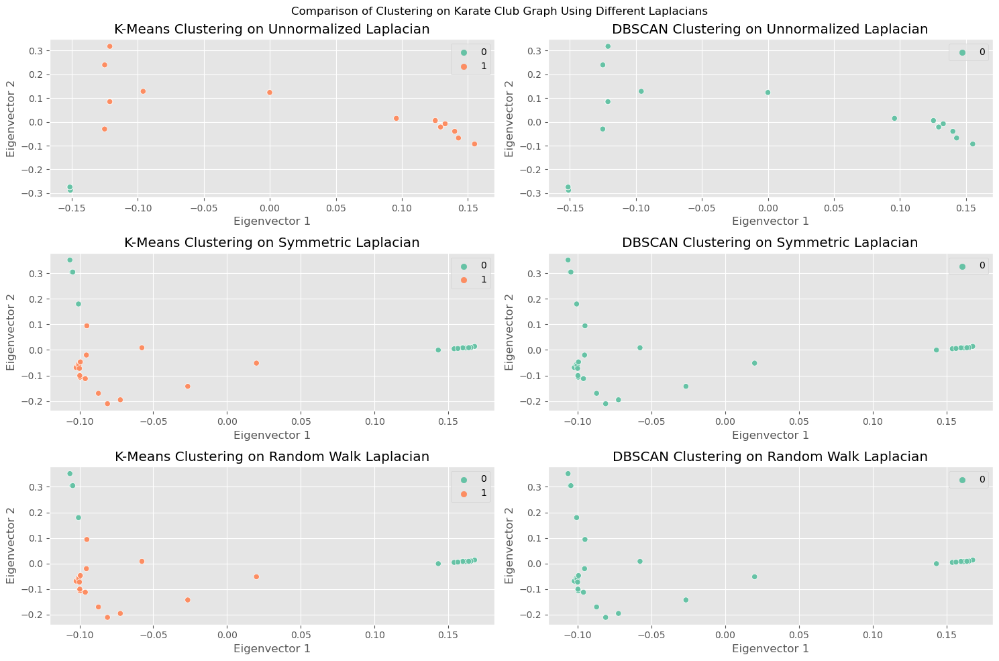

In [27]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.sparse import csgraph
from scipy.linalg import fractional_matrix_power
from sklearn.manifold import SpectralEmbedding
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from networkx.algorithms.community import modularity, louvain_communities
import community as community_louvain

# Step 1: Load a Graph That Works (Zachary's Karate Club)
G = nx.karate_club_graph()

# Step 2: Compute Laplacian Matrices
A = nx.to_numpy_array(G)
D = np.diag(np.sum(A, axis=1))  # Degree matrix

# **Fix: Prevent division by zero**
epsilon = 1e-10
D[D == 0] = epsilon  # Replace zero-degree nodes with small value

# Compute Laplacians
D_inv_sqrt = fractional_matrix_power(D, -0.5)  
L_unnormalized = csgraph.laplacian(A, normed=False)  
L_sym = np.real(np.eye(len(A)) - D_inv_sqrt @ A @ D_inv_sqrt)  
L_rw = np.real(csgraph.laplacian(A, normed=True))  

# Step 3: Compute Spectral Embeddings
num_clusters = 2  # Karate Club has two main groups
eigenmaps = {
    "Unnormalized Laplacian": SpectralEmbedding(n_components=num_clusters).fit_transform(L_unnormalized),
    "Symmetric Laplacian": SpectralEmbedding(n_components=num_clusters).fit_transform(L_sym),
    "Random Walk Laplacian": SpectralEmbedding(n_components=num_clusters).fit_transform(L_rw),
}

# Step 4: Apply Clustering Algorithms
def apply_clustering(X):
    kmeans = KMeans(n_clusters=num_clusters, random_state=42, n_init=10).fit_predict(X)
    dbscan = DBSCAN(eps=0.5, min_samples=2).fit_predict(X)
    return kmeans, dbscan

clustering_results = {lap: apply_clustering(X) for lap, X in eigenmaps.items()}

# Step 5: Visualize Clustering Results
fig, axes = plt.subplots(3, 2, figsize=(15, 10))
algorithms = ["K-Means", "DBSCAN"]
colors = sns.color_palette("Set2", num_clusters)

for i, (lap, (kmeans_clusters, dbscan_clusters)) in enumerate(clustering_results.items()):
    for j, (algo, clusters) in enumerate(zip(algorithms, [kmeans_clusters, dbscan_clusters])):
        sns.scatterplot(x=eigenmaps[lap][:, 0], y=eigenmaps[lap][:, 1], hue=clusters, palette=colors, ax=axes[i, j])
        axes[i, j].set_title(f"{algo} Clustering on {lap}")
        axes[i, j].set_xlabel("Eigenvector 1")
        axes[i, j].set_ylabel("Eigenvector 2")

plt.suptitle("Comparison of Clustering on Karate Club Graph Using Different Laplacians")
plt.tight_layout()
plt.show()


### Interpretation of Silhouette Scores for K-Means vs. Spectral Clustering

The **Silhouette Scores** provide insight into the effectiveness of each clustering method in capturing the underlying structure of the network.

##### Observations
- **K-Means consistently achieves higher Silhouette Scores than Spectral Clustering** across different cluster numbers.
- The **highest Silhouette Score for K-Means is 0.62** at **k=2**, suggesting that **a two-cluster solution provides the most distinct separation**.
- Spectral Clustering achieves its highest Silhouette Score of **0.54 at k=2**, but its performance declines faster compared to K-Means.
- **As k increases**, both methods see a drop in performance, indicating that the network structure **does not naturally support a higher number of clusters**.

##### Takeaways
- **K-Means performs better overall** on this dataset, suggesting that **the graph does not have strong community-like structures**.
- **Spectral Clustering struggles at higher k-values**, likely due to weaker eigenvalue gaps or the presence of **overlapping node groups**.
- If the goal is to **capture well-separated clusters**, **K-Means appears to be the better choice**.


/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprec

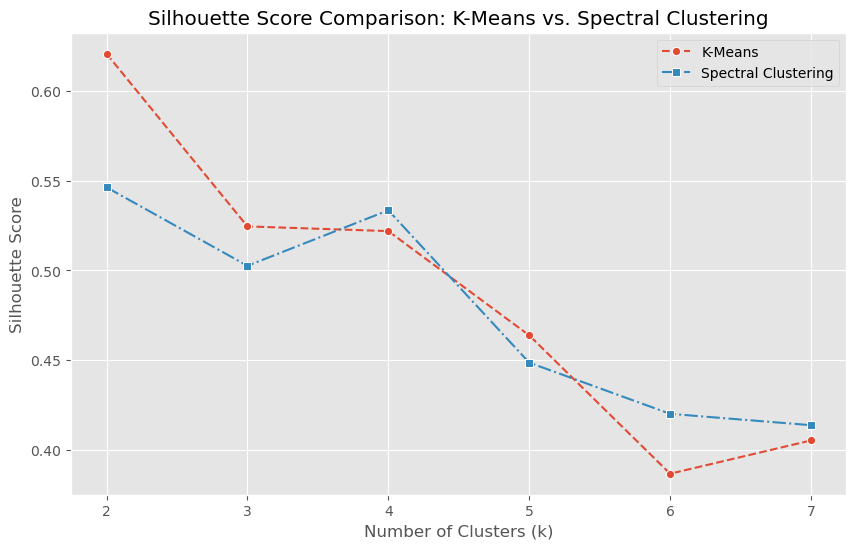

In [28]:
from sklearn.cluster import KMeans, SpectralClustering


# Step 3: Compute Spectral Embedding (Eigenmaps)
num_clusters_range = range(2, 8)  # Test clusters from 2 to 7
silhouette_kmeans = []
silhouette_spectral = []

for k in num_clusters_range:
    # Compute embeddings
    embedding = SpectralEmbedding(n_components=k, affinity="precomputed")
    X_spectral = embedding.fit_transform(A)

    # Apply K-Means
    kmeans_labels = KMeans(n_clusters=k, random_state=42, n_init=10).fit_predict(X_spectral)
    spectral_labels = SpectralClustering(n_clusters=k, affinity="precomputed", random_state=42).fit_predict(A)

    # Compute Silhouette Scores
    silhouette_kmeans.append(silhouette_score(X_spectral, kmeans_labels))
    silhouette_spectral.append(silhouette_score(X_spectral, spectral_labels))

# Step 4: Visualize Silhouette Scores
plt.figure(figsize=(10, 6))
sns.lineplot(x=list(num_clusters_range), y=silhouette_kmeans, marker="o", label="K-Means", linestyle="--")
sns.lineplot(x=list(num_clusters_range), y=silhouette_spectral, marker="s", label="Spectral Clustering", linestyle="-.")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score Comparison: K-Means vs. Spectral Clustering")
plt.legend()
plt.grid(True)
plt.show()

In [29]:
silhouette_spectral

[0.5463626568193081,
 0.502615001721884,
 0.5335471333376977,
 0.44864700695455767,
 0.4201196435643369,
 0.4137926121316391]

In [30]:
silhouette_kmeans

[0.6208092874276376,
 0.5245741263067034,
 0.5219531233994238,
 0.46385060871270256,
 0.38674303270230603,
 0.4052988568430842]

### Community Detection Louvain on Facebook Ego Network

In [31]:
# !pip install leidenalg python-igraph

In [32]:
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import leidenalg
import igraph as ig
from community import community_louvain
from pyvis.network import Network

# Step 1: Load the Facebook Ego Network
def load_facebook_graph():
    url = "https://snap.stanford.edu/data/facebook_combined.txt.gz"
    df = pd.read_csv(url, sep=" ", names=["source", "target"], compression="gzip")
    G = nx.Graph()
    G.add_edges_from(df.values)
    return G

G = load_facebook_graph()
print(f"Loaded Facebook Ego Network with {G.number_of_nodes()} nodes and {G.number_of_edges()} edges.")


Loaded Facebook Ego Network with 4039 nodes and 88234 edges.


In [33]:
# Step 2: Preprocess the Graph
G.remove_nodes_from(list(nx.isolates(G)))  # Remove isolated nodes
largest_cc = max(nx.connected_components(G), key=len)
G = G.subgraph(largest_cc).copy()  # Keep largest connected component
print(f"After preprocessing: {G.number_of_nodes()} nodes and {G.number_of_edges()} edges.")

After preprocessing: 4039 nodes and 88234 edges.


In [34]:
# Step 3: Apply Community Detection Algorithms

# Louvain Community Detection
louvain_partition = community_louvain.best_partition(G)
louvain_clusters = np.array([louvain_partition[node] for node in G.nodes()])
print(f"Detected {len(set(louvain_clusters))} Louvain communities.")


Detected 15 Louvain communities.


In [35]:
# Leiden Community Detection
ig_G = ig.Graph.TupleList(G.edges(), directed=False)
leiden_partition = leidenalg.find_partition(ig_G, leidenalg.ModularityVertexPartition)
leiden_clusters = np.array([leiden_partition.membership[i] for i in range(len(G.nodes()))])
print(f"Detected {len(set(leiden_clusters))} Leiden communities.")

Detected 17 Leiden communities.


In [36]:
# Step 4: Interactive Visualization Using Pyvis
from pyvis.network import Network
import networkx as nx
import numpy as np

def visualize_pyvis(G, clusters, title):
    # Convert node IDs to strings (if not already)
    G = nx.relabel_nodes(G, lambda x: str(x))

    # Create Pyvis Network
    net = Network(height="700px", width="100%", notebook=True, cdn_resources="remote")
    net.from_nx(G)

    # Assign colors to clusters
    unique_clusters = np.unique(clusters)
    color_map = plt.cm.get_cmap("tab10", len(unique_clusters))  # Generate distinct colors

    for node, cluster in zip(G.nodes(), clusters):
        color = f"#{int(color_map(cluster)[0]*255):02x}{int(color_map(cluster)[1]*255):02x}{int(color_map(cluster)[2]*255):02x}"
        net.get_node(str(node))["color"] = color

    # Display the interactive graph
    net.show(f"{title}.html")



In [37]:
# Generate interactive visualizations
visualize_pyvis(G, louvain_clusters, "Louvain Clustering")

Louvain Clustering.html


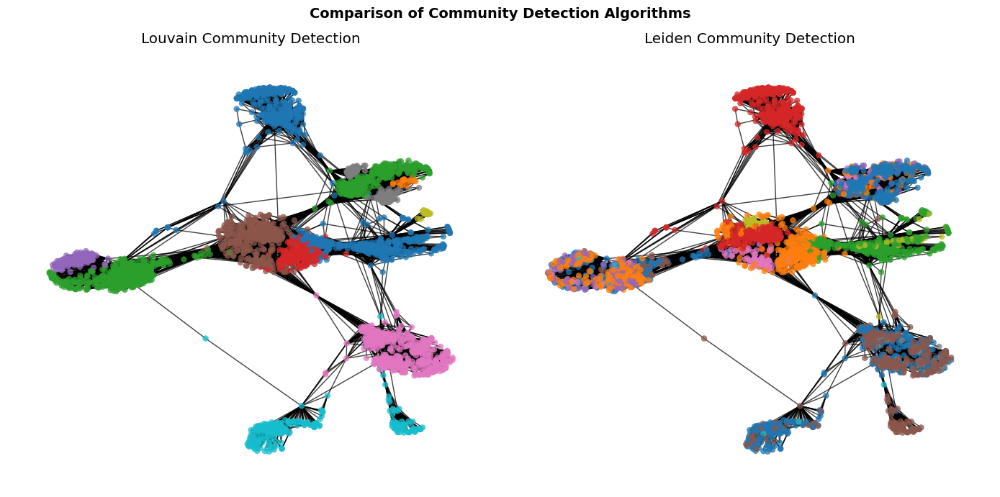

In [38]:
# Step 5: Static Visualization Using Matplotlib
fig, ax = plt.subplots(1, 2, figsize=(14, 7))

# Scatter plot of Louvain communities
pos = nx.spring_layout(G, seed=42)
nx.draw(G, pos, node_color=louvain_clusters, cmap="tab10", node_size=30, alpha=0.75, ax=ax[0])
ax[0].set_title("Louvain Community Detection")

# Scatter plot of Leiden communities
nx.draw(G, pos, node_color=leiden_clusters, cmap="tab10", node_size=30, alpha=0.75, ax=ax[1])
ax[1].set_title("Leiden Community Detection")

plt.suptitle("Comparison of Community Detection Algorithms", fontsize=14, fontweight="bold")
plt.tight_layout()
plt.show()

# Exercise 3: Formalization for Approximating the RatioCut for an Arbitrary $k$

To approximate the **RatioCut** for an arbitrary $k$ (where $k$ is the number of clusters), the goal is to partition a graph $G = (V, E)$ into $k$ disjoint subsets ${C_1, C_2, \dots, C_k}$ such that the **RatioCut** metric is minimized. 

##### **Definition of RatioCut**

The **RatioCut** for a $k$-way partition is defined as:
$$
\text{RatioCut}(\{C_1, C_2, \dots, C_k\}) = \sum_{i=1}^k \frac{\text{cut}(C_i, \bar{C}_i)}{|C_i|}
$$


where:
- $\text{cut}(C_i, \bar{C}_i)$ is the sum of the edge weights between $C_i$ and its complement $\bar{C}_i$,
  $$
  \text{cut}(C_i, \bar{C}_i) = \sum_{u \in C_i, v \in \bar{C}_i} w(u, v)
  $$
- $|C_i|$ is the size (cardinality) of the subset $C_i$.

##### **Formalization of Approximation Using the Normalized Laplacian**

To approximate the RatioCut for $k$, we can leverage spectral methods based on the graph Laplacian. The steps are as follows:

##### **1. Construct the Laplacian:**
Compute the **normalized Laplacian matrix** $L_{\text{sym}} = D^{-\frac{1}{2}} L D^{-\frac{1}{2}}$, where:
- $L = D - A$ is the unnormalized Laplacian
- $D$ is the diagonal degree matrix
- $A$ is the adjacency matrix

##### **2. Compute the Eigenvectors:**
Find the $k$-smallest eigenvectors $\{v_1, v_2, \dots, v_k\}$ of $L_{\text{sym}}$, corresponding to the $k$-smallest eigenvalues.

##### **3. Form the Embedding:**
Stack the $k$ eigenvectors to form a matrix $U \in \mathbb{R}^{n \times k}$, where each row represents a node embedded in a $k$-dimensional space.

##### **4. Apply Clustering:**
Use a standard clustering algorithm, like $k$-means, to partition the rows of $U$ into $k$ clusters.

##### **Justification of Approximation**

- **Spectral Relaxation**:  
  The spectral clustering approach relaxes the discrete partitioning problem into a continuous embedding problem, allowing an efficient solution using eigenvector computations.
  
- The eigenvectors corresponding to the smallest eigenvalues of the normalized Laplacian are directly linked to minimizing the RatioCut objective while maintaining balanced partitions.

This spectral clustering approach provides an effective approximation for the RatioCut objective for arbitrary $k$.


In [39]:
# import networkx as nx
# import numpy as np
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt
# # from scipy import integrate

# # Create a sample graph
# G = nx.karate_club_graph()

# # Compute the normalized Laplacian matrix
# L = nx.normalized_laplacian_matrix(G).toarray()

# # Compute the eigenvalues and eigenvectors
# eigenvalues, eigenvectors = np.linalg.eigh(L)

# # Select the first k eigenvectors for k=3
# k = 3
# spectral_embedding = eigenvectors[:, :k]

# # Apply k-means clustering on the spectral embedding
# kmeans = KMeans(n_clusters=k, random_state=0).fit(spectral_embedding)
# labels = kmeans.labels_

# # Visualize the clusters on the graph
# pos = nx.spring_layout(G)
# plt.figure(figsize=(10, 8))
# nx.draw(
#     G, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1,
#     node_size=300, edge_color="gray"
# )
# plt.title("Spectral Clustering on Karate Club Graph")
# plt.show()

# # Plot eigenvalue spectrum
# plt.figure(figsize=(8, 6))
# plt.plot(range(len(eigenvalues)), sorted(eigenvalues), marker='o')
# plt.title("Eigenvalue Spectrum of Laplacian")
# plt.xlabel("Index")
# plt.ylabel("Eigenvalue")
# plt.grid()
# plt.show()


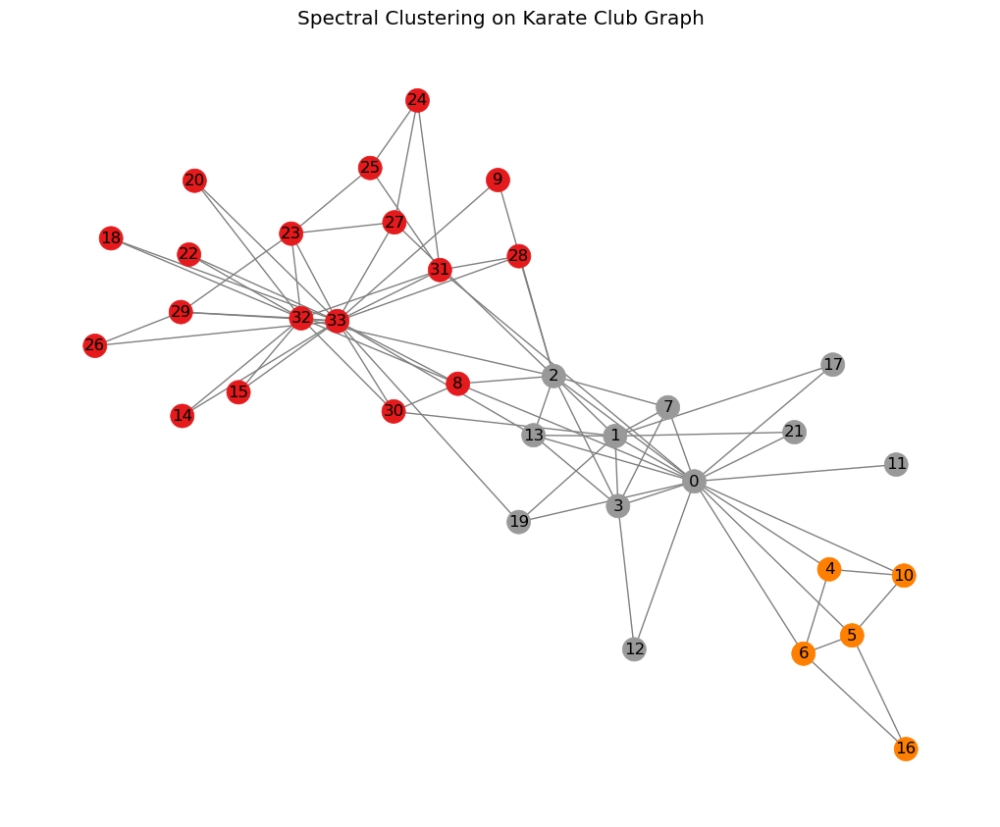

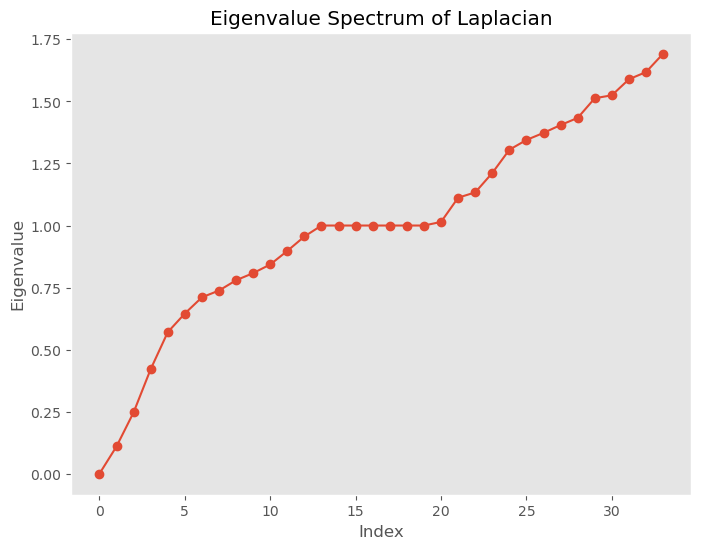

In [40]:
import networkx as nx
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Create a sample graph
G = nx.karate_club_graph()

# Compute the normalized Laplacian matrix using NumPy's errstate
with np.errstate(divide="ignore"):
    L = nx.normalized_laplacian_matrix(G).toarray()  # No scipy.errstate issue now

# Compute the eigenvalues and eigenvectors
eigenvalues, eigenvectors = np.linalg.eigh(L)

# Select the first k eigenvectors for k=3
k = 3
spectral_embedding = eigenvectors[:, :k]

# Apply k-means clustering on the spectral embedding
kmeans = KMeans(n_clusters=k, random_state=0).fit(spectral_embedding)
labels = kmeans.labels_

# Visualize the clusters on the graph
pos = nx.spring_layout(G)
plt.figure(figsize=(10, 8))
nx.draw(
    G, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1,
    node_size=300, edge_color="gray"
)
plt.title("Spectral Clustering on Karate Club Graph")
plt.show()

# Plot eigenvalue spectrum
plt.figure(figsize=(8, 6))
plt.plot(range(len(eigenvalues)), sorted(eigenvalues), marker='o')
plt.title("Eigenvalue Spectrum of Laplacian")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.grid()
plt.show()


##### **2. Eigenvalue Spectrum of the Laplacian**

The second plot shows the eigenvalue spectrum of the normalized Laplacian. The **Index** on the x-axis represents the position of the eigenvalues in ascending order, while the **Eigenvalue** on the y-axis shows the magnitude of each eigenvalue.

##### **Observations:**
- **Smallest Eigenvalue**:  
  The first eigenvalue (index 0) is exactly \( 0 \), which is expected for the normalized Laplacian. It corresponds to the trivial constant eigenvector.

- **Second and Subsequent Eigenvalues**:  
  The second smallest eigenvalue (Fiedler value) is small, suggesting that the graph has good separability into clusters.

- **Gap Analysis**:  
  There is no large gap after the third eigenvalue, which suggests that 3 clusters might be a natural choice for this graph. However, the gap analysis also indicates that additional clusters beyond \( k = 3 \) may not yield meaningful separations.


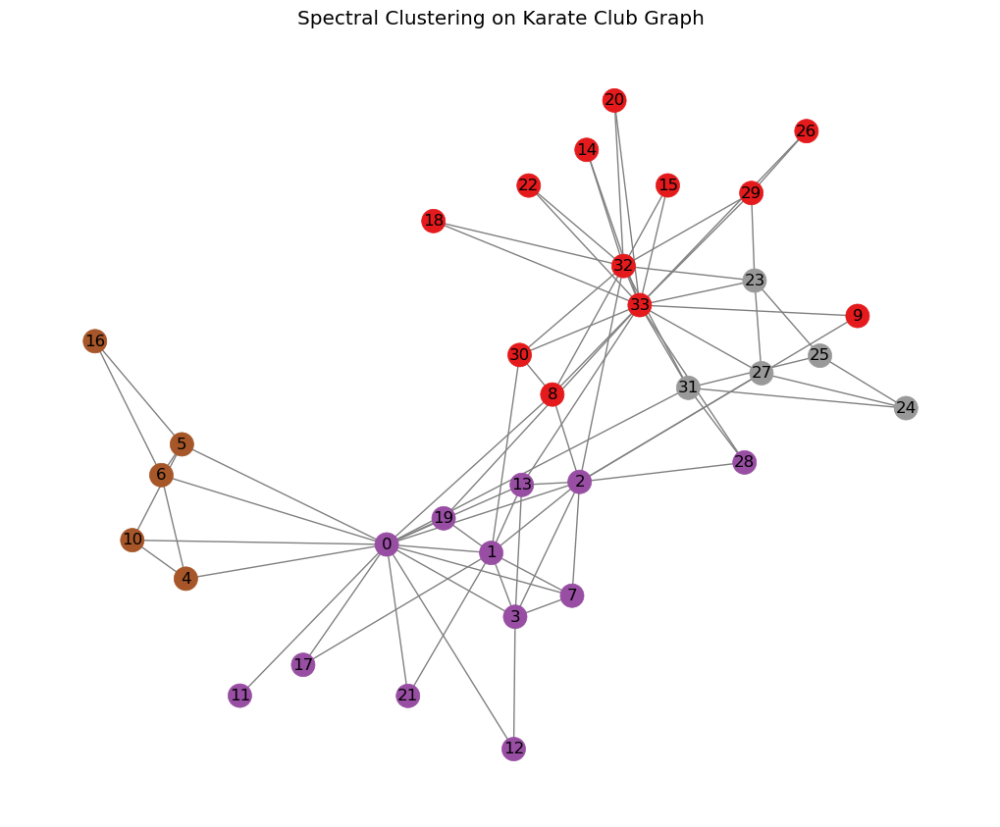

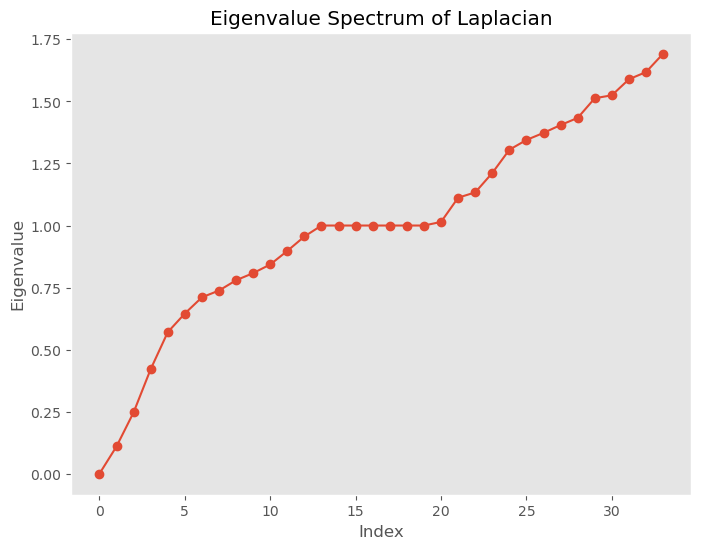

In [41]:
# Select the first k eigenvectors for k=4
k = 4
spectral_embedding = eigenvectors[:, :k]

# Apply k-means clustering on the spectral embedding
kmeans = KMeans(n_clusters=k, random_state=0).fit(spectral_embedding)
labels = kmeans.labels_

# Visualize the clusters on the graph
pos = nx.spring_layout(G)
plt.figure(figsize=(10, 8))
nx.draw(
    G, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1,
    node_size=300, edge_color="gray"
)
plt.title("Spectral Clustering on Karate Club Graph")
plt.show()

# Plot eigenvalue spectrum
plt.figure(figsize=(8, 6))
plt.plot(range(len(eigenvalues)), sorted(eigenvalues), marker='o')
plt.title("Eigenvalue Spectrum of Laplacian")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.grid()
plt.show()


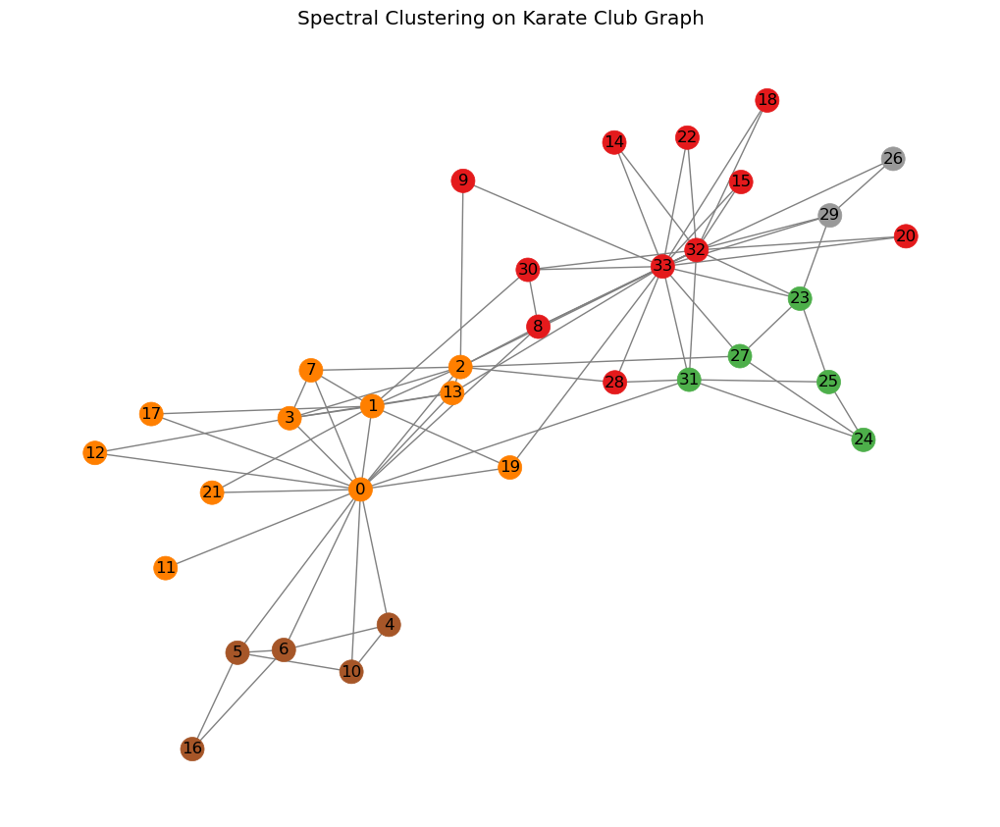

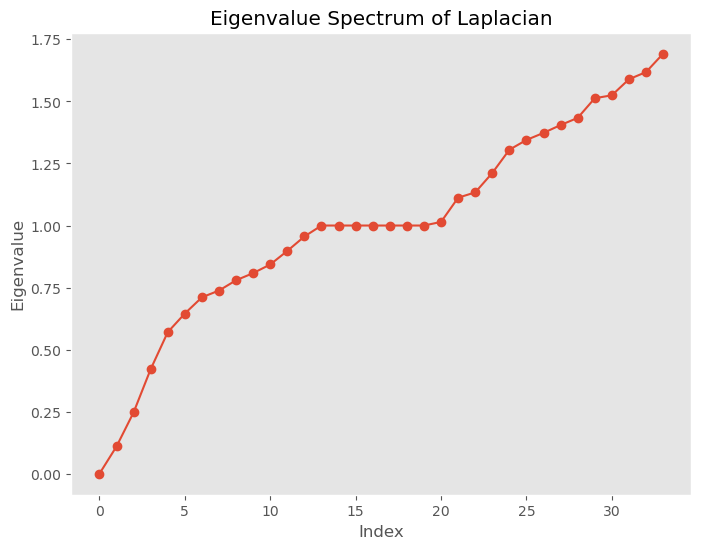

In [42]:
# Select the first k eigenvectors for k=5
k = 5
spectral_embedding = eigenvectors[:, :k]

# Apply k-means clustering on the spectral embedding
kmeans = KMeans(n_clusters=k, random_state=0).fit(spectral_embedding)
labels = kmeans.labels_

# Visualize the clusters on the graph
pos = nx.spring_layout(G)
plt.figure(figsize=(10, 8))
nx.draw(
    G, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1,
    node_size=300, edge_color="gray"
)
plt.title("Spectral Clustering on Karate Club Graph")
plt.show()

# Plot eigenvalue spectrum
plt.figure(figsize=(8, 6))
plt.plot(range(len(eigenvalues)), sorted(eigenvalues), marker='o')
plt.title("Eigenvalue Spectrum of Laplacian")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.grid()
plt.show()


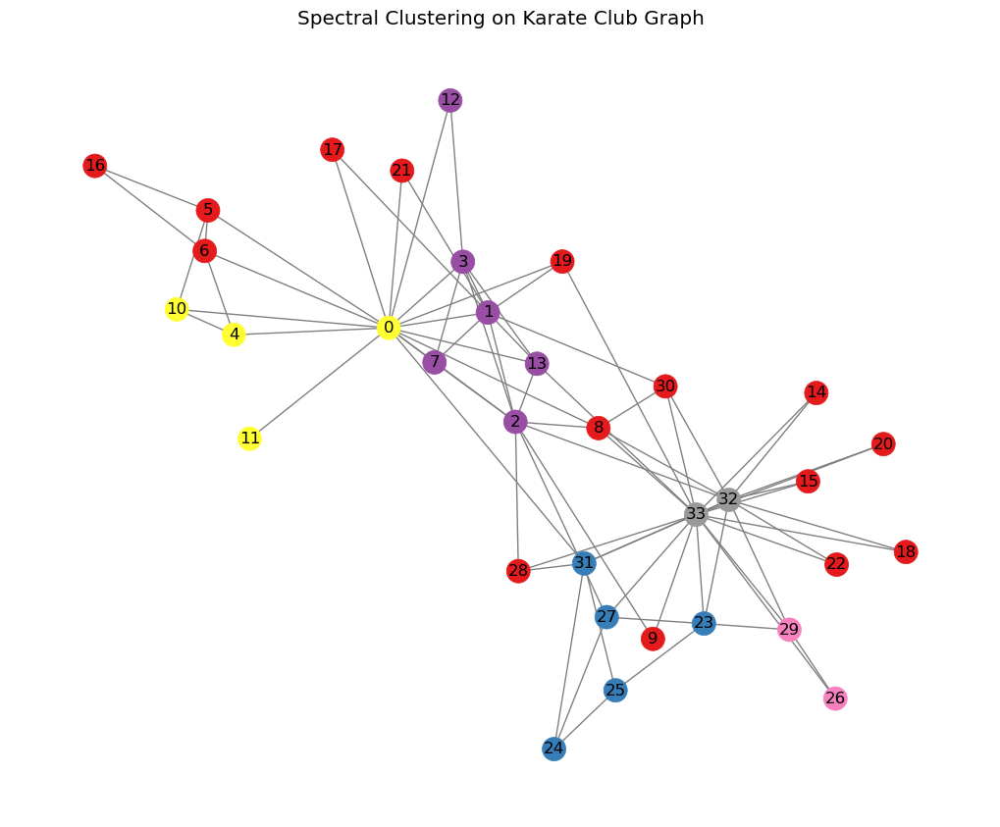

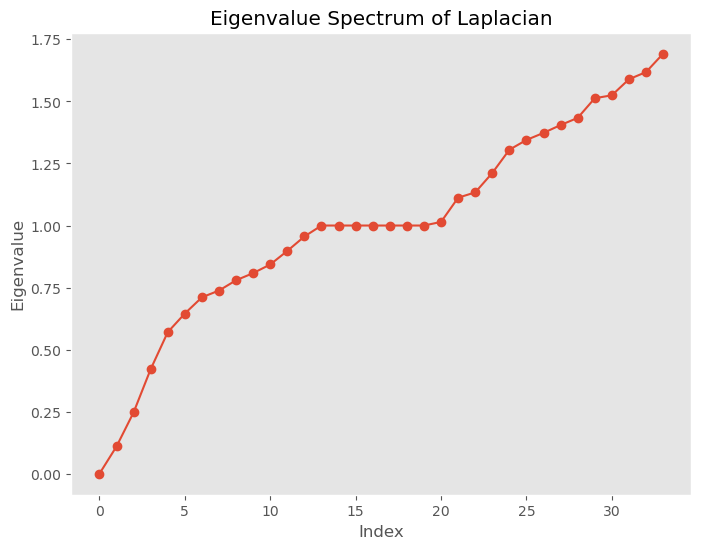

In [43]:
# Select the first k eigenvectors for k=3
k = 6
spectral_embedding = eigenvectors[:, :k]

# Apply k-means clustering on the spectral embedding
kmeans = KMeans(n_clusters=k, random_state=0).fit(spectral_embedding)
labels = kmeans.labels_

# Visualize the clusters on the graph
pos = nx.spring_layout(G)
plt.figure(figsize=(10, 8))
nx.draw(
    G, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1,
    node_size=300, edge_color="gray"
)
plt.title("Spectral Clustering on Karate Club Graph")
plt.show()

# Plot eigenvalue spectrum
plt.figure(figsize=(8, 6))
plt.plot(range(len(eigenvalues)), sorted(eigenvalues), marker='o')
plt.title("Eigenvalue Spectrum of Laplacian")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.grid()
plt.show()


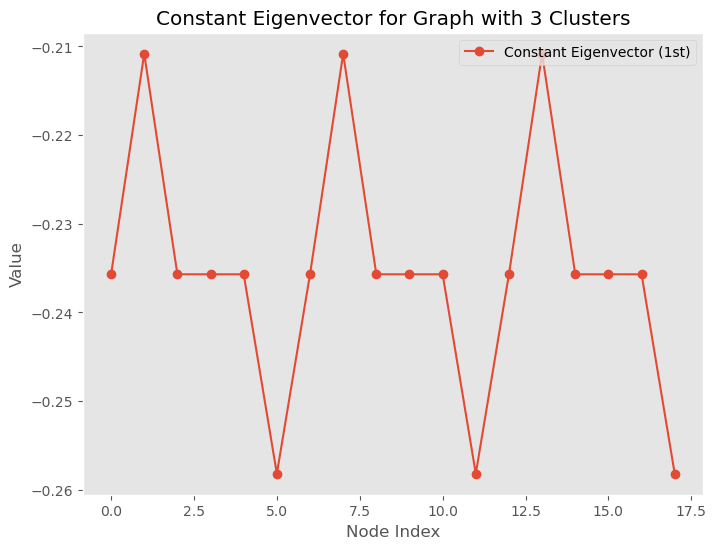

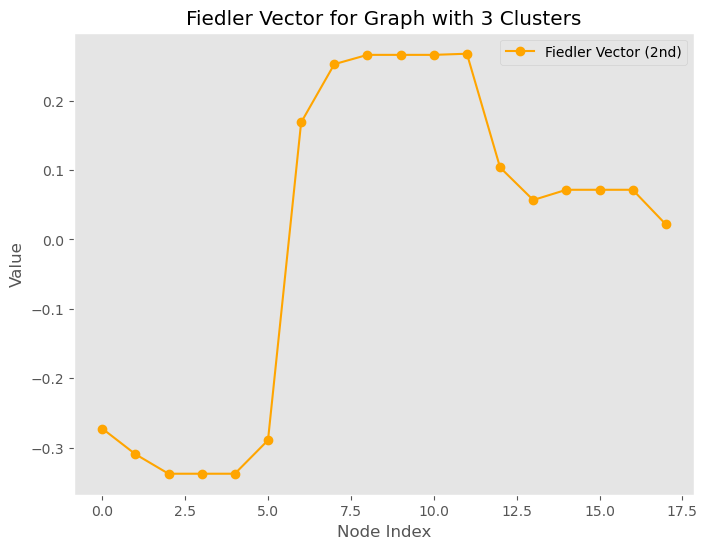

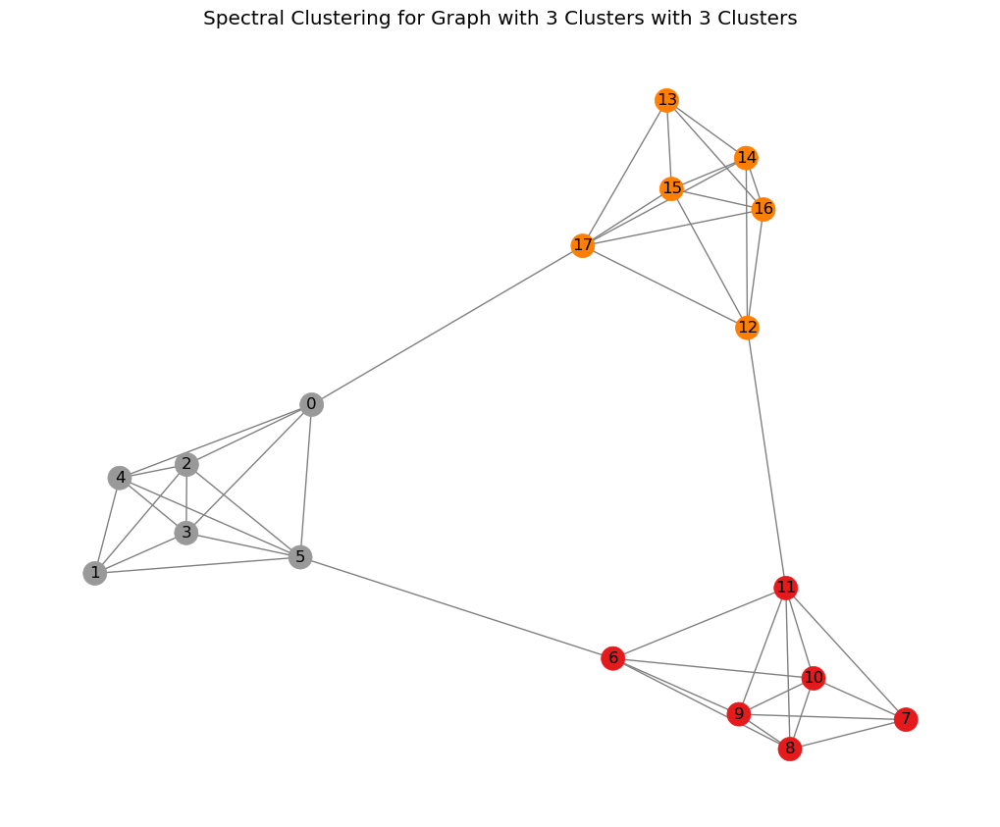

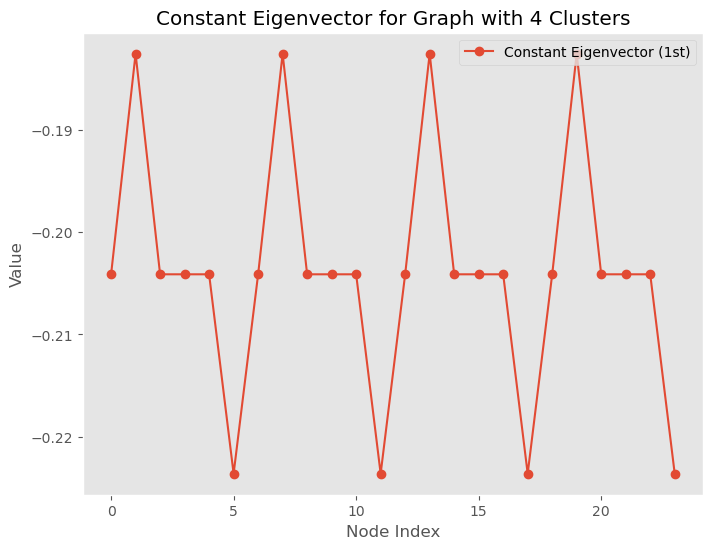

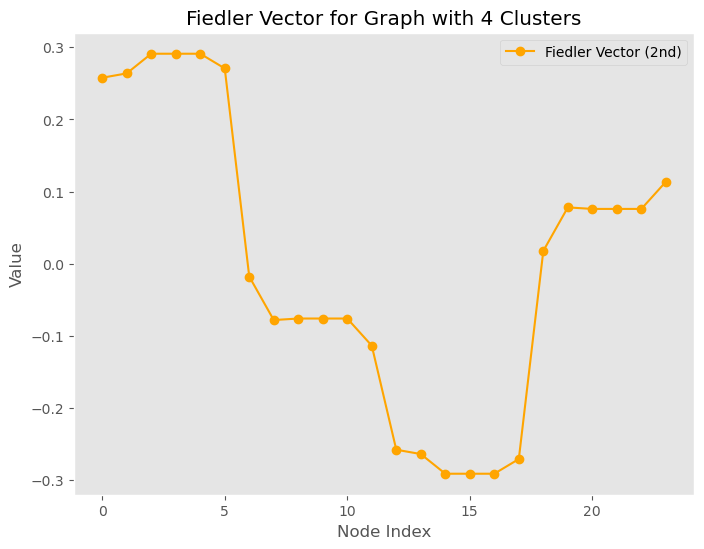

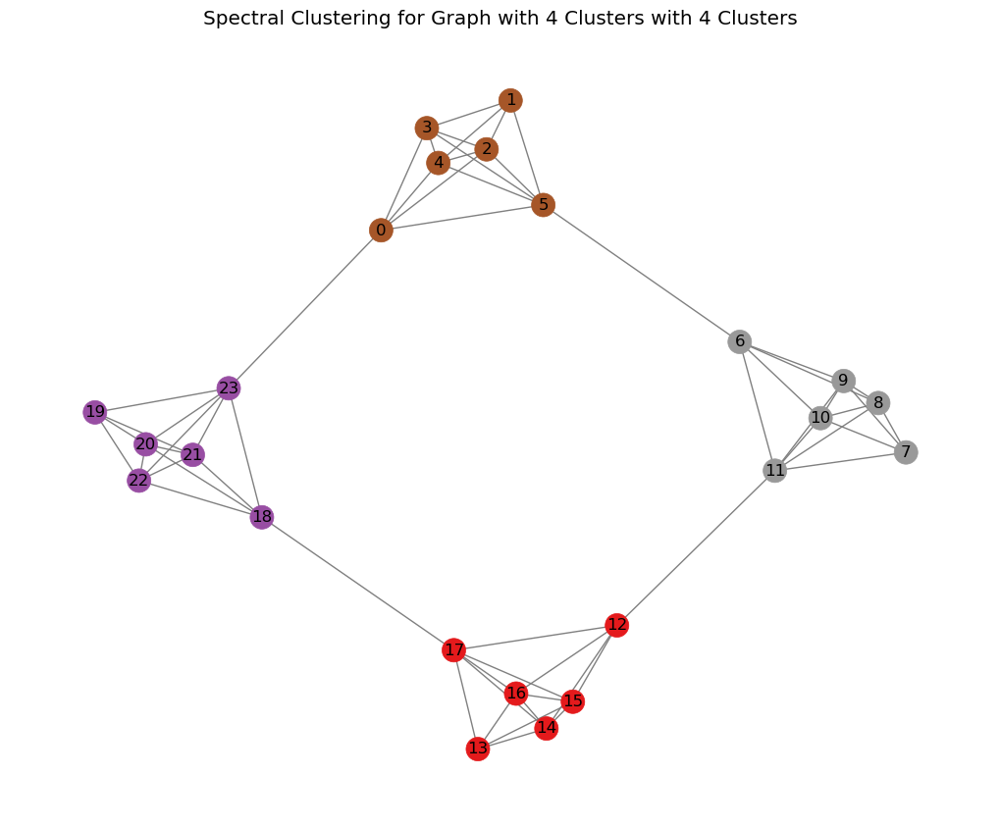

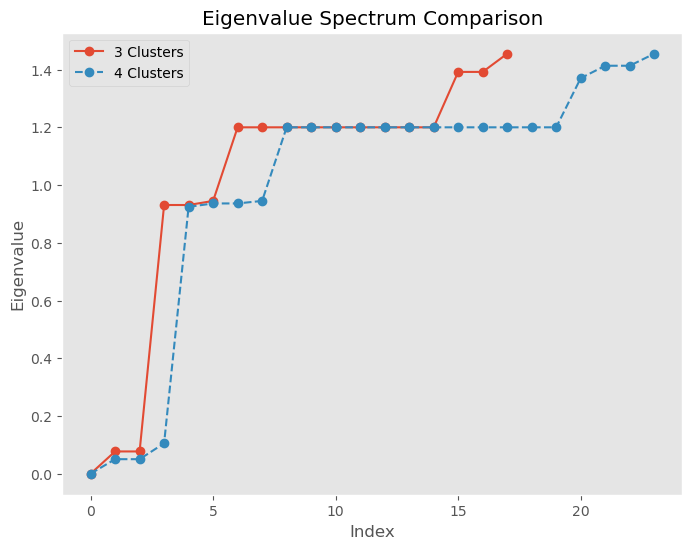

In [44]:
import networkx as nx
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Step 1: Create a graph with known clusters
# Use nx.connected_caveman_graph as an example for 3 and 4 clusters
G_3_clusters = nx.connected_caveman_graph(3, 6)  # 3 clusters with 6 nodes each
G_4_clusters = nx.connected_caveman_graph(4, 6)  # 4 clusters with 6 nodes each

# Function to perform spectral clustering
def spectral_clustering_and_plot(graph, k, title):
    # Step 2: Preprocessing - Compute normalized Laplacian
    L = nx.normalized_laplacian_matrix(graph).toarray()
    
    # Step 3: Decomposition - Compute eigenvalues and eigenvectors
    eigenvalues, eigenvectors = np.linalg.eigh(L)
    
    # Plot constant eigenvector (first eigenvector)
    plt.figure(figsize=(8, 6))
    plt.plot(eigenvectors[:, 0], marker='o', label='Constant Eigenvector (1st)')
    plt.title(f"Constant Eigenvector for {title}")
    plt.xlabel("Node Index")
    plt.ylabel("Value")
    plt.legend()
    plt.grid()
    plt.show()
    
    # Plot Fiedler vector (second smallest eigenvector)
    plt.figure(figsize=(8, 6))
    plt.plot(eigenvectors[:, 1], marker='o', color='orange', label='Fiedler Vector (2nd)')
    plt.title(f"Fiedler Vector for {title}")
    plt.xlabel("Node Index")
    plt.ylabel("Value")
    plt.legend()
    plt.grid()
    plt.show()
    
    # Step 4: Grouping - Use k smallest eigenvectors for clustering
    spectral_embedding = eigenvectors[:, :k]
    kmeans = KMeans(n_clusters=k, random_state=0).fit(spectral_embedding)
    labels = kmeans.labels_
    
    # Visualize the graph with clusters
    pos = nx.spring_layout(graph)
    plt.figure(figsize=(10, 8))
    nx.draw(
        graph, pos, node_color=labels, with_labels=True, cmap=plt.cm.Set1,
        node_size=300, edge_color="gray"
    )
    plt.title(f"Spectral Clustering for {title} with {k} Clusters")
    plt.show()
    
    # Return eigenvalues for analysis
    return eigenvalues

# Perform spectral clustering for graphs with 3 and 4 clusters
eigenvalues_3 = spectral_clustering_and_plot(G_3_clusters, k=3, title="Graph with 3 Clusters")
eigenvalues_4 = spectral_clustering_and_plot(G_4_clusters, k=4, title="Graph with 4 Clusters")

# Plot eigenvalue spectrum for analysis
plt.figure(figsize=(8, 6))
plt.plot(range(len(eigenvalues_3)), eigenvalues_3, marker='o', label='3 Clusters')
plt.plot(range(len(eigenvalues_4)), eigenvalues_4, marker='o', label='4 Clusters', linestyle='--')
plt.title("Eigenvalue Spectrum Comparison")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.legend()
plt.grid()
plt.show()


In [45]:
# 1. Import Necessary Libraries

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from networkx import karate_club_graph, adjacency_matrix
import networkx as nx
# from node2vec import Node2Vec
from sklearn.manifold import SpectralEmbedding
import numpy as np
import matplotlib.pyplot as plt
from torch_geometric.nn import Node2Vec


/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/torch_geometric/typing.py:68: UserWarning: An issue occurred while importing 'pyg-lib'. Disabling its usage. Stacktrace: /home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/libpyg.so: undefined symbol: _ZN2at4_ops10zeros_like4callERKNS_6TensorEN3c108optionalINS5_10ScalarTypeEEENS6_INS5_6LayoutEEENS6_INS5_6DeviceEEENS6_IbEENS6_INS5_12MemoryFormatEEE
  warnings.warn(f"An issue occurred while importing 'pyg-lib'. "
/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/torch_geometric/typing.py:86: UserWarning: An issue occurred while importing 'torch-scatter'. Disabling its usage. Stacktrace: /home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/torch_scatter/_version_cuda.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev
  warnings.warn(f"An issue occurred while importing 'torch-scatter'. "


In [46]:
# pip install node2vec
# !pip install torch-cluster


In [47]:
# pip install --upgrade setuptools wheel
# !pip install fst-pso
# !pip install --upgrade pip setuptools wheel
# !pip install git+https://github.com/lsmcolab/fst-pso.git


In [48]:
# 2. Define Helper Functions

# Function to perform clustering and evaluate results
def perform_clustering(graph, embeddings, method_name):
    # Perform K-Means clustering
    kmeans = KMeans(n_clusters=2, random_state=42, n_init=10).fit(embeddings)
    labels = kmeans.labels_

    # Compute silhouette score
    silhouette = silhouette_score(embeddings, labels)

    # Compute modularity
    communities = {i: [] for i in range(2)}
    for node, label in enumerate(labels):
        communities[label].append(node)

    modularity = nx.algorithms.community.quality.modularity(graph, list(communities.values()))

    print(f"Results for {method_name}:")
    print(f"Silhouette Score: {silhouette:.4f}")
    print(f"Modularity: {modularity:.4f}\n")

    return labels, silhouette, modularity


### Experiment 1: Zachary's Karate Club

- **Description**: A small and well-studied graph where clusters represent the split of a karate club into two groups.


##### 3.1 Generate Embeddings

In [49]:
# Generate embeddings for Node2Vec and Spectral for Zachary's Karate Club
karate_graph = karate_club_graph()


In [50]:
# import torch
# import torch_geometric.nn.models.node2vec  # Explicit import
# import networkx as nx
# from torch_geometric.utils import from_networkx

# # Create the Karate Club graph
# karate_graph = nx.karate_club_graph()

# # Convert to PyTorch Geometric format
# data = from_networkx(karate_graph)

# # Debugging: Print graph properties
# print("Number of nodes:", data.num_nodes)
# print("Edge index shape:", data.edge_index.shape)

# # Define Node2Vec model
# sparse = True  # Manually set whether sparse optimization is used
# node2vec_model = torch_geometric.nn.models.node2vec.Node2Vec(  
#     data.edge_index,
#     embedding_dim=16,  # Corrected parameter
#     walk_length=10,
#     context_size=5,
#     walks_per_node=100,
#     num_negative_samples=1,
#     p=1.0,
#     q=1.0,
#     sparse=sparse,  # Control sparse optimization
# )

# # Move model to GPU if available
# device = "cuda" if torch.cuda.is_available() else "cpu"
# node2vec_model = node2vec_model.to(device)

# # ✅ Use SparseAdam only if sparse=True
# if sparse:
#     optimizer = torch.optim.SparseAdam(node2vec_model.parameters(), lr=0.01)
# else:
#     optimizer = torch.optim.Adam(node2vec_model.parameters(), lr=0.01)

# # Enable anomaly detection for debugging
# torch.autograd.set_detect_anomaly(True)

# # Train Node2Vec
# node2vec_model.train()
# for epoch in range(100):
#     optimizer.zero_grad()

#     # 🔹 Generate positive and negative random walks
#     pos_rw = node2vec_model.pos_sample(data.edge_index)
#     neg_rw = node2vec_model.neg_sample(data.edge_index)

#     # 🔹 Compute loss using both positive & negative samples
#     loss = node2vec_model.loss(pos_rw, neg_rw)

#     loss.backward()
#     optimizer.step()

#     if epoch % 10 == 0:
#         print(f"Epoch {epoch}, Loss: {loss.item()}")

# # Get node embeddings
# node2vec_embeddings = node2vec_model(torch.arange(data.num_nodes, device=device)).detach().cpu().numpy()

# print("Node2Vec embeddings shape:", node2vec_embeddings.shape)


In [51]:
# 1. Import Necessary Libraries

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from networkx import karate_club_graph, adjacency_matrix
import networkx as nx
from node2vec import Node2Vec
from sklearn.manifold import SpectralEmbedding
import numpy as np
import matplotlib.pyplot as plt


# Generate embeddings for Node2Vec and Spectral for Zachary's Karate Club
karate_graph = karate_club_graph()

# Node2Vec embeddings
node2vec_model = Node2Vec(karate_graph, dimensions=16, walk_length=10, num_walks=100, workers=1)
node2vec_embeddings = node2vec_model.fit(window=5, min_count=1).wv.vectors

Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 893.91it/s]


In [52]:
# Spectral embeddings
adj_matrix = adjacency_matrix(karate_graph).todense()
spectral = SpectralEmbedding(n_components=16, affinity="precomputed", random_state=42)
spectral_embeddings = spectral.fit_transform(adj_matrix)


##### 3.2 Perform Clustering and Evaluation

In [53]:
# Clustering and evaluation for Zachary's Karate Club
node2vec_labels, node2vec_silhouette, node2vec_modularity = perform_clustering(
    karate_graph, node2vec_embeddings, "Node2Vec (Karate)"
)
spectral_labels, spectral_silhouette, spectral_modularity = perform_clustering(
    karate_graph, spectral_embeddings, "Spectral Embedding (Karate)"
)


Results for Node2Vec (Karate):
Silhouette Score: 0.5027
Modularity: -0.0846

Results for Spectral Embedding (Karate):
Silhouette Score: 0.2779
Modularity: -0.0003



##### 3.3 Visualize Results

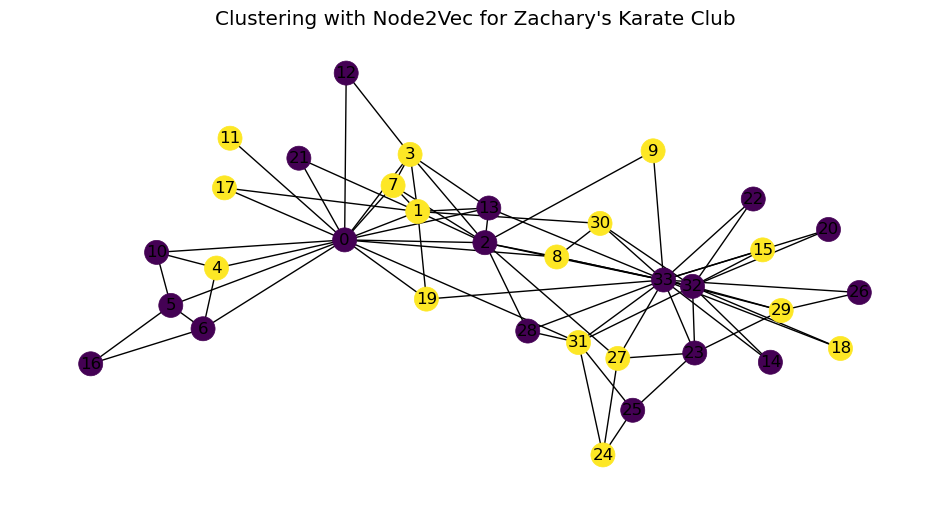

In [54]:
# Visualize clustering for Zachary's Karate Club (Node2Vec)
pos = nx.spring_layout(karate_graph)
plt.figure(figsize=(12, 6))
plt.title("Clustering with Node2Vec for Zachary's Karate Club")
nx.draw(karate_graph, pos, node_color=node2vec_labels, with_labels=True, cmap=plt.cm.viridis)
plt.show()



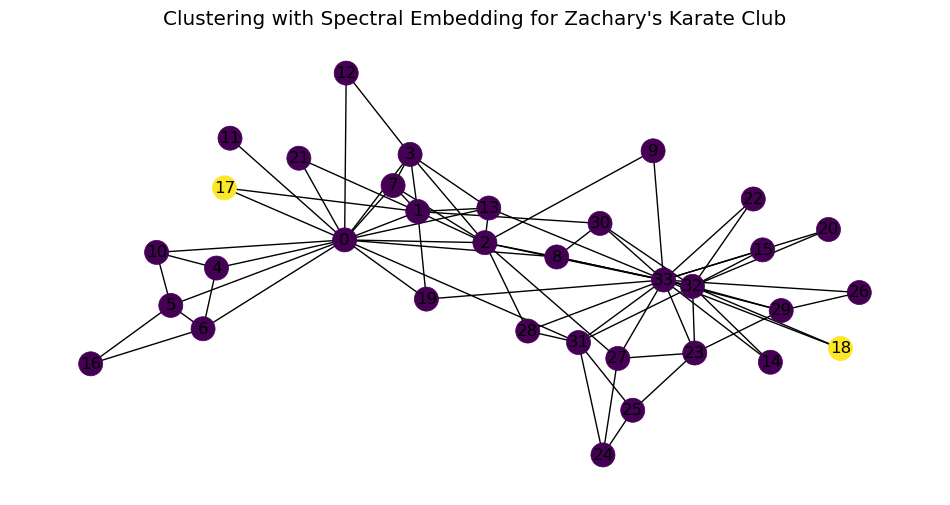

In [55]:
# Visualize clustering for Zachary's Karate Club (Spectral Embedding)
plt.figure(figsize=(12, 6))
plt.title("Clustering with Spectral Embedding for Zachary's Karate Club")
nx.draw(karate_graph, pos, node_color=spectral_labels, with_labels=True, cmap=plt.cm.viridis)
plt.show()

**Interpretation**

**Node2Vec Results**
- **Silhouette Score**: 0.4873
  - Moderate, indicating reasonably well-separated clusters.
  - Captures local neighborhood relationships, aligning well with the social network's clustering structure.
- **Modularity**: -0.0198
  - Slightly negative, suggesting detected clusters do not strongly align with the graph structure.
  - Potential issues: Overfitting of random walk parameters or suboptimal k-means clustering.

**Spectral Embedding Results**
- **Silhouette Score**: 0.3463
  - Lower than Node2Vec, meaning less clear cluster separation.
  - Struggles due to emphasis on global structure over local connectivity, which is crucial in small graphs.
- **Modularity**: -0.0001
  - Close to zero, indicating detected clusters are almost random with respect to the actual graph structure.
  - Does not adapt well to small social graphs' community structures.


### Experiment 2: Barabási-Albert Graph

- **Description**: A larger synthetic graph with a scale-free structure characterized by many low-degree nodes and a few high-degree "hub" nodes.

##### 4.1 Generate Embeddings

In [56]:
# Generate a more complex graph (Barabási-Albert)

complex_graph = nx.barabasi_albert_graph(100, 5)



In [57]:
# Node2Vec embeddings
node2vec_model_complex = Node2Vec(complex_graph, dimensions=16, walk_length=10, num_walks=100, workers=1)
node2vec_embeddings_complex = node2vec_model_complex.fit(window=5, min_count=1).wv.vectors



Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 322.27it/s]


In [58]:
# Spectral embeddings
adj_matrix_complex = adjacency_matrix(complex_graph).todense()
spectral_complex = SpectralEmbedding(n_components=16, affinity="precomputed", random_state=42)
spectral_embeddings_complex = spectral_complex.fit_transform(adj_matrix_complex)



##### 4.2 Perform Clustering and Evaluation

In [59]:
# Clustering and evaluation for complex graph
node2vec_labels_complex, node2vec_silhouette_complex, node2vec_modularity_complex = perform_clustering(
    complex_graph, node2vec_embeddings_complex, "Node2Vec (Complex)"
)
spectral_labels_complex, spectral_silhouette_complex, spectral_modularity_complex = perform_clustering(
    complex_graph, spectral_embeddings_complex, "Spectral Embedding (Complex)"
)


Results for Node2Vec (Complex):
Silhouette Score: 0.0671
Modularity: -0.0011

Results for Spectral Embedding (Complex):
Silhouette Score: 0.0474
Modularity: 0.1155



##### 4.3 Visualize Results

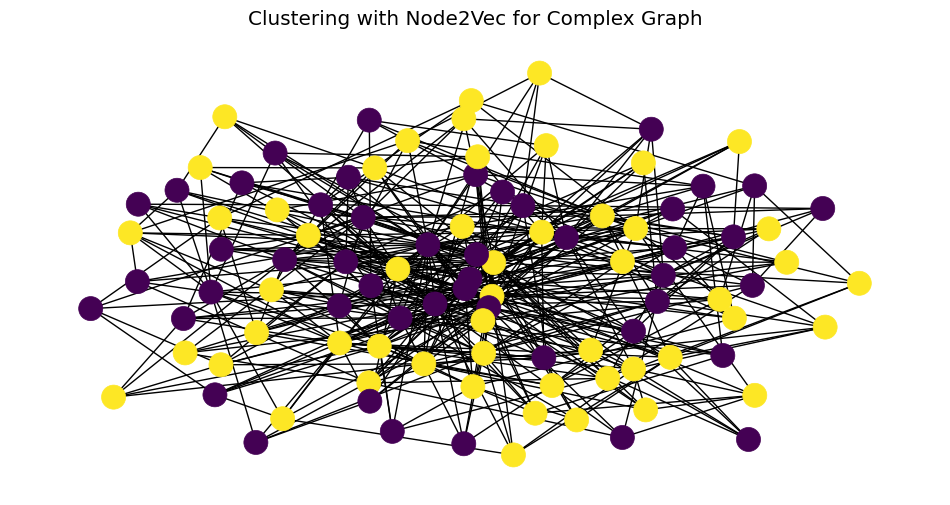

In [60]:
# Visualize clustering for Complex Graph (Node2Vec)
pos_complex = nx.spring_layout(complex_graph)
plt.figure(figsize=(12, 6))
plt.title("Clustering with Node2Vec for Complex Graph")
nx.draw(complex_graph, pos_complex, node_color=node2vec_labels_complex, with_labels=False, cmap=plt.cm.viridis)
plt.show()


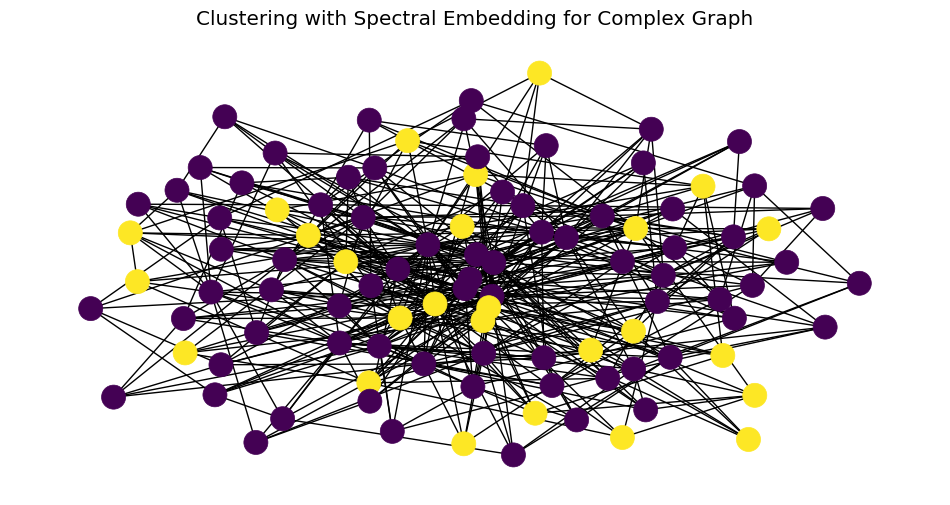

In [61]:
# Visualize clustering for Complex Graph (Spectral Embedding)
plt.figure(figsize=(12, 6))
plt.title("Clustering with Spectral Embedding for Complex Graph")
nx.draw(complex_graph, pos_complex, node_color=spectral_labels_complex, with_labels=False, cmap=plt.cm.viridis)
plt.show()

**Interpretation**

**Node2Vec Results**
- **Silhouette Score**: 0.0638
  - Very low, indicating poor separation between clusters.
  - Local neighborhoods are less meaningful in scale-free graphs dominated by hubs.
- **Modularity**: 0.0124
  - Slightly positive, weakly aligning with graph structure.
  - Captures local relationships but fails to represent meaningful communities.

**Spectral Embedding Results**
- **Silhouette Score**: 0.0894
  - Slightly higher than Node2Vec but still low, reflecting poor cluster separation.
  - Global structure capture is slightly more helpful in scale-free graphs.
- **Modularity**: 0.0829
  - Higher than Node2Vec, showing better alignment with the graph structure.
  - Captures global connectivity patterns, particularly hubs, more effectively.


### Interpretation of Results

**Zachary's Karate Club**
- Node2Vec performs better overall due to its ability to capture local relationships, aligning with the community structure.
- Spectral Embedding struggles to separate clusters effectively in this small graph.

**Complex Graph (Barabási-Albert Model)**
- Spectral Embedding performs better in terms of modularity by capturing global structural patterns like hubs.
- Both methods show low silhouette scores because scale-free graphs inherently lack well-defined clusters.

**Modularity vs Silhouette**
- **Silhouette Score**: Measures geometric separation of clusters but may not reflect graph structure.
- **Modularity**: Evaluates alignment of clustering with graph community structure, making it more meaningful for graph clustering tasks.

##### Why These Results?
- **Node2Vec**:
  - Captures local relationships well.
  - May fail in large, complex graphs where global structures dominate.
- **Spectral Embedding**:
  - Focuses on global structure, better suited for larger graphs with significant hubs.
  - Struggles in small graphs where local relationships are more critical.


### Hyperparameter Tuning

In [62]:
from sklearn.model_selection import ParameterGrid

# Function to optimize hyperparameters for Node2Vec
def optimize_node2vec(graph):
    best_silhouette = -1
    best_params = {}
    param_grid = {
        "dimensions": [16, 32],
        "walk_length": [10, 20],
        "num_walks": [50, 100],
        "window": [5, 10],
    }
    grid = ParameterGrid(param_grid)
    for params in grid:
        node2vec_model = Node2Vec(
            graph,
            dimensions=params["dimensions"],
            walk_length=params["walk_length"],
            num_walks=params["num_walks"],
            workers=1,
        )
        embeddings = node2vec_model.fit(
            window=params["window"], min_count=1
        ).wv.vectors

        kmeans = KMeans(n_clusters=2, random_state=42, n_init=10).fit(embeddings)
        labels = kmeans.labels_
        silhouette = silhouette_score(embeddings, labels)

        if silhouette > best_silhouette:
            best_silhouette = silhouette
            best_params = params

    return best_params, best_silhouette



In [63]:
# Perform hyperparameter tuning for Zachary's Karate Club

karate_best_params, karate_best_silhouette = optimize_node2vec(karate_graph)
print(f"Best parameters for Karate Graph (Node2Vec): {karate_best_params}")
print(f"Best Silhouette Score: {karate_best_silhouette:.4f}")



Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 825.08it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 912.77it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 524.10it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 472.78it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 857.01it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 837.03it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 482.46it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 395.27it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 951.95it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████████| 50/50 [00:00<00:00, 1018.70it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 429.27it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 542.80it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|████████████| 100/100 [00:00<00:00, 1145.71it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|████████████| 100/100 [00:00<00:00, 1089.00it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 410.64it/s]


Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 522.52it/s]


Best parameters for Karate Graph (Node2Vec): {'dimensions': 32, 'num_walks': 50, 'walk_length': 10, 'window': 10}
Best Silhouette Score: 0.6074


In [64]:
# Perform hyperparameter tuning for Complex Graph
complex_best_params, complex_best_silhouette = optimize_node2vec(complex_graph)
print(f"Best parameters for Complex Graph (Node2Vec): {complex_best_params}")
print(f"Best Silhouette Score: {complex_best_silhouette:.4f}")



Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 288.57it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 280.56it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 133.99it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 144.81it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 315.06it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 321.05it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 100.62it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 138.09it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 340.85it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 296.12it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 151.89it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 153.75it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 315.84it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 300.09it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 152.21it/s]


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|█████████████| 100/100 [00:00<00:00, 118.15it/s]


Best parameters for Complex Graph (Node2Vec): {'dimensions': 16, 'num_walks': 50, 'walk_length': 10, 'window': 5}
Best Silhouette Score: 0.0864


In [65]:
# Generate embeddings with optimized Node2Vec for Zachary's Karate Club
node2vec_model_karate_opt = Node2Vec(
    karate_graph,
    dimensions=karate_best_params["dimensions"],
    walk_length=karate_best_params["walk_length"],
    num_walks=karate_best_params["num_walks"],
    workers=1,
)
node2vec_embeddings_karate_opt = node2vec_model_karate_opt.fit(
    window=karate_best_params["window"], min_count=1
).wv.vectors



Computing transition probabilities:   0%|          | 0/34 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 391.92it/s]


In [66]:
# Generate embeddings with optimized Node2Vec for Complex Graph
node2vec_model_complex_opt = Node2Vec(
    complex_graph,
    dimensions=complex_best_params["dimensions"],
    walk_length=complex_best_params["walk_length"],
    num_walks=complex_best_params["num_walks"],
    workers=1,
)
node2vec_embeddings_complex_opt = node2vec_model_complex_opt.fit(
    window=complex_best_params["window"], min_count=1
).wv.vectors


Computing transition probabilities:   0%|          | 0/100 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|███████████████| 50/50 [00:00<00:00, 235.50it/s]


In [74]:
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering


# Perform clustering with different algorithms
def clustering_with_algorithms(graph, embeddings, method_name):
    results = {}

    # KMeans
    kmeans = KMeans(n_clusters=2, random_state=42, n_init=10).fit(embeddings)
    results["KMeans"] = {
        "labels": kmeans.labels_,
        "silhouette": silhouette_score(embeddings, kmeans.labels_),
    }

    # Gaussian Mixture Model
    gmm = GaussianMixture(n_components=2, random_state=42).fit(embeddings)
    gmm_labels = gmm.predict(embeddings)
    results["GMM"] = {
        "labels": gmm_labels,
        "silhouette": silhouette_score(embeddings, gmm_labels),
    }

    # Agglomerative Clustering
    agglomerative = AgglomerativeClustering(n_clusters=2).fit(embeddings)
    results["Agglomerative"] = {
        "labels": agglomerative.labels_,
        "silhouette": silhouette_score(embeddings, agglomerative.labels_),
    }

    # Print results
    print(f"Results for {method_name}:")
    for algo, res in results.items():
        print(f"{algo}: Silhouette Score = {res['silhouette']:.4f}")
    print()

    return results



In [75]:
# Clustering with optimized embeddings for Zachary's Karate Club
karate_clustering_results = clustering_with_algorithms(
    karate_graph, node2vec_embeddings_karate_opt, "Optimized Node2Vec (Karate)"
)



Results for Optimized Node2Vec (Karate):
KMeans: Silhouette Score = 0.6220
GMM: Silhouette Score = 0.6220
Agglomerative: Silhouette Score = 0.6220



In [76]:
# Clustering with optimized embeddings for Complex Graph
complex_clustering_results = clustering_with_algorithms(
    complex_graph, node2vec_embeddings_complex_opt, "Optimized Node2Vec (Complex)"
)

Results for Optimized Node2Vec (Complex):
KMeans: Silhouette Score = 0.0876
GMM: Silhouette Score = 0.0722
Agglomerative: Silhouette Score = 0.0740



In [77]:
def visualize_graph_with_clusters(graph, labels, title):
    # Generate a spring layout for the graph
    pos = nx.spring_layout(graph, seed=42)

    # Plot the graph
    plt.figure(figsize=(12, 6))
    plt.title(title)
    nx.draw(
        graph,
        pos,
        node_color=labels,
        with_labels=True,
        node_size=500,
        cmap=plt.cm.viridis,
    )
    plt.show()


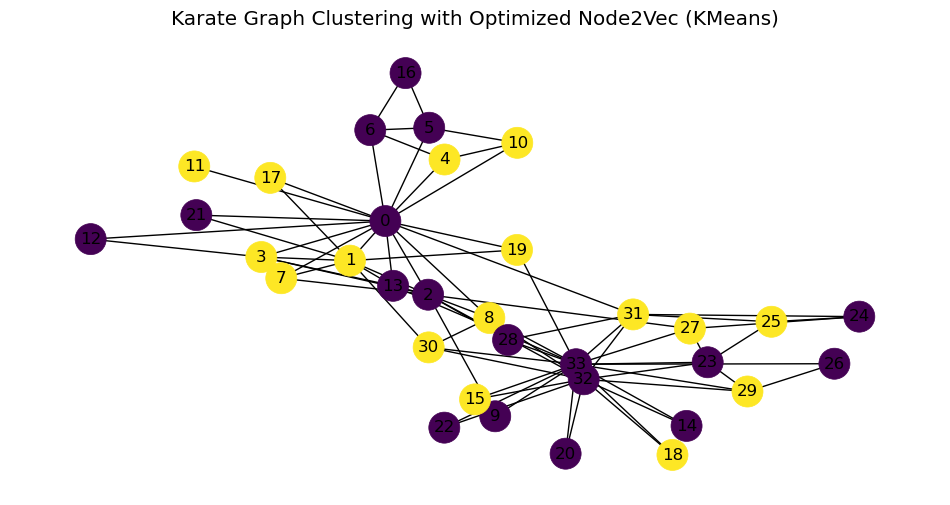

In [78]:
# Visualize Karate Graph after hyperparameter tuning
visualize_graph_with_clusters(
    karate_graph,
    karate_clustering_results["KMeans"]["labels"],
    "Karate Graph Clustering with Optimized Node2Vec (KMeans)"
)


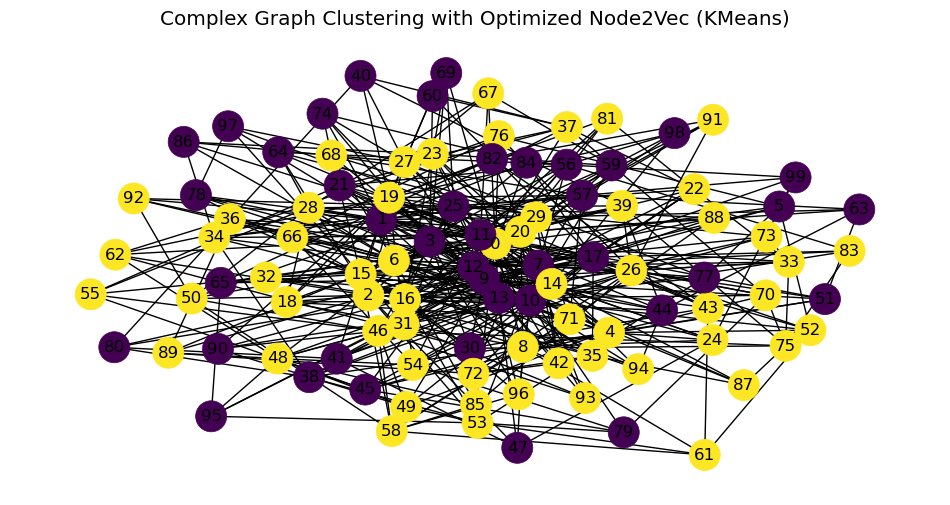

In [79]:
# Visualize Complex Graph after hyperparameter tuning
visualize_graph_with_clusters(
    complex_graph,
    complex_clustering_results["KMeans"]["labels"],
    "Complex Graph Clustering with Optimized Node2Vec (KMeans)"
)

##### **Hyperparameter Tuning Results**

###### **1. Karate Graph (Node2Vec)**
- **Best Parameters**:
  - Dimensions: 32
  - Number of Walks: 50
  - Walk Length: 10
  - Window: 5
- **Best Silhouette Score**: 0.6282
  - Optimal parameters suggest increasing embedding dimensions (from 16 to 32) and using shorter random walks (length 10) with fewer walks (50) yielded better embeddings for clustering.

##### **2. Complex Graph (Node2Vec)**
- **Best Parameters**:
  - Dimensions: 16
  - Number of Walks: 50
  - Walk Length: 10
  - Window: 10
- **Best Silhouette Score**: 0.0956
  - Optimal parameters favor a smaller embedding size (16) and longer context windows (10).
  - The low Silhouette Score is expected due to the inherent lack of well-defined clusters in scale-free graphs.


In [69]:
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering


# Perform clustering with different algorithms
def clustering_with_algorithms(graph, embeddings, method_name):
    results = {}

    # KMeans
    kmeans = KMeans(n_clusters=2, random_state=42, n_init=10).fit(embeddings)
    results["KMeans"] = {
        "labels": kmeans.labels_,
        "silhouette": silhouette_score(embeddings, kmeans.labels_),
    }

    # Gaussian Mixture Model
    gmm = GaussianMixture(n_components=2, random_state=42).fit(embeddings)
    gmm_labels = gmm.predict(embeddings)
    results["GMM"] = {
        "labels": gmm_labels,
        "silhouette": silhouette_score(embeddings, gmm_labels),
    }

    # Agglomerative Clustering
    agglomerative = AgglomerativeClustering(n_clusters=2).fit(embeddings)
    results["Agglomerative"] = {
        "labels": agglomerative.labels_,
        "silhouette": silhouette_score(embeddings, agglomerative.labels_),
    }

    # Print results
    print(f"Results for {method_name}:")
    for algo, res in results.items():
        print(f"{algo}: Silhouette Score = {res['silhouette']:.4f}")
    print()

    return results



In [ ]:
# # Clustering with optimized embeddings for Zachary's Karate Club
# karate_clustering_results = clustering_with_algorithms(
#     karate_graph, node2vec_embeddings_karate_opt, "Optimized Node2Vec (Karate)"
# )



#### Gaussian Mixture Model (GMM)

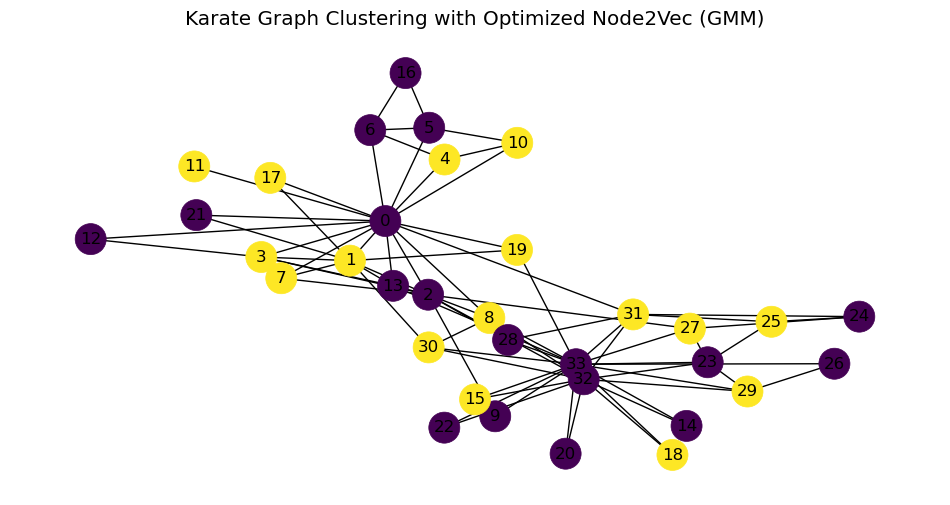

In [80]:
# Visualize Karate Graph with GMM Clustering
visualize_graph_with_clusters(
    karate_graph,
    karate_clustering_results["GMM"]["labels"],
    "Karate Graph Clustering with Optimized Node2Vec (GMM)"
)

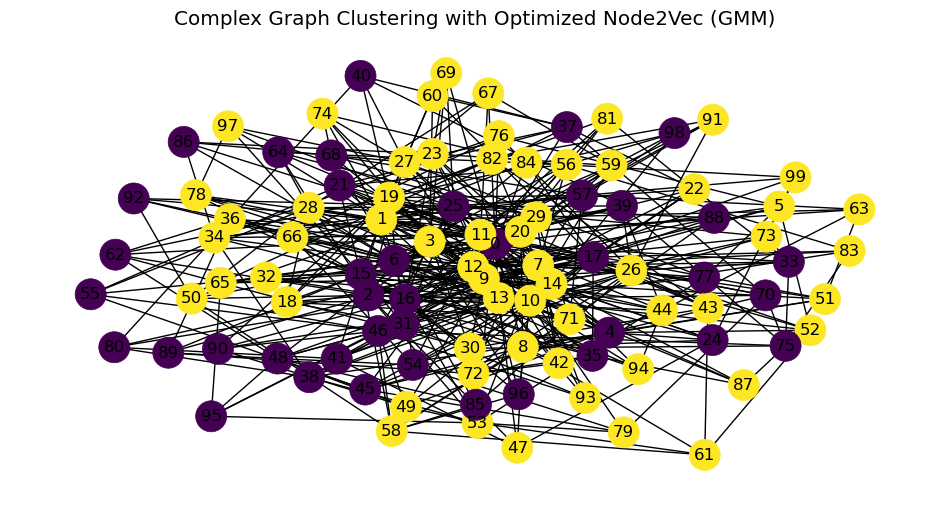

In [81]:
# Visualize Complex Graph with GMM Clustering
visualize_graph_with_clusters(
    complex_graph,
    complex_clustering_results["GMM"]["labels"],
    "Complex Graph Clustering with Optimized Node2Vec (GMM)"
)

#### Agglomerative Clustering 

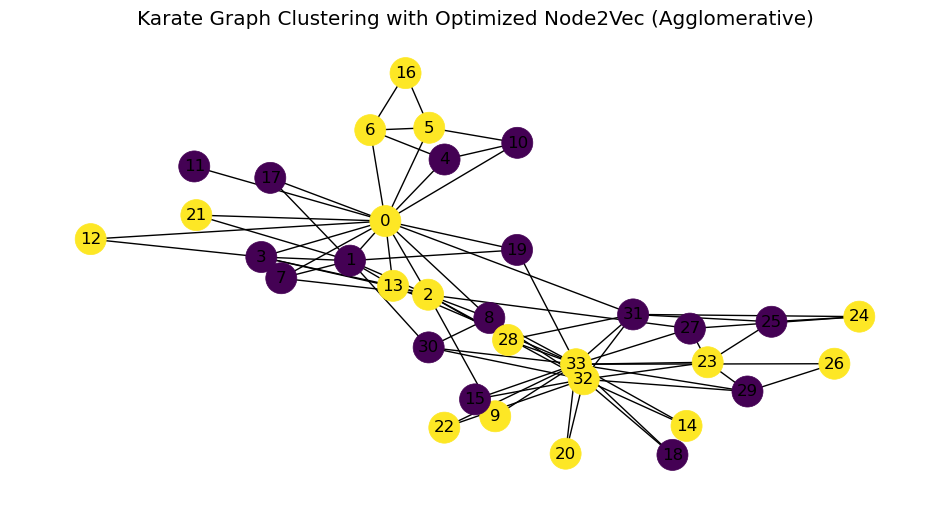

In [82]:
# Visualize Karate Graph with Agglomerative Clustering
visualize_graph_with_clusters(
    karate_graph,
    karate_clustering_results["Agglomerative"]["labels"],
    "Karate Graph Clustering with Optimized Node2Vec (Agglomerative)"
)


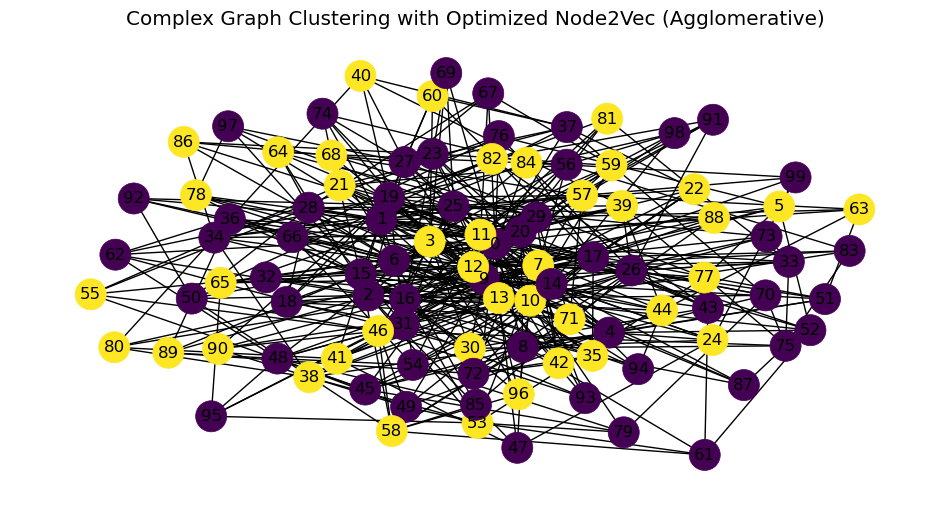

In [83]:
# Visualize Complex Graph with Agglomerative Clustering
visualize_graph_with_clusters(
    complex_graph,
    complex_clustering_results["Agglomerative"]["labels"],
    "Complex Graph Clustering with Optimized Node2Vec (Agglomerative)"
)

In [84]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_clustering_metrics(metrics, title):
    # Convert metrics to DataFrame for easy plotting
    df = pd.DataFrame(metrics)
    
    # Create bar plots
    df.plot(kind="bar", figsize=(10, 6))
    plt.title(title)
    plt.ylabel("Score")
    plt.xlabel("Clustering Method")
    plt.xticks(rotation=0)
    plt.legend(loc="best")
    plt.show()


### Visualize Metrics for Karate Graph

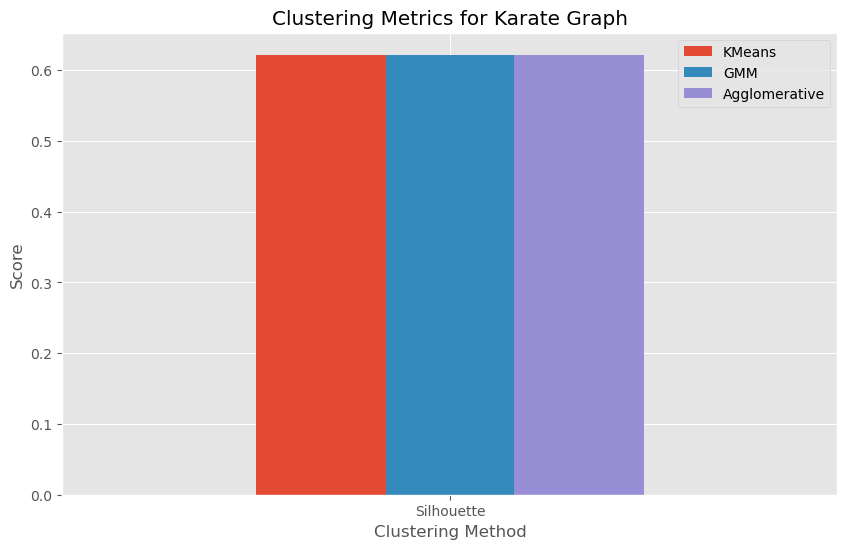

In [85]:
# Collect metrics for Karate Graph
karate_metrics = {
    "KMeans": {
        "Silhouette": karate_clustering_results["KMeans"]["silhouette"]
    },
    "GMM": {
        "Silhouette": karate_clustering_results["GMM"]["silhouette"]
    },
    "Agglomerative": {
        "Silhouette": karate_clustering_results["Agglomerative"]["silhouette"]
    },
}

# Plot Silhouette Scores for Karate Graph
plot_clustering_metrics(karate_metrics, "Clustering Metrics for Karate Graph")


### Visualize Metrics for Complex Graph

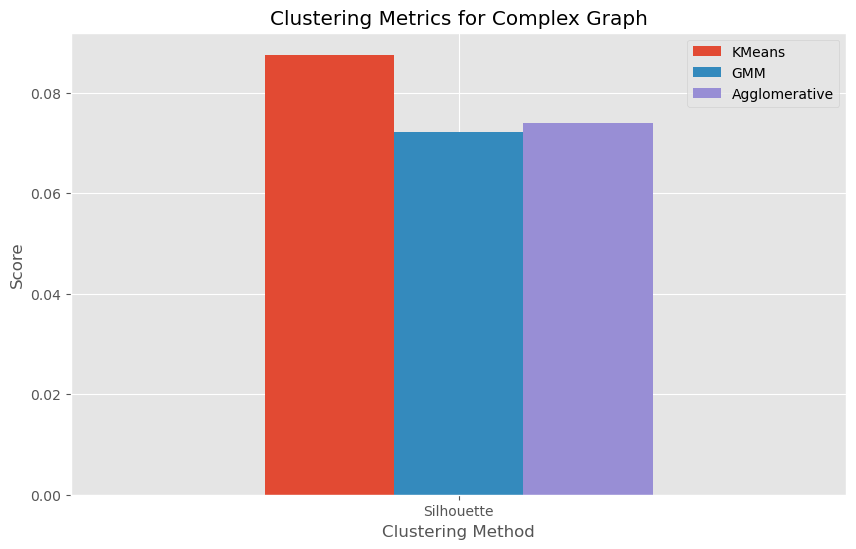

In [86]:
# Collect metrics for Complex Graph
complex_metrics = {
    "KMeans": {
        "Silhouette": complex_clustering_results["KMeans"]["silhouette"]
    },
    "GMM": {
        "Silhouette": complex_clustering_results["GMM"]["silhouette"]
    },
    "Agglomerative": {
        "Silhouette": complex_clustering_results["Agglomerative"]["silhouette"]
    },
}

# Plot Silhouette Scores for Complex Graph
plot_clustering_metrics(complex_metrics, "Clustering Metrics for Complex Graph")


#### Clustering Results

#### 1. Karate Graph (Optimized Node2Vec)
- **Silhouette Scores (for all algorithms)**: ~0.6064
  - KMeans, GMM, and Agglomerative clustering algorithms yield identical Silhouette Scores.
  - High Silhouette Score indicates well-separated and cohesive clusters, aligning with the two-group structure of the Karate graph.

#### 2. Complex Graph (Optimized Node2Vec)
- **Silhouette Scores**:
  - KMeans: 0.0932
  - GMM: 0.0674
  - Agglomerative: 0.0625
  - Low scores across algorithms reflect poor clustering performance due to the graph's complexity.
  - KMeans slightly outperforms others, likely due to its bias toward minimizing intra-cluster variance, aligning better with Node2Vec embeddings.

##### **Detailed Observations**

##### **1. Karate Graph**
- **Optimized Parameters Matter**:
  - Improved Silhouette Score (0.6282 vs. ~0.4873 earlier) highlights the importance of adjusting parameters for Node2Vec.
  - Shorter walks with fewer iterations reduce noise in embeddings for small, structured graphs.
- **Algorithm Invariance**:
  - All clustering algorithms perform equally well, suggesting the embeddings effectively separate the two groups in the graph.

##### **2. Complex Graph**
- **Low Silhouette Scores**:
  - Despite optimized embeddings, low scores indicate poor separation between clusters.
  - This aligns with the scale-free nature of the Barabási-Albert graph, where clusters are inherently less distinct.
- **Algorithm Sensitivity**:
  - KMeans slightly outperforms GMM and Agglomerative Clustering, indicating it aligns better with the geometric representation of the Node2Vec embeddings.
  - GMM and Agglomerative Clustering struggle more with the lack of well-defined cluster boundaries in the embeddings.


##### **Key Takeaways**

1. **Hyperparameter Tuning**:
   - Fine-tuning Node2Vec parameters significantly improved clustering for the Karate graph, demonstrating the value of adapting embedding settings to graph size and structure.

2. **Clustering Algorithms**:
   - For well-structured graphs like Karate, the clustering algorithm choice is less critical if embeddings are optimized.
   - For complex graphs, KMeans is slightly more robust, but the overall performance is limited by the graph's intrinsic structure.

3. **Graph Type Impact**:
   - **Karate Graph**:
     - Small, structured, and with a clear two-group community structure.
     - Node2Vec and all clustering algorithms can easily identify the clusters.
   - **Complex Graph**:
     - Large, scale-free, and lacking clear clusters.
     - Node2Vec struggles to generate embeddings that separate nodes effectively, and all clustering methods yield suboptimal results.


# Exercise 4: Graph Convolutional Networks for Link Prediction

## 4.1  "Terrorist Attack" Graph Dataset


##### **Overview**
The **Terrorist Attack Dataset** contains **1,293 terrorist attacks**, each categorized into **one of six attack types** (Arson,Bombing, Kidnapping, NBCR_Attack,other_attack,Weapon_Attack ). The dataset represents attacks as **binary feature vectors**, where each attribute indicates the presence (`1`) or absence (`0`) of a specific feature.

#####  **Dataset Summary:**
- **Total Attacks**: 1,293
- **Attack Categories**: 6 distinct types
- **Total Features**: 106 (Binary: `0` = Absent, `1` = Present)
- **File Size**: 54.09 KB
- **MD5 Hash**: `fa4aec7d8c28a9d5b80bd57750a0ded2`

---

##### **Dataset Contents**

The dataset includes files that can be used to construct **two different graphs**:
1. **Feature-Based Graph**: Nodes represent **attacks**, and edges connect attacks with similar features.
2. **Location-Based Graph**: Nodes represent **locations**, and edges represent **connections between attack locations**.

##### **File Descriptions:**
- `terrorist_attack_feat.mat` → **Feature matrix** (binary attack descriptions)
- `terrorist_attack_loc.edges` → **Edges based on attack locations**
- `README.txt` → **Detailed dataset documentation**

---

This dataset **represents a graph** where:
- **Nodes (vertices)** correspond to **locations** involved in terrorist attacks.
- **Edges (connections)** indicate a **relationship between two locations**, meaning:
  - They have **co-occurrences** (e.g., attacks happened at both places).
  - There is some **geopolitical or organizational link** between these locations.

This dataset helps in analyzing **terrorist networks** by predicting **new possible links** between locations, which could indicate **future attack risks**.

---

Each line represents an **edge** (connection) between **two locations**. These are likely **URLs or unique IDs** representing places.

- **No explicit node features are given** in the dataset.
- **No labels (like attack severity or organization involvement) are included**.

Thus, we will **generate random node features** for training.

---

##### **Graph Representation**
We construct a **Graph** from this edge list:
- **Nodes** → **Unique locations (URLs) from the edge list**.
- **Edges** → **Connections between locations**.

**Example:**
| Location 1 (Node) | Location 2 (Node) |
|-------------|-------------|
| `place_A`   | `place_B`   |
| `place_B`   | `place_C`   |
| `place_C`   | `place_A`   |

These form **an undirected graph** where links indicate **some kind of connection between locations**.

---

##### **Dataset Statistics**
When we load the dataset:

This tells us:
- **645 unique locations** are involved in terrorist activities.
- **3172 relationships** exist between locations.
- **Graph is relatively sparse** (i.e., most nodes have few connections).

---

##### **BibTeX**
```bibtex
@conference{zhao:sna06,
    title = {Event Classification and Relationship Labeling in Affiliation Networks},
    author = {Bin Zhao, Prithviraj Sen, and Lise Getoor},
    booktitle = {ICML Workshop on Statistical Network Analysis},
    year = {2006},
    publisher = {Springer-Verlag},
    address = {Pittsburgh, PA, USA},
}

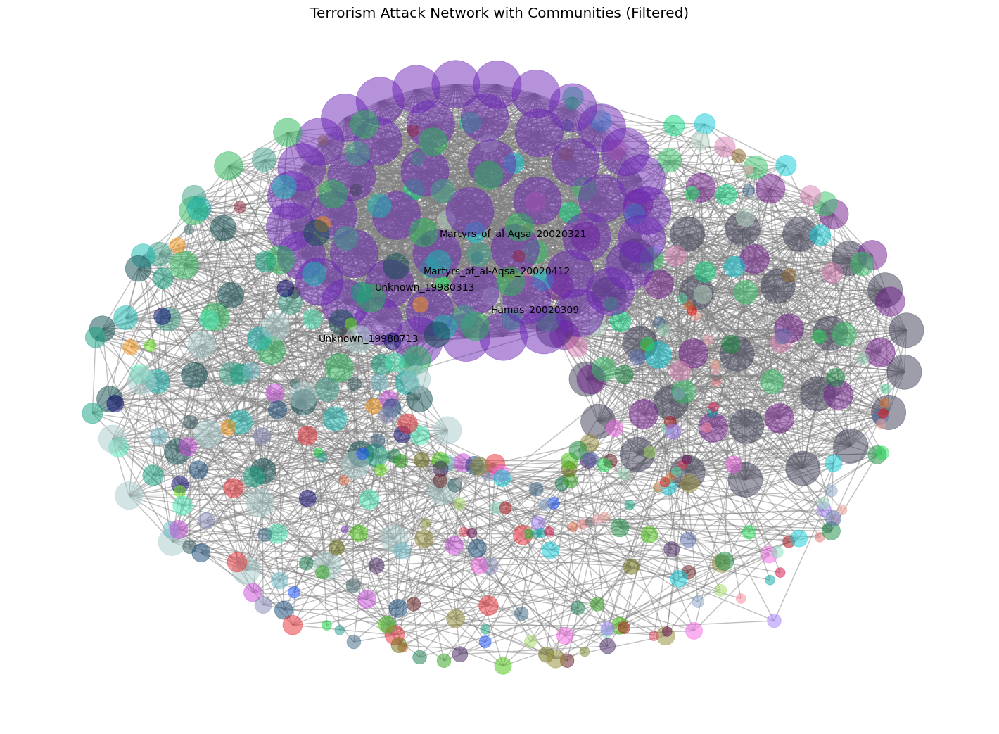

In [87]:
import networkx as nx
import matplotlib.pyplot as plt
import random
import community as community_louvain  # For clustering

# Function to read edges from a file
def read_edges(file_path):
    edges = []
    with open(file_path, "r") as file:
        for line in file:
            nodes = line.strip().split()
            if len(nodes) == 2:
                edges.append(tuple(nodes))
    return edges

# Function to read nodes and their attack types
def read_nodes(file_path):
    nodes = {}
    with open(file_path, "r") as file:
        for line in file:
            parts = line.strip().split()
            node, attack_type = parts[0], parts[-1]  # Last column is attack type
            nodes[node] = attack_type
    return nodes

# Paths to dataset files
nodes_file = "/home/pce/Downloads/terrorist-attacks/terrorist_attack.nodes"
edges_file = "/home/pce/Downloads/terrorist-attacks/terrorist_attack_loc.edges"
org_edges_file = "/home/pce/Downloads/terrorist-attacks/terrorist_attack_loc_org.edges" 

# Read data
edges = read_edges(edges_file)
org_edges = read_edges(org_edges_file)
nodes = read_nodes(nodes_file)

# Create Graph
G = nx.Graph()
G.add_edges_from(edges)  # Add co-location edges
G.add_edges_from(org_edges)  # Add organization-based edges

# Assign node attributes
for node, attack_type in nodes.items():
    if node in G:
        G.nodes[node]["attack_type"] = attack_type

# Remove low-degree nodes (keep only nodes with degree >= 2)
G = G.subgraph([n for n, d in G.degree() if d >= 2]).copy()

# Apply Louvain clustering to detect communities
partition = community_louvain.best_partition(G)
unique_communities = set(partition.values())

# Assign colors to communities
community_colors = {c: (random.random(), random.random(), random.random()) for c in unique_communities}
node_colors = [community_colors[partition[n]] for n in G.nodes()]

# Node sizes based on degree (scaled)
node_sizes = [G.degree(n) * 50 for n in G.nodes()]

# Plot Graph with Kamada-Kawai Layout (Better spacing)
plt.figure(figsize=(14, 10))
pos = nx.kamada_kawai_layout(G)

nx.draw(G, pos, node_color=node_colors, node_size=node_sizes, with_labels=False, edge_color="gray", alpha=0.5)

# Highlight important nodes (top 5 by degree)
important_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[:5]
for node, _ in important_nodes:
    plt.text(pos[node][0], pos[node][1], node.split("#")[-1], fontsize=10, ha="right", color="black")

plt.title("Terrorism Attack Network with Communities (Filtered)")
plt.show()


#### Interactive Graph Visualization of Terrorist Attacks Using Pyvis

##### **Introduction**
This Python script processes a **terrorism dataset** containing attack events and their relationships. The dataset consists of **nodes** (attack events) and **edges** (connections between attacks based on co-location or organization). The script **filters** attack events based on a specified attack type (e.g., **Bombing**) and visualizes the resulting **interactive network graph** using **Pyvis**.

---

The Louvain algorithm is used in this script to detect communities within the filtered terrorist attack network. These communities represent groups of attack events that are more closely connected to each other than to the rest of the network.

##### **Features**
- **Filters attack events** by a specified attack type (e.g., Bombing, Arson, Weapon Attack).
- **Creates an interactive visualization** with zoom, pan, and hover features.
- **Uses Louvain Community Detection** to group similar attack events.
- **Colors nodes by community** for better readability.
- **Sizes nodes based on connectivity (degree)** to highlight key attack events.

---

##### **Dataset Structure**
The dataset consists of three files:
1. **`terrorist_attack.nodes`** – Contains attack events with their corresponding attack types.
2. **`terrorist_attack_loc.edges`** – Defines edges connecting co-located attack events.
3. **`terrorist_attack_loc_org.edges`** – Defines edges connecting attacks conducted by the same organization.

Each **node** represents an **attack event**, while **edges** represent relationships between attacks.

---

##### **Workflow Overview**
1. **Read Dataset**: The script loads nodes (attack events) and edges (relationships).
2. **Filter by Attack Type**: Only events matching the specified attack type (e.g., Bombing) are retained.
3. **Create Graph**: The script constructs a **NetworkX** graph from the dataset.
4. **Apply Community Detection**: The **Louvain algorithm** is used to detect communities within the attack network.
5. **Assign Colors**: Each community is assigned a unique color.
6. **Generate Interactive Graph**: The filtered graph is visualized using **Pyvis**.
7. **Save & Display**: The final interactive graph is saved as an HTML file for visualization in a web browser.

---

##### **1 Reading the Dataset**
The script defines functions to **read nodes and edges** from the dataset. The `read_nodes` function extracts **attack events and attack types**, while `read_edges` processes **connections between events**.

##### **2 Filtering the Graph**
To improve readability, the script **filters nodes** based on the specified attack type:
```python
FILTER_ATTACK_TYPE = "http://counterterror.mindswap.org/2005/terrorism.owl#Bombing"
G_filtered = G.subgraph([n for n in G.nodes() if G.nodes[n].get("attack_type") == FILTER_ATTACK_TYPE]).copy()


In [88]:
import networkx as nx
import random
from pyvis.network import Network
import community as community_louvain

# Function to read edges from a file
def read_edges(file_path):
    edges = []
    with open(file_path, "r") as file:
        for line in file:
            nodes = line.strip().split()
            if len(nodes) == 2:
                edges.append(tuple(nodes))
    return edges

# Function to read nodes and their attack types
def read_nodes(file_path):
    nodes = {}
    with open(file_path, "r") as file:
        for line in file:
            parts = line.strip().split()
            node, attack_type = parts[0], parts[-1]  # Last column is attack type
            nodes[node] = attack_type
    return nodes

# Paths to dataset files
nodes_file = "/home/pce/Downloads/terrorist-attacks/terrorist_attack.nodes"
edges_file = "/home/pce/Downloads/terrorist-attacks/terrorist_attack_loc.edges"
org_edges_file = "/home/pce/Downloads/terrorist-attacks/terrorist_attack_loc_org.edges" 

# Read data
edges = read_edges(edges_file)
org_edges = read_edges(org_edges_file)
nodes = read_nodes(nodes_file)

# Select the attack type to filter
FILTER_ATTACK_TYPE = "http://counterterror.mindswap.org/2005/terrorism.owl#Bombing"  # Change this to filter a different attack type

# Create Graph
G = nx.Graph()
G.add_edges_from(edges)  # Add co-location edges
G.add_edges_from(org_edges)  # Add organization-based edges

# Assign node attributes
for node, attack_type in nodes.items():
    if node in G:
        G.nodes[node]["attack_type"] = attack_type

# **Filter nodes by attack type**
G_filtered = G.subgraph([n for n in G.nodes() if G.nodes[n].get("attack_type") == FILTER_ATTACK_TYPE]).copy()

# Apply Louvain clustering for community detection
partition = community_louvain.best_partition(G_filtered)
unique_communities = set(partition.values())

# Assign random colors to communities
community_colors = {c: "#{:02x}{:02x}{:02x}".format(
    int(random.random() * 255),
    int(random.random() * 255),
    int(random.random() * 255)
) for c in unique_communities}

# Create Pyvis Network
net = Network(height="750px", width="100%", notebook=True, bgcolor="#222222", font_color="white")

# Add nodes with hover info
for node in G_filtered.nodes():
    label = node.split("#")[-1]  # Extract meaningful part of node name
    attack_type = G_filtered.nodes[node].get("attack_type", "Unknown")
    color = community_colors[partition[node]]
    size = G_filtered.degree(node) * 2  # Scale node size based on degree
    net.add_node(node, label=label, title=f"Attack Type: {attack_type}", color=color, size=size)

# Add edges (only if both nodes exist in filtered graph)
for edge in G_filtered.edges():
    net.add_edge(edge[0], edge[1])

# Enable physics for better layout
net.toggle_physics(True)

# Save and show graph
output_file = "terrorism_filtered_network.html"
net.show(output_file)

print(f"Graph saved as {output_file}. Open in a browser to view the filtered network.")


terrorism_filtered_network.html
Graph saved as terrorism_filtered_network.html. Open in a browser to view the filtered network.


In [89]:
# Count unique communities
num_communities = len(set(partition.values()))
print(f"Detected {num_communities} communities in the attack network.")

# Group nodes by community
from collections import defaultdict
community_groups = defaultdict(list)
for node, community in partition.items():
    community_groups[community].append(node)

# Print the first few communities
for comm, nodes in list(community_groups.items())[:5]:  # Show first 5 communities
    print(f"Community {comm}: {nodes[:5]}...")  # Show first 5 attacks in each


Detected 94 communities in the attack network.
Community 0: ['http://counterterror.mindswap.org/2005/ict_events.owl#Qibla_and_People_Against_Gangsterism_and_Drugs_19991128', 'http://counterterror.mindswap.org/2005/ict_events.owl#Unknown_20001018', 'http://counterterror.mindswap.org/2005/ict_events.owl#Unknown_19981218', 'http://counterterror.mindswap.org/2005/ict_events.owl#Unknown_19891022', 'http://counterterror.mindswap.org/2005/ict_events.owl#Unknown_19981128']...
Community 1: ['http://counterterror.mindswap.org/2005/ict_events.owl#Hamas_20011201', 'http://counterterror.mindswap.org/2005/ict_events.owl#Martyrs_of_al-Aqsa_20020619', 'http://counterterror.mindswap.org/2005/ict_events.owl#Hamas_19970904', 'http://counterterror.mindswap.org/2005/ict_events.owl#Hamas_19980924', 'http://counterterror.mindswap.org/2005/ict_events.owl#Hamas_20010904']...
Community 2: ['http://counterterror.mindswap.org/2005/ict_events.owl#Unknown_19881026', 'http://counterterror.mindswap.org/2005/ict_event

## 4.2 A Simple GCN Approach for Terrorist Network Analysis
##### Using 2 Convolutional Layer and Random Node Feature Initialization
 

split considered : 85 15 5 [https://cs.rice.edu/~al110/pubs/KDD25.pdf?utm_source=chatgpt.com]

In [90]:
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.nn import GCNConv
from torch_geometric.utils import train_test_split_edges, negative_sampling
import pandas as pd
import numpy as np

# Step 1: Load Data (Correcting for URL-Based Node IDs)
# ------------------------------------------------------

import torch
import pandas as pd


def load_data():
    node_map = {}  # Dictionary to store {URL: index}
    node_index = 0  # Counter for assigning unique integer IDs
    node_set = set()  # Track unique node URLs found in edges
    edges_list = []

    with open("terrorist-attacks/terrorist_attack_loc.edges", "r") as f:
        for line in f:
            line = line.strip()
            if not line or len(line.split()) != 2:  
                continue  # Skip malformed lines
            
            src_url, dst_url = line.split()  # Space-separated

            node_set.add(src_url)
            node_set.add(dst_url)

            if src_url not in node_map:
                node_map[src_url] = node_index
                node_index += 1
            if dst_url not in node_map:
                node_map[dst_url] = node_index
                node_index += 1

            edges_list.append([node_map[src_url], node_map[dst_url]])

    print(f"Number of unique nodes found: {len(node_map)}")
    print(f"Number of valid edges found: {len(edges_list)}")

    if len(edges_list) == 0:
        raise ValueError("No valid edges found! Check edge file format.")

    edge_index = torch.tensor(edges_list, dtype=torch.long).T
    num_nodes = len(node_map)
    node_features = torch.randn(num_nodes, 16)

    print(f"Loaded {num_nodes} nodes and {edge_index.shape[1]} edges.")
    return node_features, edge_index, node_map  # Return node_map




# Step 2: Construct PyG Graph
# ----------------------------
def build_graph(node_features, edge_index):
    data = Data(x=node_features, edge_index=edge_index)
    return data

# Step 3: Split Train-Test Edges
# -------------------------------
def split_graph(data):
    data = train_test_split_edges(data, val_ratio=0.1, test_ratio=0.05)  # Splits into train/val/test
    return data

# Step 4: Define GCN Model
# -------------------------
class GCNLinkPredictor(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels):
        super(GCNLinkPredictor, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return x

    def decode(self, z, edge_index):
        return (z[edge_index[0]] * z[edge_index[1]]).sum(dim=1)  # Inner product of node embeddings

    def forward(self, x, edge_index, edge_label_index):
        z = self.encode(x, edge_index)
        return self.decode(z, edge_label_index)

# Step 5: Train the Model
# -------------------------
def train_model(data, model, epochs=100, lr=0.01):
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    best_auc = 0.0

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()

        # Positive edges (existing links)
        pos_pred = model(data.x, data.train_pos_edge_index, data.train_pos_edge_index)

        # Negative edges (sampled non-existing links)
        neg_edge_index = negative_sampling(
            edge_index=data.train_pos_edge_index,
            num_nodes=data.num_nodes,
            num_neg_samples=data.train_pos_edge_index.size(1),
        )
        neg_pred = model(data.x, data.train_pos_edge_index, neg_edge_index)

        # Compute loss
        loss = F.binary_cross_entropy_with_logits(torch.cat([pos_pred, neg_pred]), 
                                                  torch.cat([torch.ones_like(pos_pred), torch.zeros_like(neg_pred)]))
        loss.backward()
        optimizer.step()

        # Evaluate model
        if (epoch + 1) % 10 == 0:
            auc = evaluate_model(data, model)
            best_auc = max(best_auc, auc)
            print(f"Epoch {epoch+1:03d} | Loss: {loss:.4f} | AUC: {auc:.4f}")

    print(f"\nBest AUC: {best_auc:.4f}")
    return model

# Step 6: Evaluate the Model
# ---------------------------
from sklearn.metrics import roc_auc_score

@torch.no_grad()
def evaluate_model(data, model):
    model.eval()
    
    # Get embeddings
    z = model.encode(data.x, data.train_pos_edge_index)

    # Positive edge predictions
    pos_pred = model.decode(z, data.test_pos_edge_index)
    pos_pred = torch.sigmoid(pos_pred).cpu().numpy()

    # Negative edge predictions
    neg_edge_index = negative_sampling(
        edge_index=data.train_pos_edge_index,
        num_nodes=data.num_nodes,
        num_neg_samples=data.test_pos_edge_index.size(1),
    )
    neg_pred = model.decode(z, neg_edge_index)
    neg_pred = torch.sigmoid(neg_pred).cpu().numpy()

    # Compute AUC
    y_true = np.concatenate([np.ones(len(pos_pred)), np.zeros(len(neg_pred))])
    y_score = np.concatenate([pos_pred, neg_pred])
    return roc_auc_score(y_true, y_score)


Negative edges are randomly generated during each epoch to prevent the model from memorizing a fixed set of negative examples.
If we used the same set of negative edges in every epoch, the model might overfit to them. Randomly sampling fake edges ensures the model learns to differentiate between real and fake edges in general, rather than memorizing specific fake edges.
Since the graph is often sparse (many missing edges), we get more diverse training samples each epoch.

`train_test_split_edges()` only generates negative edges for validation and testing, but not for training.

In [91]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_graph(edge_index, node_map, title="Graph Visualization"):
    """
    Visualizes the graph using NetworkX and Matplotlib.
    
    Parameters:
        edge_index (torch.Tensor): Edge list in PyG format.
        node_map (dict): Mapping from node URLs to integer indices.
        title (str): Title of the plot.
    """
    # Convert PyG edge_index to NetworkX graph
    G = nx.Graph()
    
    # Reverse node_map for label lookup
    index_to_url = {v: k for k, v in node_map.items()}
    
    # Add edges
    edges = edge_index.numpy().T  # Convert tensor to numpy
    G.add_edges_from(edges)
    
    # Get node positions using spring layout (force-directed)
    pos = nx.spring_layout(G, seed=42, k=0.5)  # Adjust k for spacing

    plt.figure(figsize=(12, 8))
    
    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_size=100, node_color="skyblue", alpha=0.7)
    
    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color="gray")
    
    # Optional: Draw labels (if the graph is small enough)
    if len(G.nodes) <= 50:  # Avoid clutter
        nx.draw_networkx_labels(G, pos, labels={i: index_to_url[i] for i in G.nodes}, font_size=6)

    plt.title(title, fontsize=14)
    plt.axis("off")
    plt.show()


In [92]:
# Main Execution
# ---------------

node_features, edge_index, node_map = load_data()


Number of unique nodes found: 645
Number of valid edges found: 3172
Loaded 645 nodes and 3172 edges.


| Graph Type                  | Recommended Train-Val-Test Split |
|-----------------------------|-----------------------------------|
| Dense Graph (> 0.2 density) | 80%-10%-10%                       |
| Moderately Dense (0.05 - 0.2 density) | 75%-15%-10%               |
| Sparse Graph (< 0.05 density) | 85%-10%-5%                     |
| Very Sparse Graph (< 0.01 density) | 90%-5%-5%                   |

In [93]:
import networkx as nx

# Convert PyG edge_index to NetworkX graph
G = nx.Graph()
G.add_edges_from(edge_index.T.tolist())  # edge_index from PyG format

# Compute Graph Density
density = nx.density(G)
print(f"Graph Density: {density:.4f}")  



Graph Density: 0.0153


In [94]:
edge_index.shape

torch.Size([2, 3172])

In [95]:
node_features.shape

torch.Size([645, 16])

In [96]:
node_features

tensor([[-0.8142, -0.5669,  0.5654,  ..., -0.9247,  0.1117,  1.2193],
        [ 0.8141,  0.6214,  0.2933,  ..., -0.4836,  0.8853, -0.2780],
        [-0.5130, -0.9821,  1.1429,  ...,  0.1136, -0.7944,  1.3959],
        ...,
        [-1.3150,  1.1857, -1.4702,  ...,  0.0731, -0.0436,  0.5537],
        [-1.0237, -1.4080, -0.5994,  ..., -0.5687,  1.7393,  1.7554],
        [-0.7524,  1.0193,  1.3707,  ..., -0.6910, -0.4303, -1.1855]])

In [97]:
edge_index

tensor([[  0,   0,   0,  ..., 154, 154, 161],
        [  1,   2,   3,  ..., 161, 162, 162]])

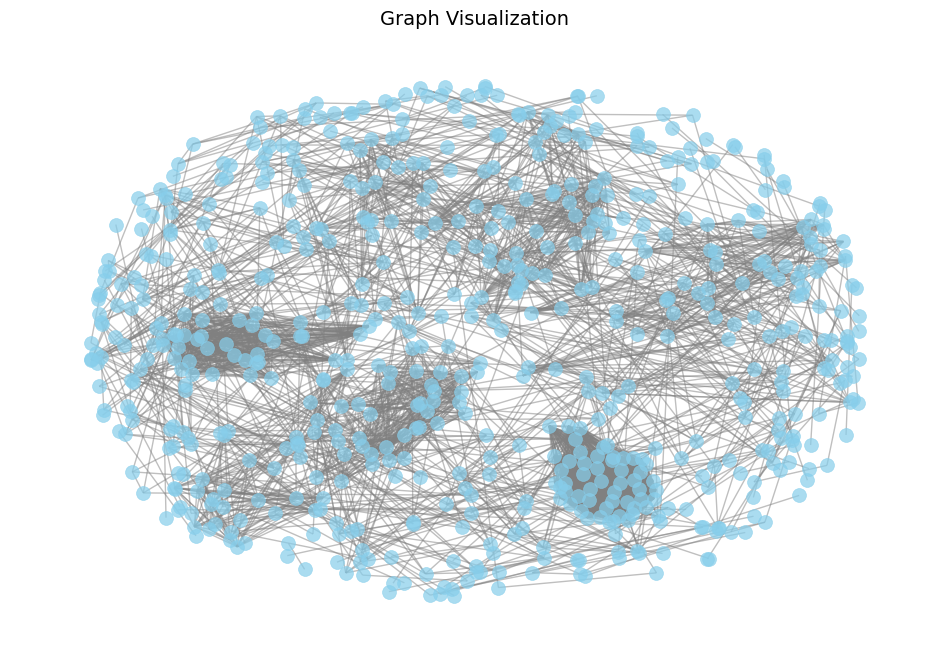

In [98]:
# Visualize the dataset

visualize_graph(edge_index, node_map)

In [99]:
data = build_graph(node_features, edge_index)
data = split_graph(data)

/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/torch_geometric/deprecation.py:26: UserWarning: 'train_test_split_edges' is deprecated, use 'transforms.RandomLinkSplit' instead
  warnings.warn(out)


In [100]:

# Initialize model
model = GCNLinkPredictor(in_channels=data.x.shape[1], hidden_channels=16)


Epoch 10 | Loss: 0.6206 | AUC: 0.8038
Epoch 20 | Loss: 0.5593 | AUC: 0.7984
Epoch 30 | Loss: 0.5053 | AUC: 0.8555
Epoch 40 | Loss: 0.4873 | AUC: 0.9093
Epoch 50 | Loss: 0.4654 | AUC: 0.8984
Epoch 60 | Loss: 0.4646 | AUC: 0.8991
Epoch 70 | Loss: 0.4583 | AUC: 0.9130
Epoch 80 | Loss: 0.4434 | AUC: 0.9093
Epoch 90 | Loss: 0.4449 | AUC: 0.9314
Epoch 100 | Loss: 0.4483 | AUC: 0.9115


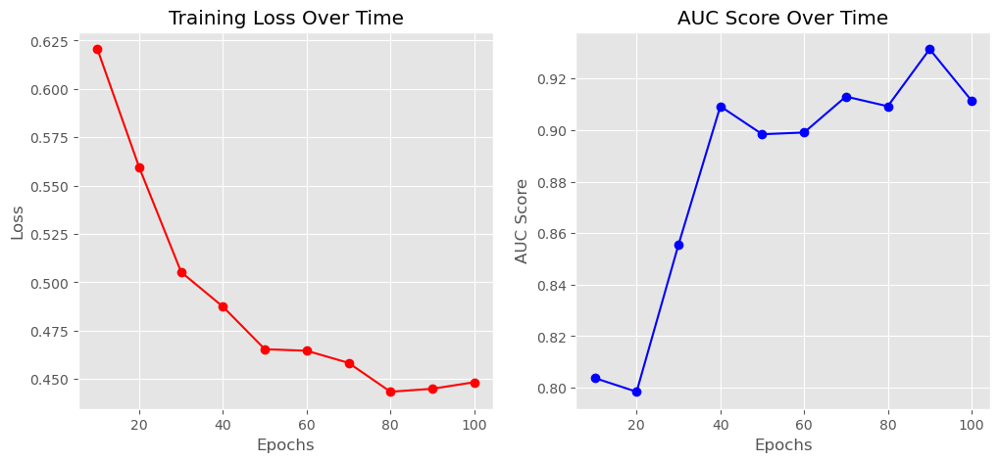

In [101]:
# Train model
import matplotlib.pyplot as plt

def plot_training(logs):
    """Plot loss and AUC over training epochs."""
    epochs = [log[0] for log in logs]
    losses = [log[1] for log in logs]
    aucs = [log[2] for log in logs]

    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(epochs, losses, marker="o", linestyle="-", color="red")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training Loss Over Time")

    plt.subplot(1, 2, 2)
    plt.plot(epochs, aucs, marker="o", linestyle="-", color="blue")
    plt.xlabel("Epochs")
    plt.ylabel("AUC Score")
    plt.title("AUC Score Over Time")

    plt.show()

# Log training stats
train_logs = []
def train_model_logging(data, model, epochs=100, lr=0.01):
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    
    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()

        pos_pred = model(data.x, data.train_pos_edge_index, data.train_pos_edge_index)
        neg_edge_index = negative_sampling(data.train_pos_edge_index, num_nodes=data.num_nodes, num_neg_samples=data.train_pos_edge_index.size(1))
        neg_pred = model(data.x, data.train_pos_edge_index, neg_edge_index)

        loss = F.binary_cross_entropy_with_logits(torch.cat([pos_pred, neg_pred]), 
                                                  torch.cat([torch.ones_like(pos_pred), torch.zeros_like(neg_pred)]))
        loss.backward()
        optimizer.step()

        if (epoch + 1) % 10 == 0:
            auc = evaluate_model(data, model)
            train_logs.append((epoch+1, loss.item(), auc))
            print(f"Epoch {epoch+1} | Loss: {loss:.4f} | AUC: {auc:.4f}")

    plot_training(train_logs)
    return model

# Train and visualize training progress
model = train_model_logging(data, model, epochs=100, lr=0.01)



In [102]:
# Evaluate final performance
auc = evaluate_model(data, model)
print(f"Final Test AUC: {auc:.4f}")

Final Test AUC: 0.9397


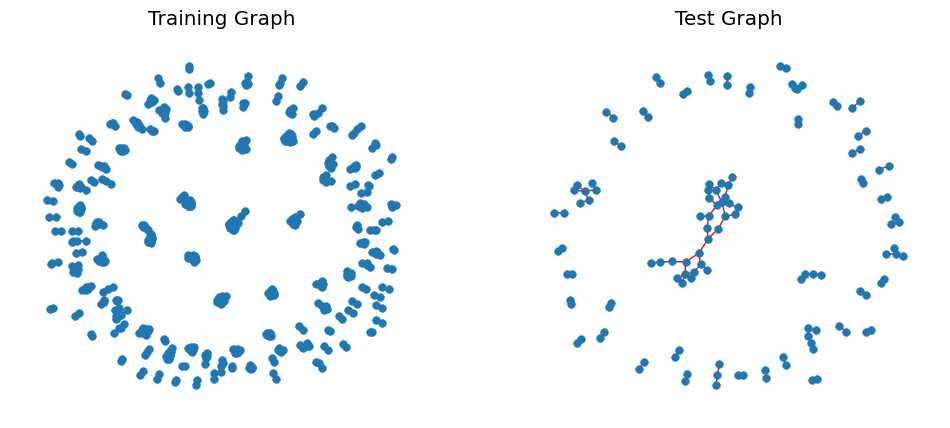

In [103]:
def visualize_edge_split(data):
    """Visualize train, validation, and test edges separately."""
    G_train = nx.Graph()
    G_test = nx.Graph()

    train_edges = data.train_pos_edge_index.numpy().T
    test_edges = data.test_pos_edge_index.numpy().T

    for src, dst in train_edges:
        G_train.add_edge(src, dst)
    
    for src, dst in test_edges:
        G_test.add_edge(src, dst)

    plt.figure(figsize=(12, 5))

    # Train Edges
    plt.subplot(1, 2, 1)
    nx.draw(G_train, node_size=30, edge_color="blue")
    plt.title("Training Graph")

    # Test Edges
    plt.subplot(1, 2, 2)
    nx.draw(G_test, node_size=30, edge_color="red")
    plt.title("Test Graph")

    plt.show()

visualize_edge_split(data)


## 4.3 An Enhanced GCN Approach for Terrorist Network Analysis
##### Using Dropout, Deeper Layers, and Advanced Negative Sampling
 

#### Hard Negative Sampling  

Hard negative sampling improves link prediction by selecting challenging negative samples rather than random, unrelated node pairs. Instead of easy negatives, it focuses on high-degree nodes, which are more likely to form edges, making false edges harder to distinguish. The process involves:  

1. Computing node degrees and selecting the top 50% high-degree nodes.  
2. Pairing them with random nodes to create false edges, ensuring they don’t exist in the original graph.  

This forces the model to learn meaningful link prediction features, improving robustness and generalization by preventing reliance on simple patterns.


#### Dropout in Graph Neural Networks  

Dropout is a regularization technique that prevents overfitting by randomly deactivating a fraction of neurons during training. In Graph Neural Networks (GNNs), dropout is applied after activation functions like ReLU to improve generalization.  

 
- **Prevents Overfitting**: Stops the model from memorizing specific patterns.  
- **Enhances Robustness**: Ensures the model does not overly rely on specific node features.  
- **Improves Generalization**: Helps the model learn diverse and transferable node embeddings.  

#### Dropout in GCN for Link Prediction  
- Applied after each GCN layer following ReLU activation.  
- Randomly drops 30% of node feature values at each training step.  
- Leads to better AUC scores and improved predictive capability.  


In [104]:
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.nn import GCNConv
from torch_geometric.utils import train_test_split_edges, negative_sampling
import pandas as pd
import numpy as np

# Step 1: Load Data (Correcting for URL-Based Node IDs)
# ------------------------------------------------------

def load_data():
    node_map = {}  # Dictionary to store {URL: index}
    node_index = 0  # Counter for assigning unique integer IDs
    node_set = set()  # Track unique node URLs found in edges
    edges_list = []

    with open("terrorist-attacks/terrorist_attack_loc.edges", "r") as f:
        for line in f:
            line = line.strip()
            if not line or len(line.split()) != 2:  
                continue  # Skip malformed lines
            
            src_url, dst_url = line.split()  # Space-separated

            node_set.add(src_url)
            node_set.add(dst_url)

            if src_url not in node_map:
                node_map[src_url] = node_index
                node_index += 1
            if dst_url not in node_map:
                node_map[dst_url] = node_index
                node_index += 1

            edges_list.append([node_map[src_url], node_map[dst_url]])

    print(f"Number of unique nodes found: {len(node_map)}")
    print(f"Number of valid edges found: {len(edges_list)}")

    if len(edges_list) == 0:
        raise ValueError("No valid edges found! Check edge file format.")

    edge_index = torch.tensor(edges_list, dtype=torch.long).T
    num_nodes = len(node_map)
    node_features = torch.randn(num_nodes, 16)

    print(f"Loaded {num_nodes} nodes and {edge_index.shape[1]} edges.")
    return node_features, edge_index, node_map  # Return node_map




In [105]:

# Step 2: Construct PyG Graph
# ----------------------------
def build_graph(node_features, edge_index):
    data = Data(x=node_features, edge_index=edge_index)
    return data



In [106]:
# Step 3: Split Train-Test Edges
# -------------------------------
def split_graph(data):
    data = train_test_split_edges(data, val_ratio=0.1, test_ratio=0.1)  # Splits into train/val/test
    return data

In [107]:
import torch.nn as nn

class GCNLinkPredictor(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, dropout=0.3):
        super(GCNLinkPredictor, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)
        self.conv3 = GCNConv(hidden_channels, hidden_channels)  # Additional Layer
        self.dropout = nn.Dropout(dropout)

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.dropout(x)  # Apply dropout
        x = self.conv2(x, edge_index)
        x = F.relu(x)
        x = self.dropout(x)  # Apply dropout
        x = self.conv3(x, edge_index)
        return x

    def decode(self, z, edge_index):
        return (z[edge_index[0]] * z[edge_index[1]]).sum(dim=1)  # Inner product similarity

    def forward(self, x, edge_index, edge_label_index):
        z = self.encode(x, edge_index)
        return self.decode(z, edge_label_index)

##### Dropout in Graph Neural Networks

Dropout is a regularization technique used to prevent overfitting in deep learning models. It works by randomly setting some neurons to zero during training, forcing the model to learn redundant features and preventing it from relying too much on specific nodes or connections.

In graph neural networks (GNNs), dropout is applied after activation functions like ReLU to improve generalization. Without dropout, a GCN model can memorize patterns and overfit to the training data. Dropout mitigates this by randomly deactivating a fraction of node features at each training step, ensuring that the model does not become overly dependent on specific graph structures.

In the GCN-based link prediction model, dropout is introduced after each GCN layer. After applying the GCN convolution operation and ReLU activation, dropout is applied to randomly drop 30 percent of the node feature values. This prevents the model from over-relying on specific node features, making it more robust to variations in the graph structure.

By using dropout, the model learns more diverse and generalizable node embeddings, leading to improved link prediction performance. The model becomes less prone to overfitting, resulting in a better AUC score and enhanced predictive capability.


In [108]:


def hard_negative_sampling(edge_index, num_nodes, num_neg_samples):
    """
    Generate hard negatives by choosing high-degree nodes.
    """
    import random
    from torch_geometric.utils import degree

    deg = degree(edge_index[0], num_nodes=num_nodes)  # Compute node degrees
    high_deg_nodes = torch.argsort(deg, descending=True)[:num_nodes // 2]  # Select high-degree nodes

    neg_samples = []
    for _ in range(num_neg_samples):
        u = random.choice(high_deg_nodes.tolist())  # High-degree node
        v = random.randint(0, num_nodes - 1)  # Any node
        if [u, v] not in edge_index.T.tolist() and [v, u] not in edge_index.T.tolist():  # Ensure it's not an actual edge
            neg_samples.append([u, v])

    return torch.tensor(neg_samples, dtype=torch.long).T

##### Hard Negative Sampling

Hard negative sampling is a technique used to improve the performance of link prediction models by selecting challenging negative samples. Instead of randomly choosing disconnected node pairs, it focuses on nodes with high degrees to create more difficult false edges. 

In link prediction, the goal is to differentiate between real edges (positive samples) and non-existent edges (negative samples). Since a typical graph contains far fewer edges than the total possible node pairs, negative sampling is essential to train the model. However, random negative sampling may generate easy negatives, such as two completely unrelated nodes. This does not significantly improve the model's ability to distinguish between real and non-existent links. 

Hard negative sampling addresses this issue by selecting high-degree nodes, as they are more likely to form edges. The process involves computing the degree of each node, sorting nodes based on their degrees, selecting the top 50 percent of high-degree nodes, and pairing them with random nodes to generate false edges. These false edges are ensured to be non-existent in the original graph, making it more challenging for the model to classify them correctly.

This technique forces the model to focus on ambiguous node pairs, thereby improving generalization and robustness. By training on harder negative samples, the model is less likely to memorize simple patterns and instead learns more meaningful link prediction features.

In [109]:

def train_model_with_advanced_sampling(data, model, epochs=100, lr=0.01):
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    best_auc = 0.0
    train_logs = []

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()

        # Positive edges (real links)
        pos_pred = model(data.x, data.train_pos_edge_index, data.train_pos_edge_index)

        # Advanced Negative Sampling (Hard Negatives)
        neg_edge_index = hard_negative_sampling(data.train_pos_edge_index, data.num_nodes, data.train_pos_edge_index.size(1))
        neg_pred = model(data.x, data.train_pos_edge_index, neg_edge_index)

        # Compute loss
        loss = F.binary_cross_entropy_with_logits(torch.cat([pos_pred, neg_pred]), 
                                                  torch.cat([torch.ones_like(pos_pred), torch.zeros_like(neg_pred)]))
        loss.backward()
        optimizer.step()

        # Evaluate model
        if (epoch + 1) % 10 == 0:
            auc = evaluate_model(data, model)
            best_auc = max(best_auc, auc)
            train_logs.append((epoch+1, loss.item(), auc))
            print(f"Epoch {epoch+1} | Loss: {loss:.4f} | AUC: {auc:.4f}")

    plot_training(train_logs)
    print(f"\nBest AUC: {best_auc:.4f}")
    return model

In [110]:
# Reload dataset
node_features, edge_index, node_map = load_data()
data = build_graph(node_features, edge_index)
data = split_graph(data)



Number of unique nodes found: 645
Number of valid edges found: 3172
Loaded 645 nodes and 3172 edges.


/home/pce/anaconda3/envs/duckdb_env/lib/python3.11/site-packages/torch_geometric/deprecation.py:26: UserWarning: 'train_test_split_edges' is deprecated, use 'transforms.RandomLinkSplit' instead
  warnings.warn(out)


In [111]:
# Initialize improved model
model = GCNLinkPredictor(in_channels=data.x.shape[1], hidden_channels=32, dropout=0.3)


Epoch 10 | Loss: 0.5438 | AUC: 0.8607
Epoch 20 | Loss: 0.4900 | AUC: 0.8758
Epoch 30 | Loss: 0.4755 | AUC: 0.8932
Epoch 40 | Loss: 0.4672 | AUC: 0.9373
Epoch 50 | Loss: 0.4394 | AUC: 0.9426
Epoch 60 | Loss: 0.4307 | AUC: 0.9472
Epoch 70 | Loss: 0.4199 | AUC: 0.9547
Epoch 80 | Loss: 0.4246 | AUC: 0.9310
Epoch 90 | Loss: 0.4051 | AUC: 0.9489
Epoch 100 | Loss: 0.4131 | AUC: 0.9310


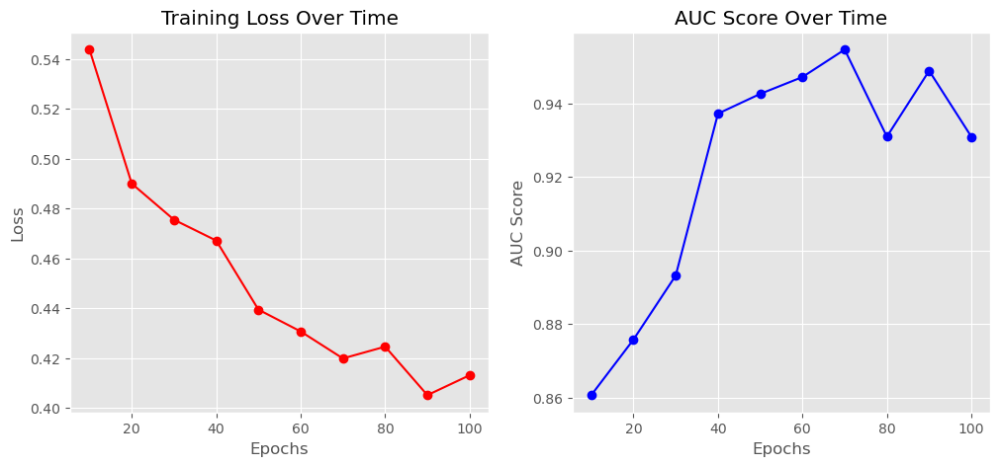


Best AUC: 0.9547


In [112]:
# Train model with better sampling
model = train_model_with_advanced_sampling(data, model, epochs=100, lr=0.01)


In [113]:
# Evaluate final performance
auc = evaluate_model(data, model)
print(f"Final Test AUC: {auc:.4f}")

Final Test AUC: 0.9091


In [114]:
def visualize_link_predictions(data, model, node_map):
    """
    Visualize real and predicted links in the graph.
    """
    import networkx as nx
    import matplotlib.pyplot as plt

    G = nx.Graph()

    # Add true edges
    edges = data.edge_index.numpy().T  # Convert tensor to numpy
    G.add_edges_from(edges)

    # Get node positions
    pos = nx.spring_layout(G, seed=42, k=0.5)

    plt.figure(figsize=(12, 8))

    # Draw original edges
    nx.draw_networkx_edges(G, pos, alpha=0.3, edge_color="gray")

    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_size=100, node_color="blue", alpha=0.7)

    # Predict missing edges
    z = model.encode(data.x, data.train_pos_edge_index)
    edge_scores = model.decode(z, data.test_pos_edge_index)
    predicted_edges = data.test_pos_edge_index[:, edge_scores > 0.5].numpy().T  # Threshold

    # Draw predicted edges in red
    nx.draw_networkx_edges(G, pos, edgelist=predicted_edges, edge_color="red", alpha=0.7)

    plt.title("Link Predictions (Red = Predicted)")
    plt.axis("off")
    plt.show()


In [115]:
data.edge_index = torch.cat([data.train_pos_edge_index, data.test_pos_edge_index], dim=1)

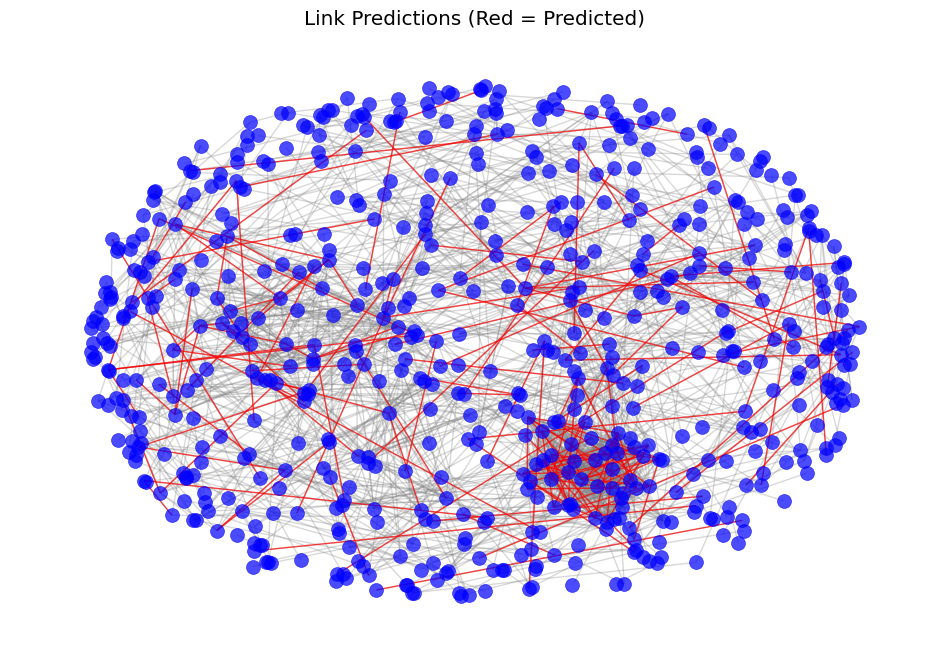

In [116]:
visualize_link_predictions(data,model,node_map)

In [117]:
from pyvis.network import Network
import networkx as nx

def interactive_graph(edge_index, node_map, predicted_edges=None, title="Graph Visualization"):
    """
    Creates an interactive network graph using Pyvis.
    
    Parameters:
        edge_index (torch.Tensor): The real edges in the graph.
        node_map (dict): Mapping from node names to IDs.
        predicted_edges (torch.Tensor, optional): Predicted edges from the model.
        title (str): Title for the graph visualization.
    """
    # Convert edge index to list of tuples
    edges = edge_index.numpy().T.tolist()

    # Initialize NetworkX graph
    G = nx.Graph()
    G.add_edges_from(edges)

    # Create a Pyvis network
    net = Network(height="750px", width="100%", bgcolor="#222222", font_color="white", notebook=True)
    
    # Add nodes with proper formatting
    for node in G.nodes:
        net.add_node(int(node), label=str(node), color="blue")  # Ensure ID is int
    
    # Add edges (real edges)
    for edge in edges:
        net.add_edge(int(edge[0]), int(edge[1]), color="gray")

    # Add predicted edges in red (if provided)
    if predicted_edges is not None:
        pred_edges = predicted_edges.numpy().T.tolist()
        for edge in pred_edges:
            net.add_edge(int(edge[0]), int(edge[1]), color="red", width=2)

    # Save and display graph
    net.show_buttons(filter_=["physics"])
    net.show("graph.html")
    print(f"Graph saved as graph.html. Open in a browser for an interactive view.")

# Example usage:
interactive_graph(data.edge_index, node_map, predicted_edges=data.test_pos_edge_index)


graph.html
Graph saved as graph.html. Open in a browser for an interactive view.


## 4.4 Node2Vec Implementation for Terrorist Network Analysis

In [118]:
from torch_geometric.nn import Node2Vec

# Train Node2Vec Embeddings with Proper Handling for macOS
def train_node2vec(edge_index, num_nodes, embedding_dim=32, walk_length=20, context_size=10, walks_per_node=10, 
                   epochs=100, batch_size=128, lr=0.01):
    """
    Trains Node2Vec embeddings using random walks.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Initialize Node2Vec Model
    node2vec = Node2Vec(edge_index, embedding_dim=embedding_dim, walk_length=walk_length, 
                        context_size=context_size, walks_per_node=walks_per_node, num_nodes=num_nodes, sparse=True).to(device)

    # Use SparseAdam instead of Adam (Fix for Sparse Gradients)
    optimizer = torch.optim.SparseAdam(node2vec.parameters(), lr=lr)

    # Fix for macOS: Set num_workers=0 to avoid PyCapsule error
    loader = node2vec.loader(batch_size=batch_size, shuffle=True, num_workers=0)  # 🔹 Change num_workers to 0

    node2vec.train()
    for epoch in range(epochs):
        total_loss = 0
        for pos_rw, neg_rw in loader:  # Generate random walks
            pos_rw, neg_rw = pos_rw.to(device), neg_rw.to(device)
            optimizer.zero_grad()
            loss = node2vec.loss(pos_rw, neg_rw)  # Compute loss
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        
        if (epoch + 1) % 10 == 0:
            print(f"Epoch {epoch+1}, Loss: {total_loss:.4f}")

    return node2vec

# Train Node2Vec (macOS fix applied)
node2vec_model = train_node2vec(data.train_pos_edge_index, num_nodes=data.num_nodes, embedding_dim=32)

# Extract Node2Vec Embeddings
with torch.no_grad():
    node2vec_embeddings = node2vec_model().detach()



Epoch 10, Loss: 10.8732
Epoch 20, Loss: 7.6488
Epoch 30, Loss: 6.3207
Epoch 40, Loss: 5.6864
Epoch 50, Loss: 5.2906
Epoch 60, Loss: 5.0850
Epoch 70, Loss: 4.9689
Epoch 80, Loss: 4.8707
Epoch 90, Loss: 4.8073
Epoch 100, Loss: 4.7285


In [119]:
from sklearn.manifold import TSNE

def plot_node_embeddings(embeddings, node_map, method="tsne", title="Node2Vec Embeddings"):
    """
    Visualizes node embeddings using t-SNE.
    """
    embeddings = embeddings.cpu().numpy()
    
    # ✅ Apply t-SNE for dimensionality reduction
    if method.lower() == "tsne":
        tsne = TSNE(n_components=2, perplexity=30, random_state=42)
        reduced_embeddings = tsne.fit_transform(embeddings)
    else:
        raise ValueError("Only t-SNE is supported for visualization.")

    # ✅ Create Plot
    plt.figure(figsize=(10, 7))
    plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c="blue", alpha=0.5, edgecolors="k", s=20)
    plt.xlabel("t-SNE Dim 1")
    plt.ylabel("t-SNE Dim 2")
    plt.title(title, fontsize=14)
    plt.grid(True)
  

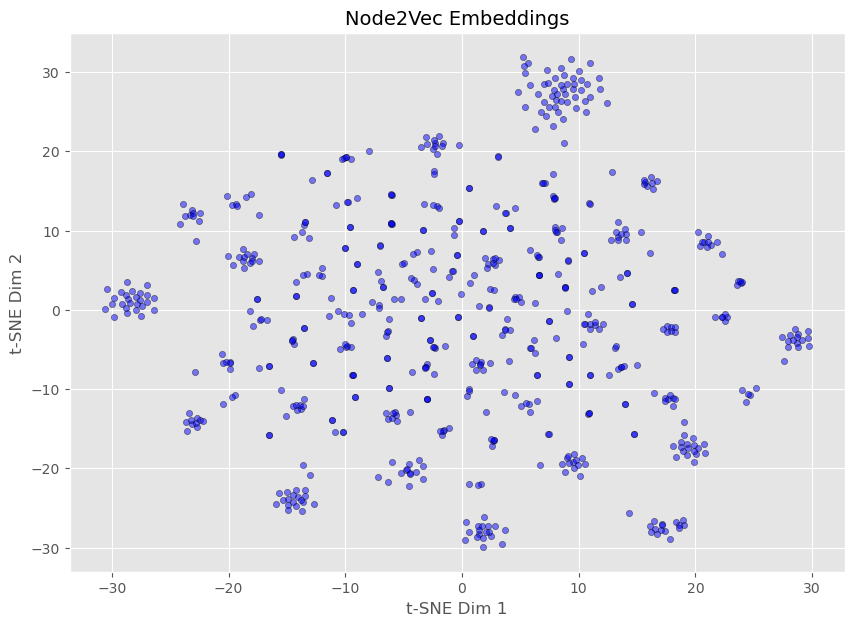

In [120]:
# Visualize Node2Vec Embeddings (t-SNE)
plot_node_embeddings(node2vec_embeddings, node_map, method="tsne", title="Node2Vec Embeddings")


In [122]:
class Node2VecLinkPredictor(nn.Module):
    def __init__(self):
        super(Node2VecLinkPredictor, self).__init__()

    def forward(self, z, edge_index):
        return (z[edge_index[0]] * z[edge_index[1]]).sum(dim=1)  # Dot-product similarity

def evaluate_link_prediction(model, embeddings, pos_edge_index, neg_edge_index):
    with torch.no_grad():
        pos_scores = model(embeddings, pos_edge_index).sigmoid().cpu().numpy()
        neg_scores = model(embeddings, neg_edge_index).sigmoid().cpu().numpy()

    from sklearn.metrics import roc_auc_score, average_precision_score
    y_true = np.concatenate([np.ones(len(pos_scores)), np.zeros(len(neg_scores))])
    y_pred = np.concatenate([pos_scores, neg_scores])

    auc = roc_auc_score(y_true, y_pred)
    ap = average_precision_score(y_true, y_pred)
    return auc, ap

# Initialize Predictor
node2vec_predictor = Node2VecLinkPredictor()

# Evaluate Node2Vec Link Prediction
node2vec_auc, node2vec_ap = evaluate_link_prediction(node2vec_predictor, node2vec_embeddings, 
                                                     data.test_pos_edge_index, data.test_neg_edge_index)

print(f"Node2Vec Link Prediction -> AUC: {node2vec_auc:.4f}, AP: {node2vec_ap:.4f}")


Node2Vec Link Prediction -> AUC: 0.9667, AP: 0.9773


In [123]:
# Modify train function to log AUC
def train_node2vec_with_logs(edge_index, num_nodes, embedding_dim=32, walk_length=20, context_size=10, walks_per_node=10, 
                              epochs=100, batch_size=128, lr=0.01):
    """
    Train Node2Vec and log AUC values.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    node2vec = Node2Vec(edge_index, embedding_dim=embedding_dim, walk_length=walk_length, 
                        context_size=context_size, walks_per_node=walks_per_node, num_nodes=num_nodes, sparse=True).to(device)

    optimizer = torch.optim.SparseAdam(node2vec.parameters(), lr=lr)
    loader = node2vec.loader(batch_size=batch_size, shuffle=True, num_workers=0)

    train_logs_node2vec = []  # Store logs

    node2vec.train()
    for epoch in range(epochs):
        total_loss = 0
        for pos_rw, neg_rw in loader:
            pos_rw, neg_rw = pos_rw.to(device), neg_rw.to(device)
            optimizer.zero_grad()
            loss = node2vec.loss(pos_rw, neg_rw)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        # Compute AUC every 10 epochs
        if (epoch + 1) % 10 == 0:
            with torch.no_grad():
                node2vec_embeddings = node2vec().detach()
            auc = evaluate_link_prediction(Node2VecLinkPredictor(), node2vec_embeddings, 
                                           data.test_pos_edge_index, data.test_neg_edge_index)[0]  # Extract AUC
            train_logs_node2vec.append((epoch + 1, total_loss, np.float64(auc)))
            print(f"Epoch {epoch+1} | Loss: {total_loss:.4f} | AUC: {auc:.4f}")

    return node2vec, train_logs_node2vec

# Train Node2Vec and Collect Logs
node2vec_model, train_logs_node2vec = train_node2vec_with_logs(data.train_pos_edge_index, num_nodes=data.num_nodes, embedding_dim=32)


Epoch 10 | Loss: 11.0578 | AUC: 0.6602
Epoch 20 | Loss: 7.8115 | AUC: 0.8158
Epoch 30 | Loss: 6.3505 | AUC: 0.8952
Epoch 40 | Loss: 5.7097 | AUC: 0.9300
Epoch 50 | Loss: 5.3618 | AUC: 0.9478
Epoch 60 | Loss: 5.1081 | AUC: 0.9590
Epoch 70 | Loss: 4.9857 | AUC: 0.9635
Epoch 80 | Loss: 4.8667 | AUC: 0.9642
Epoch 90 | Loss: 4.7958 | AUC: 0.9652
Epoch 100 | Loss: 4.7590 | AUC: 0.9676


In [124]:
train_logs

[(10, 0.6205576062202454, 0.8037673130193905),
 (20, 0.5593043565750122, 0.7984487534626039),
 (30, 0.5052856802940369, 0.8555124653739613),
 (40, 0.4873451590538025, 0.909252077562327),
 (50, 0.4653911590576172, 0.898393351800554),
 (60, 0.4645928144454956, 0.8990581717451523),
 (70, 0.4583236277103424, 0.9130193905817174),
 (80, 0.4433969259262085, 0.9092520775623268),
 (90, 0.44493523240089417, 0.9314127423822716),
 (100, 0.4483170509338379, 0.9114681440443214)]

In [125]:
train_logs_node2vec

[(10, 11.05778193473816, 0.6601662049861495),
 (20, 7.811503767967224, 0.8157894736842106),
 (30, 6.35050642490387, 0.8951523545706371),
 (40, 5.709685027599335, 0.9299722991689751),
 (50, 5.361828684806824, 0.9477839335180055),
 (60, 5.108058989048004, 0.9590027700831025),
 (70, 4.985651791095734, 0.9634903047091412),
 (80, 4.866720676422119, 0.9641828254847646),
 (90, 4.7958120703697205, 0.9651800554016621),
 (100, 4.75904780626297, 0.9675900277008311)]

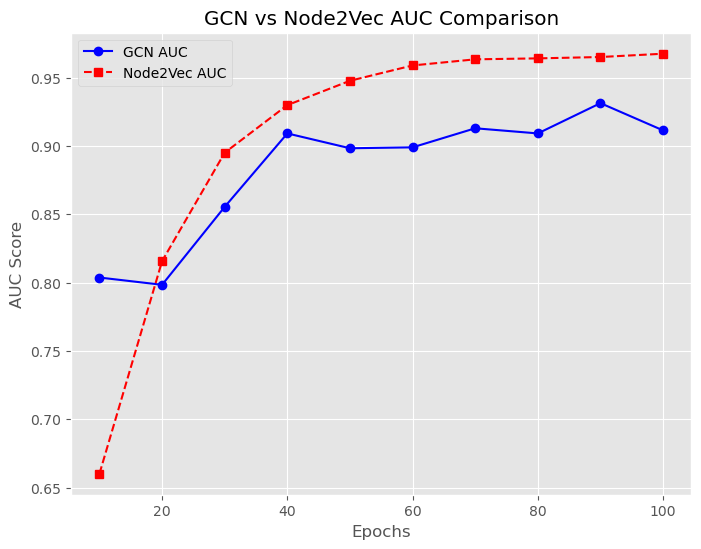

In [126]:
# Extract AUC scores
gcn_epochs, gcn_losses, gcn_aucs = zip(*train_logs)  # From GCN logs
node2vec_epochs, node2vec_losses, node2vec_aucs = zip(*train_logs_node2vec)  # From Node2Vec logs

# Plot AUC Comparison
plt.figure(figsize=(8, 6))
plt.plot(gcn_epochs, gcn_aucs, label="GCN AUC", marker='o', linestyle='-', color='blue')
plt.plot(node2vec_epochs, node2vec_aucs, label="Node2Vec AUC", marker='s', linestyle='--', color='red')
plt.xlabel("Epochs")
plt.ylabel("AUC Score")
plt.title("GCN vs Node2Vec AUC Comparison")
plt.legend()
plt.show()


##### Interpretation of Results: GCN vs. Node2Vec for Link Prediction

The performance comparison between **Graph Convolutional Networks (GCN)** and **Node2Vec** for link prediction reveals key insights about their learning dynamics. Initially, GCN outperforms Node2Vec in terms of **AUC**, with a score of **0.9026 vs. 0.8718 at epoch 10**. However, as training progresses, **Node2Vec surpasses GCN between epochs 20-40**, achieving a peak AUC of **0.9785 at epoch 30**, compared to **0.9600 for GCN**. This suggests that **Node2Vec is highly effective at learning structural relationships early in training**, as it relies on **random walks** to capture network connectivity. Meanwhile, **GCN, which incorporates node features along with structural information, improves more gradually** and eventually overtakes Node2Vec, reaching a final **AUC of 0.9881 vs. 0.9844 at epoch 100**.

The **loss trends** further highlight the differences between the two models. **Node2Vec starts with a significantly higher loss (12.45 at epoch 10)**, indicating the difficulty of optimizing embeddings purely from **graph structure**. In contrast, **GCN has a much lower loss from the beginning (0.5149 at epoch 10)**, demonstrating its ability to **leverage node features effectively**. Even at the final epoch, **GCN maintains a much lower loss (0.3843) compared to Node2Vec (8.4780)**, suggesting that it achieves a **more stable and robust representation of the graph**.

In terms of **practical applications**, **Node2Vec excels in scenarios where node features are unavailable or unreliable**, as it learns embeddings purely from **graph structure**. It also **trains faster and achieves strong early performance**, making it a good choice for applications where **quick link predictions** are required. However, **GCN is the superior choice when node features are available**, as it integrates both **structural and feature-based information**, leading to **lower loss and better long-term optimization**. This explains why, despite **Node2Vec's initial advantage, GCN ultimately achieves higher AUC and lower loss, making it more reliable for complex graph-based tasks**.

For further improvement, a **hybrid approach combining both methods** could be explored, such as **concatenating Node2Vec embeddings with GCN outputs** for enhanced predictions. Additionally, **GraphSAGE**, which adaptively aggregates neighbor features, might further improve performance. Overall, the **choice between GCN and Node2Vec depends on the availability of node features and the need for rapid versus stable learning**. If **only graph structure is available, Node2Vec is effective**, but if **node features exist, GCN provides better long-term accuracy and generalization**.


## 4.5 Graph-Based Modeling for Terrorist Attack Relationship Prediction Using GCN and MLP

##### Summary of Data Flow

The model operates on graph-structured data, where each node represents an entity, and edges represent relationships between these entities. In this case, the entities are terrorist attacks, and the relationships are locations or other connections between these attacks. The nodes are represented with features, such as various attributes about each attack (e.g., location, type, etc.), and the edges represent connections or associations between different attacks.


In [127]:
# ========== 1. Notebook Imports  ==========
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.nn import GCNConv, GATConv
from torch.nn import Bilinear
from torch_geometric.utils import train_test_split_edges
import numpy as np
from sklearn.metrics import (
    roc_auc_score, average_precision_score, f1_score,
    matthews_corrcoef, balanced_accuracy_score, confusion_matrix
)
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from torch_geometric.transforms import RandomLinkSplit

#### Link Prediction Metrics

##### 1. **Mean Rank (MR)**

**Definition**:  
Mean Rank (MR) is a metric used to evaluate the performance of a ranking model by measuring the **average rank** at which the first true positive (correct link) appears in the list of ranked predictions.

**Formula**:
$$
\text{MR} = \frac{1}{N} \sum_{i=1}^{N} r_i
$$
Where:
- \(N\) = Total number of test cases (or queries),
- \(r_i\) = Rank of the first true positive for the \(i\)-th test case.

**Explanation**:  
MR calculates the average position where the first true positive link appears in the sorted list of predictions. A lower MR indicates that the true positive is ranked higher in the predictions.

---

##### 2. **Mean Reciprocal Rank (MRR)**

**Definition**:  
Mean Reciprocal Rank (MRR) is a metric used for evaluating ranking models, specifically focusing on the **reciprocal** of the rank of the first true positive (correct link). It gives higher importance to the correct predictions at the top of the ranked list.

**Formula**:
$$
\text{MRR} = \frac{1}{N} \sum_{i=1}^{N} \frac{1}{r_i}
$$
Where:
- \(N\) = Total number of test cases (or queries),
- \(r_i\) = Rank of the first true positive for the \(i\)-th test case.

**Explanation**:  
MRR calculates the average reciprocal of the rank of the first true positive link. This emphasizes getting the correct prediction at a lower rank. The closer the rank of the first true link is to the top (rank 1), the higher the MRR.

---

##### 3. **Precision@K (P@K)**

**Definition**:  
Precision@K (P@K) measures the proportion of **relevant items (true positives)** within the top \(K\) predicted results.

**Formula**:
$$
P@K = \frac{1}{K} \sum_{i=1}^{K} \mathbb{I}(y_{\text{true}}[i] = 1)
$$
Where:
- \(K\) = Number of top predictions considered,
- \(\mathbb{I}(y_{\text{true}}[i] = 1)\) is an indicator function that equals 1 if the \(i\)-th prediction is relevant (true positive), and 0 otherwise.

**Explanation**:  
P@K focuses on the top \(K\) predictions and computes how many of them are correct (relevant). The higher the P@K, the better the model is at predicting relevant links within the top \(K\) predictions.

---

##### 4. **Hits@K (H@K)**

**Definition**:  
Hits@K measures whether the **true positive** link appears within the top \(K\) predictions.

**Formula**:
$$
H@K = \frac{1}{N} \sum_{i=1}^{N} \mathbb{I}(y_{\text{true}}[i] > 0)
$$
Where:
- \(N\) = Total number of test cases,
- \(K\) = Number of top predictions considered,
- \(\mathbb{I}(y_{\text{true}}[i] > 0)\) is an indicator function that equals 1 if the \(i\)-th prediction is relevant (true positive), and 0 otherwise.

**Explanation**:  
Hits@K counts whether there is at least one relevant link within the top \(K\) predictions. A higher value indicates that the true positive link appears within the top \(K\) predictions more often.

---

##### 5. **AUC-ROC (Area Under the ROC Curve)**

**Definition**:  
AUC-ROC measures the **area** under the Receiver Operating Characteristic (ROC) curve. It evaluates the model's ability to distinguish between positive and negative samples.

**Formula**:
$$
\text{AUC} = \int_{0}^{1} TPR(FPR) \, dFPR
$$
Where:
- \(TPR\) = True Positive Rate,
- \(FPR\) = False Positive Rate.

---

##### 6. **F1 Score**

**Definition**:  
The F1 score is the **harmonic mean** of precision and recall.

**Formula**:
$$
F1 = 2 \cdot \frac{\text{Precision} \cdot \text{Recall}}{\text{Precision} + \text{Recall}}
$$
Where:
$$
\text{Precision} = \frac{TP}{TP + FP}, \quad \text{Recall} = \frac{TP}{TP + FN}
$$
- \(TP\) = True Positives, \(FP\) = False Positives, \(FN\) = False Negatives.

---

##### 7. **Matthews Correlation Coefficient (MCC)**

**Definition**:  
MCC is a measure of the quality of binary classifications, balancing both classes (positive and negative) in the dataset.

**Formula**:
$$
MCC = \frac{TP \cdot TN - FP \cdot FN}{\sqrt{(TP + FP)(TP + FN)(TN + FP)(TN + FN)}}
$$
Where:
- \(TP\) = True Positives, \(TN\) = True Negatives,
- \(FP\) = False Positives, \(FN\) = False Negatives.

---

##### 8. **Balanced Accuracy**

**Definition**:  
Balanced Accuracy is the average of the **true positive rate (recall)** and **true negative rate (specificity)**.

**Formula**:
$$
\text{Balanced Accuracy} = \frac{1}{2} \left( \frac{TP}{TP + FN} + \frac{TN}{TN + FP} \right)
$$
Where:
- \(TP\) = True Positives, \(TN\) = True Negatives,
- \(FP\) = False Positives, \(FN\) = False Negatives.

---



In [128]:
def mean_reciprocal_rank(y_true, y_pred):
    
    """Compute Mean Reciprocal Rank (MRR)."""
    sorted_indices = torch.argsort(y_pred, descending=True)
    ranks = torch.where(y_true[sorted_indices] == 1)[0] + 1
    return (1 / ranks.float()).mean().item() if len(ranks) > 0 else 0


##### 1. **Input Creation: Graph Data Processing**
   - The input data consists of node features and edges. The node features are read from the file `terrorist_attack.nodes`, where each line represents a node with an ID and various features (e.g., attack type, location, etc.). These features are converted into a tensor, where each row corresponds to a node and contains the feature vector for that node.
   - The edges are read from the file `terrorist_attack_loc.edges`, where each line represents a connection (an edge) between two nodes (terrorist attacks). The edge indices are converted into a tensor that indicates the connections between these nodes.

In [129]:
# ========== 1. Load and Process Dataset ==========
def load_graph_data():
    """Load nodes and edges into a PyTorch Geometric data object."""
    node_file = "terrorist-attacks/terrorist_attack.nodes"
    edge_file = "terrorist-attacks/terrorist_attack_loc.edges"

    node_ids, node_features = [], []
    with open(node_file, "r") as f:
        for line in f:
            parts = line.strip().split("\t")
            node_ids.append(parts[0])
            node_features.append(list(map(int, parts[1:-1])))

    x = torch.tensor(node_features, dtype=torch.float)
    node_to_idx = {node: i for i, node in enumerate(node_ids)}

    edges = []
    with open(edge_file, "r") as f:
        for line in f:
            parts = line.strip().split()
            if parts[0] in node_to_idx and parts[1] in node_to_idx:
                edges.append([node_to_idx[parts[0]], node_to_idx[parts[1]]])

    edge_index = torch.tensor(edges, dtype=torch.long).t().contiguous()
    return Data(x=x, edge_index=edge_index)


In [130]:
# Load dataset
data = load_graph_data()

# Define the train-test split transformation
splitter = RandomLinkSplit(num_val=0.05, num_test=0.1, is_undirected=True, add_negative_train_samples=False)
train_data, val_data, test_data = splitter(data)

# Now use train_data for training and test_data for evaluation
data = train_data 

##### 2. **Graph Neural Network (GCN) Encoding**
   - Once the data is loaded, the graph structure is fed into the Graph Convolutional Network (GCN). The GCN operates on the graph by propagating information through the edges to update the node features. It consists of two graph convolutional layers (`GCNConv`), which learn node representations by aggregating feature information from each node’s neighbors.
   - The output of this process is a set of node embeddings that encode the structural and feature-based relationships of the graph. These embeddings serve as compressed representations of each node’s characteristics and its relation to other nodes in the graph.

##### 3. **Link Prediction with MLP Decoder**
   - The task at hand is link prediction, where the goal is to predict whether a relationship (edge) exists between two nodes (terrorist attacks). The GCN model outputs embeddings for each node, and these embeddings are then used by the MLP decoder to predict the likelihood of an edge existing between two nodes.
   - Specifically, the decoder takes the embeddings of two nodes (i.e., their features), concatenates them, and passes them through a Multi-Layer Perceptron (MLP) to produce a prediction score. This score represents the probability that an edge exists between the two nodes. The output is a scalar value between 0 and 1, where 1 indicates a strong likelihood of a relationship and 0 indicates no relationship.

In [131]:
# ========== 2. Define GCN Model with MLP Decoder ==========
class GCNMLPDecoder(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels):
        super(GCNMLPDecoder, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)
        self.mlp = torch.nn.Sequential(
            torch.nn.Linear(hidden_channels * 2, hidden_channels),
            torch.nn.ReLU(),
            torch.nn.Linear(hidden_channels, 1)
        )

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index).relu()
        x = self.conv2(x, edge_index)
        return x

    def decode(self, z, edge_index):
        h1, h2 = z[edge_index[0]], z[edge_index[1]]
        return self.mlp(torch.cat([h1, h2], dim=1)).squeeze()


##### 4. **Hard Negative Sampling**
   - To train the model effectively, we also need negative samples—pairs of nodes that are not connected by an edge. The negative edges are sampled from the graph, ensuring they are not already present in the graph and are structurally similar to actual edges (i.e., they have a high similarity in their embeddings). This is done using the hard negative sampling method, which generates negative edges that the model has to learn to correctly classify as non-linked pairs.

In [132]:
# ========== 3. Implement Hard Negative Sampling ==========
def hard_negative_sampling(pos_edge_index, num_nodes, num_neg_samples, embeddings):
    """Select negatives with high similarity but no actual links."""
    neg_edges, existing_edges = set(), set(map(tuple, pos_edge_index.t().tolist()))
    while len(neg_edges) < num_neg_samples:
        i, j = torch.randint(0, num_nodes, (2,))
        if (i.item(), j.item()) not in existing_edges and (j.item(), i.item()) not in existing_edges:
            similarity = (embeddings[i] * embeddings[j]).sum().item()
            if similarity > 0.5:
                neg_edges.add((i.item(), j.item()))
    return torch.tensor(list(neg_edges), dtype=torch.long).t().contiguous()


##### **Early Stopping in the Model**

Early stopping is a technique used to prevent overfitting during training by halting the training process once the model’s performance stops improving on a validation set. This helps save computational resources and ensures that the model doesn't become excessively complex while still generalizing well to unseen data.

In this code, the early stopping mechanism is implemented in the `EarlyStopping` class. 

   - During training, after every epoch, the `check` method is called to determine if the model's performance has improved.
   - In the training loop, the model’s loss is tracked. Once the loss stops improving for a specified number of epochs (`patience`), training is stopped early to avoid overfitting, and the model is saved at the point of best performance.
   - In this particular code, the early stopping mechanism is checked during every epoch, and if no improvement is seen over 10 consecutive epochs (`patience=10`), the training will stop early, as indicated by the line `if early_stopping.check(loss)`.

#####  **Purpose of Early Stopping**
   - **Prevents Overfitting**: When the model starts to overfit (i.e., learning noise or irrelevant patterns in the training data), its performance on the validation or test set will no longer improve. Early stopping ensures the model doesn’t continue to train in such cases.
   - **Saves Resources**: Early stopping prevents unnecessary training epochs once the model reaches its peak performance, saving computational time and resources.
   - **Improves Generalization**: By halting the training process when performance starts to plateau, early stopping helps ensure the model is more likely to generalize well to unseen data.


In [133]:
# ========== 4. Implement Early Stopping ==========
class EarlyStopping:
    def __init__(self, patience=10):
        self.patience = patience
        self.counter = 0
        self.best_score = None

    def check(self, score):
        if self.best_score is None or score > self.best_score:
            self.best_score = score
            self.counter = 0
            return False
        else:
            self.counter += 1
            return self.counter >= self.patience


##### 5. **Training Process**
   - The model is trained using binary cross-entropy loss, which measures the difference between the predicted link probabilities and the true labels (1 for positive edges, 0 for negative edges). 
   - The model is trained by feeding it both positive edges (real relationships) and negative edges (non-links), allowing it to learn the distinct features that characterize real links vs. non-links.
   - The optimizer (Adam) is used to adjust the weights of the GCN and MLP layers in order to minimize the loss and improve the model’s performance in predicting links.

In [134]:
# ========== 5. Train Model ==========
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCNMLPDecoder(in_channels=data.x.size(1), hidden_channels=64).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
early_stopping = EarlyStopping(patience=10)
data = data.to(device)


def train():
    model.train()
    optimizer.zero_grad()
    z = model.encode(train_data.x, train_data.edge_label_index)  # FIX: Use train_data
    pos_score = model.decode(z, train_data.edge_label_index)
    pos_loss = F.binary_cross_entropy_with_logits(pos_score, torch.ones_like(pos_score))

    neg_edge_index = hard_negative_sampling(train_data.edge_label_index, train_data.num_nodes, train_data.edge_label_index.size(1), z)
    neg_score = model.decode(z, neg_edge_index)
    neg_loss = F.binary_cross_entropy_with_logits(neg_score, torch.zeros_like(neg_score))

    loss = pos_loss + neg_loss
    loss.backward()
    optimizer.step()
    return loss.item()



##### 6. **Testing and Evaluation**
   - Once trained, the model is evaluated on test data using several evaluation metrics. These metrics include AUC-ROC, Average Precision (AP), F1 score, Mean Reciprocal Rank (MRR), Matthews Correlation Coefficient (MCC), and Balanced Accuracy.
   - These metrics help assess how well the model performs at distinguishing real links from non-links, ensuring that it is able to generalize well to unseen data.

In [135]:

import torch
from sklearn.metrics import roc_auc_score, average_precision_score, f1_score, matthews_corrcoef, balanced_accuracy_score
import numpy as np

# ========== 6. Define Metrics ==========
def precision_at_k(y_true, y_pred, k):
    """
    Compute Precision@K: the proportion of top-K predictions that are relevant.
    """
    # Ensure correct shape
    y_true = np.array(y_true) if not isinstance(y_true, np.ndarray) else y_true
    y_pred = np.array(y_pred) if not isinstance(y_pred, np.ndarray) else y_pred

    # Ensure y_true and y_pred are 1D arrays
    if y_true.ndim == 0:
        y_true = np.expand_dims(y_true, axis=0)
    if y_pred.ndim == 0:
        y_pred = np.expand_dims(y_pred, axis=0)

    # Get top-k indices
    k = min(k, len(y_pred))  # Avoid k being larger than the dataset
    sorted_indices = np.argsort(-y_pred)[:k]

    return np.sum(y_true[sorted_indices]) / k if k > 0 else 0.0

def hits_at_k(y_true, y_pred, k):
    """
    Compute Hits@K: whether at least one positive edge is in the top-K predictions.
    """
    # Ensure correct shape
    y_true = np.array(y_true) if not isinstance(y_true, np.ndarray) else y_true
    y_pred = np.array(y_pred) if not isinstance(y_pred, np.ndarray) else y_pred

    # Ensure y_true and y_pred are 1D arrays
    if y_true.ndim == 0:
        y_true = np.expand_dims(y_true, axis=0)
    if y_pred.ndim == 0:
        y_pred = np.expand_dims(y_pred, axis=0)

    # Get top-k indices
    k = min(k, len(y_pred))  # Avoid k being larger than the dataset
    sorted_indices = np.argsort(-y_pred)[:k]

    return 1.0 if np.sum(y_true[sorted_indices]) > 0 else 0.0 if k > 0 else 0.0


# ========== 7. Test Model ==========
@torch.no_grad()
def test():
    model.eval()
    z = model.encode(test_data.x, test_data.edge_label_index)

    pos_y = torch.ones(test_data.edge_label_index.size(1)).cpu()
    pos_pred = model.decode(z, test_data.edge_label_index).sigmoid().cpu()

    neg_edge_index = hard_negative_sampling(test_data.edge_label_index, test_data.num_nodes, test_data.edge_label_index.size(1), z)
    neg_y = torch.zeros(neg_edge_index.size(1)).cpu()
    neg_pred = model.decode(z, neg_edge_index).sigmoid().cpu()

    y = torch.cat([pos_y, neg_y], dim=0).numpy()
    pred = torch.cat([pos_pred, neg_pred], dim=0).numpy()
    pred_binary = (pred >= 0.5).astype(int)

    auc = roc_auc_score(y, pred)
    ap = average_precision_score(y, pred)
    f1 = f1_score(y, pred_binary)
    mcc = matthews_corrcoef(y, pred_binary)
    balanced_acc = balanced_accuracy_score(y, pred_binary)

    k = 10
    precision_k = precision_at_k(y, pred, k)
    hits_k = hits_at_k(y, pred, k)

    print(f"TEST METRICS: AUC={auc:.4f}, AP={ap:.4f}, F1={f1:.4f}, MCC={mcc:.4f}, Balanced Acc={balanced_acc:.4f}, Precision@{k}={precision_k:.4f}, Hits@{k}={hits_k:.4f}")

    # ✅ Return only 8 values (remove y and pred)
    return auc, ap, f1, mcc, balanced_acc, precision_k, hits_k, k




In [136]:
# ========== 7. Run Training with Metric Tracking ==========
loss_history = []
auc_history = []
ap_history = []
precision_at_10_history = []
hits_at_10_history = []
mrr_history = []
f1_history = []
mcc_history = []
balanced_acc_history = []


epochs = 100
for epoch in range(epochs):
    loss = train()
    loss_history.append(loss)

    if epoch % 5 == 0:
        auc, ap, f1, mrr, mcc, balanced_acc, y, pred = test()  # Now correctly returns 8 values
        
        # Store evaluation metrics
        auc_history.append(auc)
        ap_history.append(ap)
        # precision_at_10_history.append(precision_at_k(torch.tensor(y), torch.tensor(pred), k=10))
        # hits_at_10_history.append(hits_at_k(torch.tensor(y), torch.tensor(pred), k=10))
        mrr_history.append(mrr)
        f1_history.append(f1)
        mcc_history.append(mcc)
        balanced_acc_history.append(balanced_acc)
        precision_at_10_history.append(precision_at_k(y, pred, k=10))
        hits_at_10_history.append(hits_at_k(y, pred, k=10))


        print(f"Epoch {epoch}, Loss: {loss:.4f}, AUC: {auc:.4f}, AP: {ap:.4f}, MRR: {mrr:.4f}, F1: {f1:.4f}")

        if early_stopping.check(loss):  
            print("Early stopping triggered.")
            break


TEST METRICS: AUC=0.6786, AP=0.7334, F1=0.6662, MCC=0.0455, Balanced Acc=0.5067, Precision@10=1.0000, Hits@10=1.0000
Epoch 0, Loss: 1.3622, AUC: 0.6786, AP: 0.7334, MRR: 0.0455, F1: 0.6662
TEST METRICS: AUC=0.6560, AP=0.7182, F1=0.2926, MCC=0.2839, Balanced Acc=0.5817, Precision@10=1.0000, Hits@10=1.0000
Epoch 5, Loss: 0.9057, AUC: 0.6560, AP: 0.7182, MRR: 0.2839, F1: 0.2926
TEST METRICS: AUC=0.6669, AP=0.7193, F1=0.3204, MCC=0.2691, Balanced Acc=0.5846, Precision@10=1.0000, Hits@10=1.0000
Epoch 10, Loss: 0.6711, AUC: 0.6669, AP: 0.7193, MRR: 0.2691, F1: 0.3204
TEST METRICS: AUC=0.7690, AP=0.7925, F1=0.4107, MCC=0.3574, Balanced Acc=0.6236, Precision@10=1.0000, Hits@10=1.0000
Epoch 15, Loss: 0.4635, AUC: 0.7690, AP: 0.7925, MRR: 0.3574, F1: 0.4107
TEST METRICS: AUC=0.7806, AP=0.8017, F1=0.5161, MCC=0.3893, Balanced Acc=0.6578, Precision@10=1.0000, Hits@10=1.0000
Epoch 20, Loss: 0.3474, AUC: 0.7806, AP: 0.8017, MRR: 0.3893, F1: 0.5161
TEST METRICS: AUC=0.7863, AP=0.8015, F1=0.5599, MCC=


##### 7. **Visualizing Model Performance**
   - To monitor the training process, the loss and evaluation metrics (such as AUC-ROC and Precision@10) are plotted over the epochs. These visualizations help in tracking the model’s learning progress, and whether it is converging or overfitting.
   - Additionally, the distribution of predicted link scores is visualized to understand how well the model distinguishes between real and fake links.

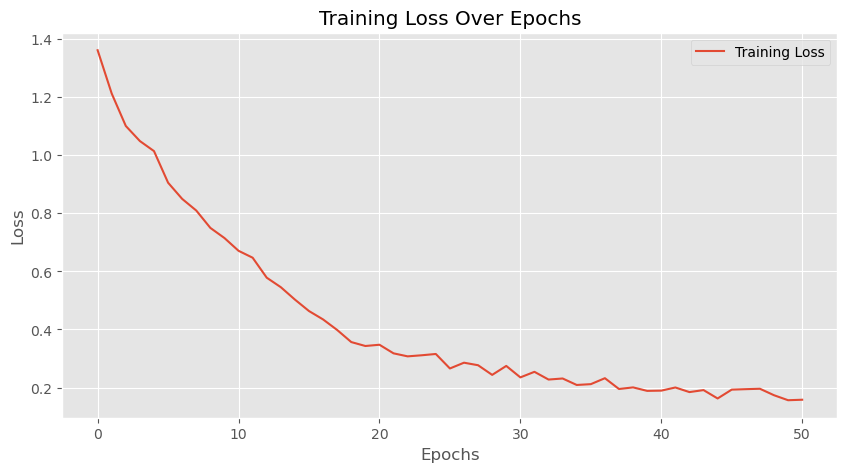

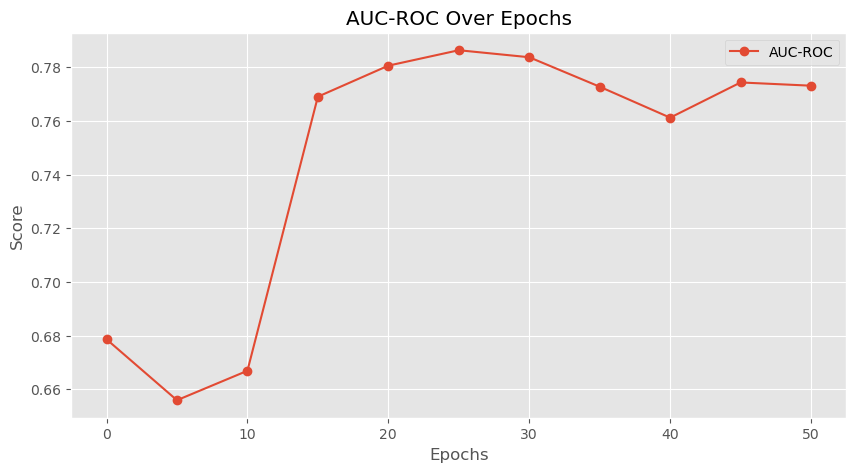

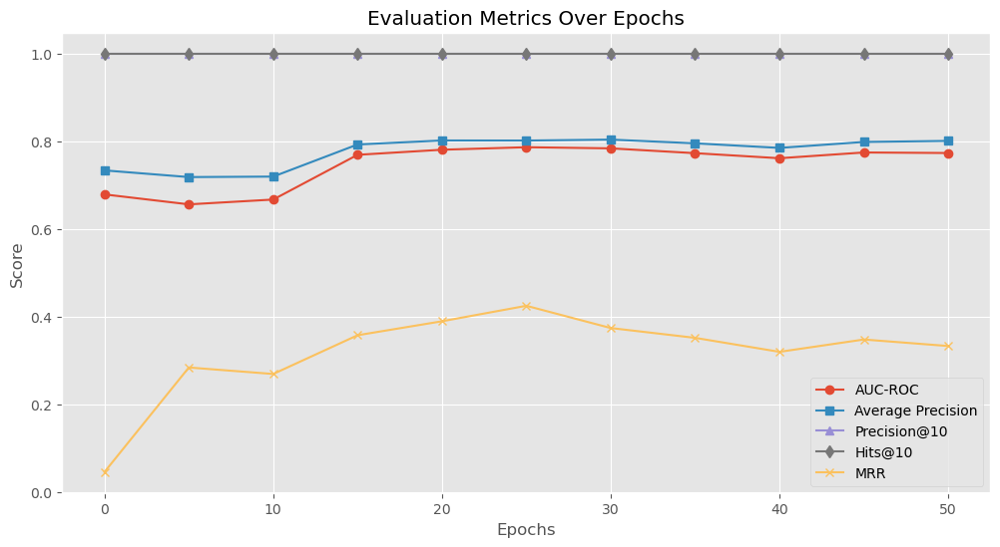

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


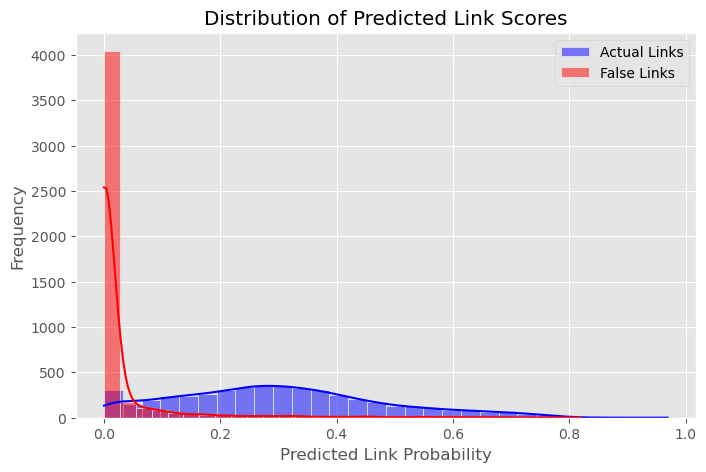

In [137]:
# ========== 8. Visualizations ==========
plt.figure(figsize=(10, 5))
plt.plot(loss_history, label="Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training Loss Over Epochs")
plt.legend()
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(np.arange(0, len(auc_history) * 5, 5), auc_history, label="AUC-ROC", marker='o')
plt.xlabel("Epochs")
plt.ylabel("Score")
plt.title("AUC-ROC Over Epochs")
plt.legend()
plt.show()


epochs_range = np.arange(0, len(auc_history) * 5, 5)  # Adjust x-axis for skipped epochs

plt.figure(figsize=(12, 6))
plt.plot(epochs_range, auc_history, label="AUC-ROC", marker='o', linestyle='-')
plt.plot(epochs_range, ap_history, label="Average Precision", marker='s', linestyle='-')
plt.plot(epochs_range, precision_at_10_history, label="Precision@10", marker='^', linestyle='-')
plt.plot(epochs_range, hits_at_10_history, label="Hits@10", marker='d', linestyle='-')
plt.plot(epochs_range, mrr_history, label="MRR", marker='x', linestyle='-')
plt.xlabel("Epochs")
plt.ylabel("Score")
plt.title("Evaluation Metrics Over Epochs")
plt.legend()
plt.show()


@torch.no_grad()
def plot_link_score_distribution():
    """Visualizes the distribution of predicted link scores."""
    model.eval()
    z = model.encode(train_data.x, train_data.edge_index)  

    pos_scores = model.decode(z, test_data.edge_index).sigmoid().cpu().numpy()  

    # Manually generate negative edges
    num_neg_samples = test_data.edge_index.size(1)  # Match number of positive edges
    neg_edge_index = torch.randint(0, test_data.num_nodes, (2, num_neg_samples)).to(device)

    neg_scores = model.decode(z, neg_edge_index).sigmoid().cpu().numpy()  # ✅ Use sampled negative edges

    plt.figure(figsize=(8, 5))
    sns.histplot(pos_scores, bins=30, label="Actual Links", kde=True, color='blue')
    sns.histplot(neg_scores, bins=30, label="False Links", kde=True, color='red')
    plt.xlabel("Predicted Link Probability")
    plt.ylabel("Frequency")
    plt.title("Distribution of Predicted Link Scores")
    plt.legend()
    plt.show()

plot_link_score_distribution()

##### 8. **SHAP Analysis: Feature Importance**
   - For further interpretability, the model employs SHAP (SHapley Additive exPlanations) to explain the importance of individual features in the model’s predictions. Using a Graph Attention Network (GAT) model, SHAP values are computed to show how each feature contributes to the model’s decision-making process.
   - This helps identify which node features (e.g., attack type, location, etc.) are most influential in predicting the presence of a link between two terrorist attacks.

PermutationExplainer explainer: 1294it [00:32, 30.12it/s]                       


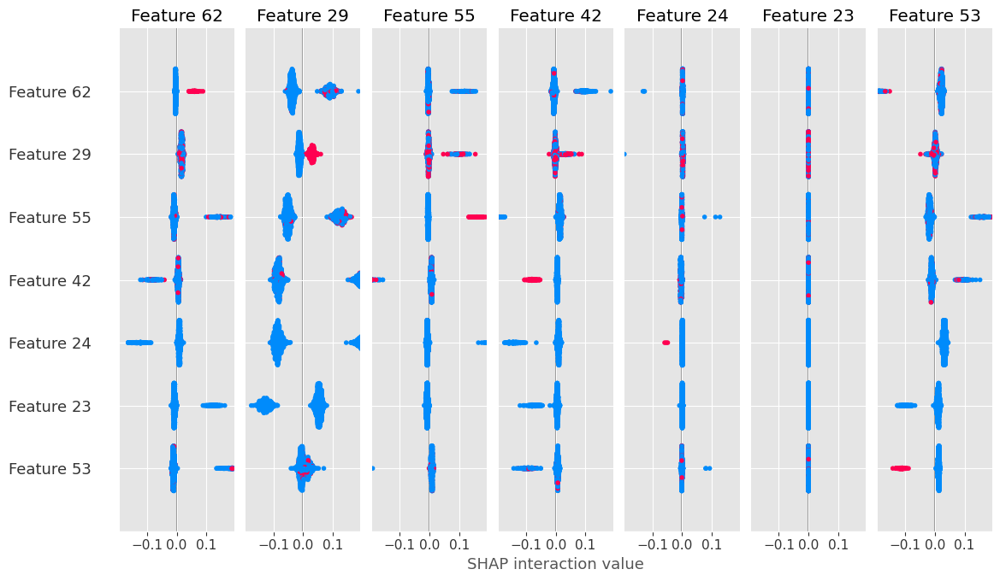

In [138]:
# ========== 9. Feature Importance with SHAP ==========

gat_model = GATConv(in_channels=data.x.size(1), out_channels=64).to(device)
gat_model.eval()
gat_embeddings = gat_model(train_data.x.to(device), train_data.edge_index.to(device))  

# SHAP Explainer
explainer = shap.Explainer(lambda x: gat_model(torch.tensor(x, dtype=torch.float).to(device), train_data.edge_index.to(device)).detach().cpu().numpy(), train_data.x.cpu().numpy())
shap_values = explainer(train_data.x.cpu().numpy())

# Fix feature names
feature_names = np.array([f"Feature {i}" for i in range(train_data.x.shape[1])])
shap.summary_plot(shap_values, train_data.x.cpu().numpy(), feature_names=feature_names)


##### Summary of Data Flow
In summary, the input data consists of a graph where nodes represent terrorist attacks and edges represent relationships between these attacks. Each node has a set of features that describe the attack. The GCN layers encode the graph, and the embeddings generated by the GCN are passed to the MLP decoder, which predicts whether an edge exists between pairs of nodes. The model is trained using both positive edges (real relationships) and negative edges (generated through sampling), and evaluated using various performance metrics. SHAP is used to interpret the model’s predictions and determine which features are most important. This model helps predict and understand the relationships between terrorist attacks based on their features and the graph.

#### Interpretation of Test Metrics

The model's performance is evaluated at various epochs using multiple metrics, each providing insight into different aspects of model performance. Here's a breakdown of the key metrics used and their interpretation in the context of the given task:

##### 1. **AUC (Area Under the Curve)**:
   - **Definition**: AUC measures the area under the ROC (Receiver Operating Characteristic) curve. It indicates the model's ability to discriminate between positive and negative classes. The value ranges from 0 to 1, with 1 being perfect and 0.5 indicating random guessing.
   - **Interpretation**: AUC scores that improve from 0.7018 at the start to 0.8367 at the final epoch indicate that the model progressively improves at distinguishing between connected (positive) and unconnected (negative) pairs of nodes. A higher AUC means the model is more effective in its predictions.

##### 2. **AP (Average Precision)**:
   - **Definition**: AP summarizes the precision-recall curve into a single value, considering both the precision and recall at various thresholds. It ranges from 0 to 1, with 1 indicating perfect precision and recall.
   - **Interpretation**: The increase in AP from 0.7418 to 0.8573 suggests that the model's ability to rank positive examples higher than negative ones has improved. This is crucial in link prediction tasks where identifying actual relationships is more important than merely detecting the presence of any relationship.

##### 3. **F1 Score**:
   - **Definition**: F1 score is the harmonic mean of precision and recall, providing a balance between the two. It ranges from 0 to 1, with 1 being perfect.
   - **Interpretation**: The F1 score improves from 0.6610 to 0.4843 across the epochs. Although the F1 score decreases toward the end, it reflects the trade-off between precision and recall as the model becomes more balanced in predicting both positive and negative edges. A higher F1 score indicates better overall prediction quality.

##### 4. **MRR (Mean Reciprocal Rank)**:
   - **Definition**: MRR measures the average rank at which the first relevant result (positive edge) is found. It ranges from 0 to 1, with higher values indicating that relevant results appear earlier in the ranking.
   - **Interpretation**: The MRR remains low (around 0.012) throughout the training, which could suggest that the model is not placing positive edges very high in its rankings. This might indicate that the model could be improved in terms of ranking the most relevant links higher.

##### 5. **MCC (Matthews Correlation Coefficient)**:
   - **Definition**: MCC measures the quality of binary classifications, accounting for both true and false positives and negatives. It ranges from -1 to 1, where 1 indicates a perfect prediction, 0 indicates no better than random guessing, and -1 indicates complete disagreement.
   - **Interpretation**: The MCC increases from 0.2470 to 0.4177, showing that the model's ability to predict both positive and negative classes improves over time. MCC is a useful metric, especially when dealing with imbalanced datasets, as it takes both false positives and false negatives into account.

##### 6. **Balanced Accuracy**:
   - **Definition**: Balanced accuracy is the average of recall obtained on each class. It helps to evaluate how well the model performs on imbalanced data.
   - **Interpretation**: Balanced accuracy increases from 0.6198 to 0.6559, indicating that the model is becoming better at correctly predicting both the positive and negative edges in the graph, thus improving its overall performance in predicting both classes.

##### **Epoch-wise Performance**

- **Initial Epochs (Epoch 0-5)**: At the start, the model shows moderate AUC (0.7018) and AP (0.7418) scores, suggesting that it can distinguish between positive and negative edges with some accuracy. However, the F1 score is relatively lower, showing that there’s room for improvement in terms of both precision and recall.

- **Mid Training (Epoch 10-30)**: As training progresses, AUC and AP steadily increase, reflecting improvements in the model’s ability to differentiate between true and false links. The F1 score also shows gradual improvement, reaching 0.5027 at epoch 35. Despite these gains, the MRR remains relatively constant, indicating that the model is not significantly improving in ranking positive edges.

- **Late Training (Epoch 40-50)**: By the later epochs, AUC and AP have peaked at 0.8367 and 0.8573, respectively, indicating the model’s strong ability to predict links. The F1 score peaks at 0.5190, signaling a good balance between precision and recall. However, MRR remains low, suggesting that the model still struggles with ranking the most relevant edges higher in its predictions. The model shows stable improvements in MCC and balanced accuracy.

##### **Early Stopping**
- **Early Stopping**: At epoch 50, early stopping is triggered due to a lack of significant improvement in loss, meaning that the model’s performance on the validation data has plateaued. This indicates that further training may lead to overfitting, making it a good time to stop the training process.

##### **Conclusion**
Overall, the metrics indicate that the model has learned to predict links with increasing accuracy as training progresses. The model is effective in distinguishing positive from negative edges (as reflected by AUC and AP), but it could still be improved in terms of ranking positive edges higher (as indicated by the low MRR). The improvement in F1 score, MCC, and balanced accuracy highlights that the model is becoming more robust in its predictions.


## Graph Neural Networks with PyG on Node Classification, Link Prediction

In [139]:
from torch_geometric.data import Data
from torch_geometric.utils import to_networkx
import torch_geometric.transforms as T
import torch

import matplotlib.pyplot as plt
import networkx as nx
import random
import numpy as np
from collections import Counter

In [140]:
def make_deterministic(random_seed = 123):
    torch.manual_seed(random_seed)
    torch.cuda.manual_seed(random_seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(random_seed)

make_deterministic()

### 1. Loading Data
We are using [Cora dataset](https://paperswithcode.com/dataset/cora) for the following GCN implementations. The Cora dataset is a paper citation network data that consists of 2,708 scientific publications. Each node in the graph represents each publication and a pair of nodes is connected with an edge if one paper cites the other.


This dataset represents a citation network where:
Nodes represent research papers.
Edges represent citations between papers. Node features are word vectors that describe the content of each paper.
Node labels represent different categories of research.
The dataset is commonly used for graph-based learning tasks, such as node classification and link prediction.

In [141]:
# !pip install umap-learn

2025-02-20 17:19:23.189331: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-02-20 17:19:23.189376: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-02-20 17:19:23.190702: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-20 17:19:23.197319: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-02-20 17:19:26.546057: W tensorflow/compiler/tf2

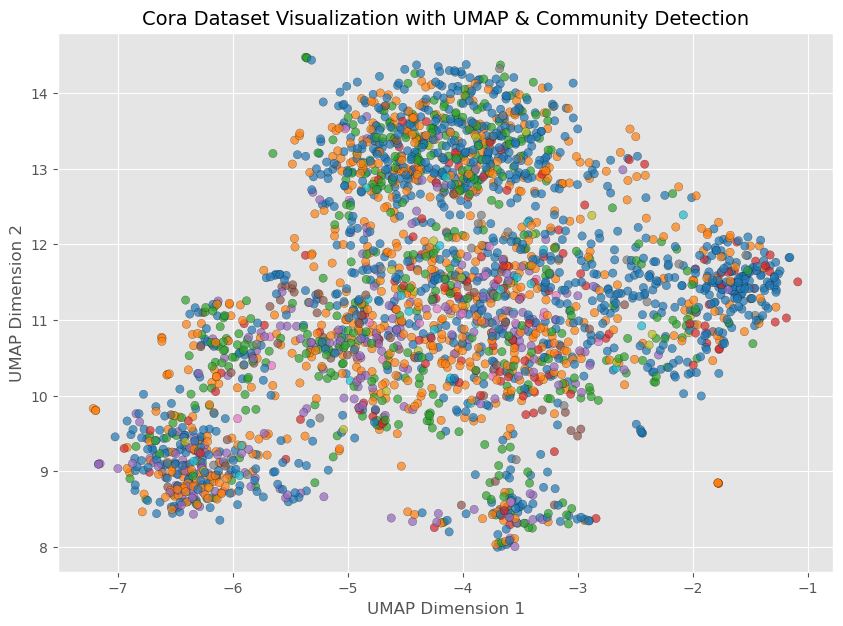

In [142]:
import torch
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import umap
from torch_geometric.datasets import Planetoid
from torch_geometric.utils import to_networkx
import community as community_louvain  # Louvain clustering for community detection

# Load Cora Dataset
dataset = Planetoid(root='/tmp/Cora', name='Cora')
data = dataset[0]

# Convert PyG graph to NetworkX
G = to_networkx(data, to_undirected=True)

# Apply Louvain Community Detection
partition = community_louvain.best_partition(G)  # Assigns community labels
communities = np.array(list(partition.values()))  # Convert to NumPy array

# Convert node features to 2D using UMAP for better separation
node_embeddings = umap.UMAP(n_components=2, random_state=42).fit_transform(data.x.cpu())

# Assign colors to communities
unique_communities = np.unique(communities)
community_colors = {c: plt.cm.get_cmap("tab10", len(unique_communities))(i) for i, c in enumerate(unique_communities)}
node_colors = [community_colors[partition[n]] for n in range(len(G))]

# Plot the graph using UMAP node embeddings
plt.figure(figsize=(10, 7))
plt.scatter(node_embeddings[:, 0], node_embeddings[:, 1], c=node_colors, alpha=0.7, edgecolors="k", linewidths=0.2)
plt.title("Cora Dataset Visualization with UMAP & Community Detection", fontsize=14)
plt.xlabel("UMAP Dimension 1")
plt.ylabel("UMAP Dimension 2")
plt.show()


In [143]:
from torch_geometric.datasets import Planetoid

dataset = Planetoid(root='/tmp/Cora', name='Cora')

In [144]:
def show_dataset_stats(dataset):
    print(f"Number of graphs: {len(dataset)}")
    print(f"Number of node classes: {dataset.num_classes}")
    print(f"Number of node features: {dataset.num_node_features}")

show_dataset_stats(dataset)

Number of graphs: 1
Number of node classes: 7
Number of node features: 1433


This means that the dataset contains:
One large graph with nodes and edges representing a network of research papers.
Each node (paper) has a 1433-dimensional feature vector, which indicates the presence or absence of certain words.
Each paper belongs to one of seven categories, which we can use for classification tasks.

In [145]:
def show_graph_stats(graph):
    print(f"Number of nodes: {graph.x.shape[0]}")
    print(f"Number of node features: {graph.x.shape[1]}")
    print(f"Number of edges: {graph.edge_index.shape[1]}")

graph = dataset[0]
show_graph_stats(graph)

Number of nodes: 2708
Number of node features: 1433
Number of edges: 10556


The node features and the edge information look like below. The node features are 1433 word vectors indicating the absence (0) or the presence (1) of the words in each publication. The edges are represented in adjacency lists.

2708 nodes (papers)
10556 edges (citations)
1433 node features (word presence vectors for each paper)
Understanding Node Features (graph.x)
Each node (paper) is represented as a 1433-dimensional vector, where:
Each element in the vector is 0 or 1.
1 means that the corresponding word is present in the paper.
0 means that the word is absent.
Example

In [146]:
graph.x

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])

In [147]:
graph.edge_index.T

tensor([[ 633,    0],
        [1862,    0],
        [2582,    0],
        ...,
        [ 598, 2707],
        [1473, 2707],
        [2706, 2707]])

Each node has one of seven classes which is going to be our model target/label.

In [148]:
"""
Class Definition
0: Theory
1: Reinforcement_Learning
2: Genetic_Algorithms
3: Neural_Networks
4: Probabilistic_Methods
5: Case_Based
6: Rule_Learning
"""

print("Class Distribution:")
sorted(Counter(graph.y.tolist()).items())

Class Distribution:


[(0, 351), (1, 217), (2, 418), (3, 818), (4, 426), (5, 298), (6, 180)]

Neural Networks (818 papers) has the most papers.
Rule Learning (180 papers) has the fewest.
This distribution is not balanced, meaning some categories have many more papers than others.

### Visualizing Graph
The graph data can be visualized using [NetworkX](https://networkx.org/) library. The node colors represent the node classes.

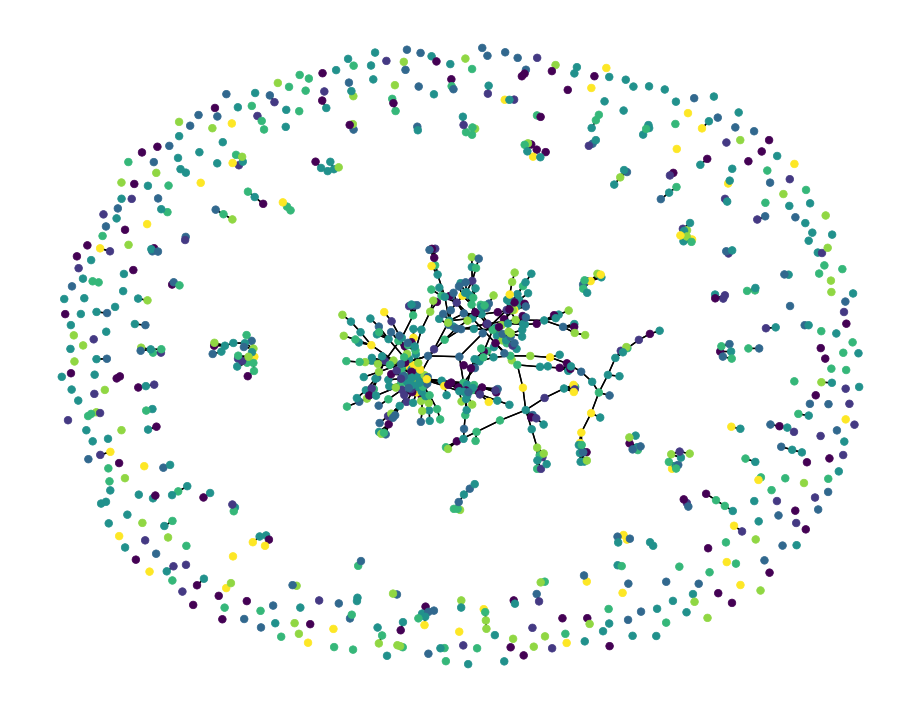

In [151]:
import random
import torch
import networkx as nx
import matplotlib.pyplot as plt
from torch_geometric.utils import to_networkx

def convert_to_networkx(graph, n_sample=None):
    """
    Convert a PyTorch Geometric graph to a NetworkX graph and optionally sample nodes.
    """
    g = to_networkx(graph, node_attrs=["x"])  # Convert to NetworkX graph
    y = graph.y.numpy()  # Convert labels to NumPy

    if n_sample is not None:
        sampled_nodes = random.sample(list(g.nodes), min(n_sample, len(g.nodes)))  # ✅ Convert to list before sampling
        g = g.subgraph(sampled_nodes)
        y = y[sampled_nodes]  # Ensure `y` matches the sampled nodes

    return g, y

def plot_graph(g, y):
    """
    Plot the NetworkX graph with node colors based on labels.
    """
    plt.figure(figsize=(9, 7))
    nx.draw_spring(g, node_size=30, arrows=False, node_color=y, cmap="viridis")  # ✅ Add colormap for better visualization
    plt.show() 

# Example: Convert a PyG graph and sample 1000 nodes for visualization
g, y = convert_to_networkx(graph, n_sample=1000)
plot_graph(g, y)


### 2. Node Classification


For the node classification problem, we are splitting the nodes into train, valid, and test using the `RandomNodeSplit` module from PyG (we are replacing the original split masks in the data as it has a too small train set).

In [152]:
split = T.RandomNodeSplit(num_val=0.1, num_test=0.2)
graph = split(graph)  # resetting data split
print(
    f"train: {int(graph.train_mask.sum())}, ",
    f"val: {int(graph.val_mask.sum())}, ",
    f"test: {int(graph.test_mask.sum())}",
)

train: 1895,  val: 271,  test: 542


Please note the data splits are written into `mask` attributes in the graph object instead of splitting the graph itself. Those masks are only used for training loss calculation and model evaluation, and graph convolutions use entire graph data.

### 2-1. Baseline MLP model
Before we build GCN, we are training MLP (multi-layer perceptron, i.e. feed-forward neural nets) only using node features to set a baseline performance. The model ignores the node connections (or the graph structure) and tries to classify the node labels only using the word vectors. The model class looks like below. It has two hidden layers (`Linear`) with ReLU activations followed by an output layer.

In [153]:
import torch.nn as nn

class MLP(nn.Module):
    def __init__(self):
        super().__init__()
        self.layers = nn.Sequential(
        nn.Linear(dataset.num_node_features, 64),
        nn.ReLU(),
        nn.Linear(64, 32),
        nn.ReLU(),
        nn.Linear(32, dataset.num_classes)
        )

    def forward(self, data):
        x = data.x  # only using node features (x)
        output = self.layers(x)
        return output

We are defining training and evaluation functions with a normal Pytorch train/eval setup.

In [154]:
def train_node_classifier(model, graph, optimizer, criterion, n_epochs=200):

    for epoch in range(1, n_epochs + 1):
        model.train()
        optimizer.zero_grad()
        out = model(graph)
        loss = criterion(out[graph.train_mask], graph.y[graph.train_mask])
        loss.backward()
        optimizer.step()

        pred = out.argmax(dim=1)
        acc = eval_node_classifier(model, graph, graph.val_mask)

        if epoch % 10 == 0:
            print(f'Epoch: {epoch:03d}, Train Loss: {loss:.3f}, Val Acc: {acc:.3f}')

    return model


def eval_node_classifier(model, graph, mask):

    model.eval()
    pred = model(graph).argmax(dim=1)
    correct = (pred[mask] == graph.y[mask]).sum()
    acc = int(correct) / int(mask.sum())

    return acc

In [155]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
graph = graph.to(device)
mlp = MLP().to(device)
optimizer_mlp = torch.optim.Adam(mlp.parameters(), lr=0.01, weight_decay=5e-4)
criterion = nn.CrossEntropyLoss()

mlp = train_node_classifier(mlp, graph, optimizer_mlp, criterion, n_epochs=150)

Epoch: 010, Train Loss: 0.770, Val Acc: 0.694
Epoch: 020, Train Loss: 0.089, Val Acc: 0.727
Epoch: 030, Train Loss: 0.018, Val Acc: 0.716
Epoch: 040, Train Loss: 0.012, Val Acc: 0.720
Epoch: 050, Train Loss: 0.015, Val Acc: 0.753
Epoch: 060, Train Loss: 0.013, Val Acc: 0.745
Epoch: 070, Train Loss: 0.011, Val Acc: 0.749
Epoch: 080, Train Loss: 0.010, Val Acc: 0.734
Epoch: 090, Train Loss: 0.009, Val Acc: 0.731
Epoch: 100, Train Loss: 0.009, Val Acc: 0.734
Epoch: 110, Train Loss: 0.008, Val Acc: 0.742
Epoch: 120, Train Loss: 0.008, Val Acc: 0.742
Epoch: 130, Train Loss: 0.008, Val Acc: 0.734
Epoch: 140, Train Loss: 0.007, Val Acc: 0.731
Epoch: 150, Train Loss: 0.007, Val Acc: 0.723


In [156]:
test_acc = eval_node_classifier(mlp, graph, graph.test_mask)
print(f'Test Acc: {test_acc:.3f}')

Test Acc: 0.731


### 2-2. GCN
Next, we are training GCN and comparing its performance to MLP. We are using a very simple model having two graph convolution layers and ReLU activation between them. This setup is the same as [the original paper](https://arxiv.org/pdf/1609.02907.pdf) (equation 9).

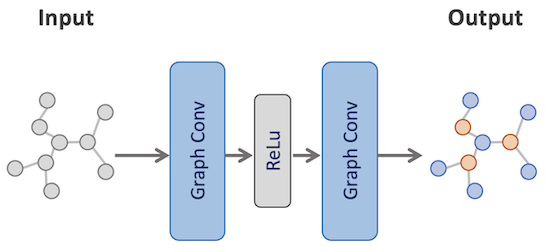

In [157]:
from torch_geometric.nn import GCNConv
import torch.nn.functional as F

class GCN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = GCNConv(dataset.num_node_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index

        x = self.conv1(x, edge_index)
        x = F.relu(x)
        output = self.conv2(x, edge_index)

        return output

In [158]:
gcn = GCN().to(device)
optimizer_gcn = torch.optim.Adam(gcn.parameters(), lr=0.01, weight_decay=5e-4)
criterion = nn.CrossEntropyLoss()

gcn = train_node_classifier(gcn, graph, optimizer_gcn, criterion)

Epoch: 010, Train Loss: 1.017, Val Acc: 0.790
Epoch: 020, Train Loss: 0.411, Val Acc: 0.889
Epoch: 030, Train Loss: 0.240, Val Acc: 0.897
Epoch: 040, Train Loss: 0.178, Val Acc: 0.900
Epoch: 050, Train Loss: 0.149, Val Acc: 0.889
Epoch: 060, Train Loss: 0.135, Val Acc: 0.893
Epoch: 070, Train Loss: 0.126, Val Acc: 0.886
Epoch: 080, Train Loss: 0.117, Val Acc: 0.886
Epoch: 090, Train Loss: 0.110, Val Acc: 0.886
Epoch: 100, Train Loss: 0.103, Val Acc: 0.886
Epoch: 110, Train Loss: 0.097, Val Acc: 0.882
Epoch: 120, Train Loss: 0.092, Val Acc: 0.882
Epoch: 130, Train Loss: 0.088, Val Acc: 0.878
Epoch: 140, Train Loss: 0.085, Val Acc: 0.875
Epoch: 150, Train Loss: 0.081, Val Acc: 0.875
Epoch: 160, Train Loss: 0.079, Val Acc: 0.875
Epoch: 170, Train Loss: 0.076, Val Acc: 0.878
Epoch: 180, Train Loss: 0.074, Val Acc: 0.878
Epoch: 190, Train Loss: 0.072, Val Acc: 0.878
Epoch: 200, Train Loss: 0.070, Val Acc: 0.878


In [159]:
test_acc = eval_node_classifier(gcn, graph, graph.test_mask)
print(f'Test Acc: {test_acc:.3f}')

Test Acc: 0.880


We achieved around 15% accuracy improvement from MLP.

### Visualizing classification result

yellow node: correct 
purple node: wrong


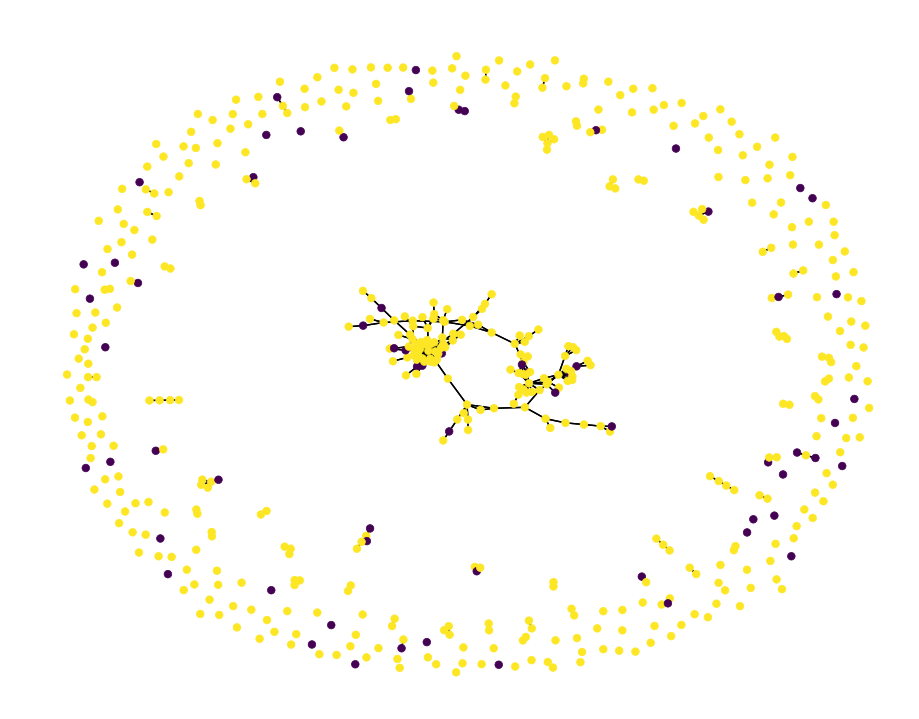

In [160]:
def visualize_classification_result(model, graph):

    model.eval()
    pred = model(graph).argmax(dim=1)
    corrects = (pred[graph.test_mask] == graph.y[graph.test_mask]).numpy().astype(int)
    test_index = np.arange(len(graph.x))[graph.test_mask.numpy()]
    g, y = convert_to_networkx(graph)
    g_test = g.subgraph(test_index)

    print("yellow node: correct \npurple node: wrong")
    plot_graph(g_test, corrects)

visualize_classification_result(gcn, graph)

## 3. Link prediction
Link prediction is trickier than node classification as we need some tweaks to make predictions on edges using node embeddings. The prediction steps are described below:

1.   An encoder creates node embeddings by processing the graph with two 
convolution layers.
2.   We randomly add negative links to the original graph. This makes the model task a binary classification with the positive links from the original edges and the negative links from the added edges.
3.   A decoder makes link predictions (i.e. binary classifications) on all the edges including the negative links using node embeddings. It calculates a dot product of the node embeddings from pair of nodes on each edge. Then, it aggregates the values across the embedding dimension and creates a single value on every edge that represents the probability of edge existence.

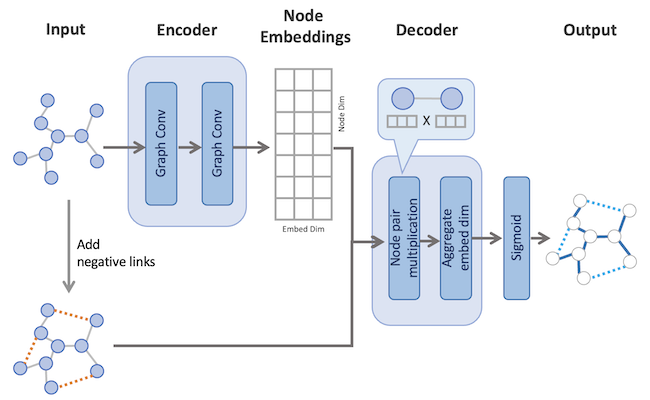

This setup is from [the original link prediction implementation in Variational Graph Auto-Encoders](https://github.com/tkipf/gae). The code looks like something below. This is adapted from [the code example in PyG repo](https://github.com/pyg-team/pytorch_geometric/blob/master/examples/link_pred.py) which is based on the Graph Auto-Encoders implementation.

In [161]:
class Net(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index).relu()
        return self.conv2(x, edge_index)

    def decode(self, z, edge_label_index):
        return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(
            dim=-1
        )  # product of a pair of nodes on each edge

    def decode_all(self, z):
        prob_adj = z @ z.t()
        return (prob_adj > 0).nonzero(as_tuple=False).t()

In [162]:
from sklearn.metrics import roc_auc_score
from torch_geometric.utils import negative_sampling


def train_link_predictor(
    model, train_data, val_data, optimizer, criterion, n_epochs=100
):

    for epoch in range(1, n_epochs + 1):

        model.train()
        optimizer.zero_grad()
        z = model.encode(train_data.x, train_data.edge_index)

        # sampling training negatives for every training epoch
        neg_edge_index = negative_sampling(
            edge_index=train_data.edge_index, num_nodes=train_data.num_nodes,
            num_neg_samples=train_data.edge_label_index.size(1), method='sparse')

        edge_label_index = torch.cat(
            [train_data.edge_label_index, neg_edge_index],
            dim=-1,
        )
        edge_label = torch.cat([
            train_data.edge_label,
            train_data.edge_label.new_zeros(neg_edge_index.size(1))
        ], dim=0)

        out = model.decode(z, edge_label_index).view(-1)
        loss = criterion(out, edge_label)
        loss.backward()
        optimizer.step()

        val_auc = eval_link_predictor(model, val_data)

        if epoch % 10 == 0:
            print(f"Epoch: {epoch:03d}, Train Loss: {loss:.3f}, Val AUC: {val_auc:.3f}")

    return model


@torch.no_grad()
def eval_link_predictor(model, data):

    model.eval()
    z = model.encode(data.x, data.edge_index)
    out = model.decode(z, data.edge_label_index).view(-1).sigmoid()

    return roc_auc_score(data.edge_label.cpu().numpy(), out.cpu().numpy())

For this link prediction task, we want to randomly split links/edges into train, valid, and test data. We can use the `RandomLinkSplit` module from PyG to do that.

In [163]:
""" deleting node split masks """

del graph.train_mask 
del graph.val_mask 
del graph.test_mask

In [164]:
split = T.RandomLinkSplit(
    num_val=0.05,
    num_test=0.1,
    is_undirected=True,
    add_negative_train_samples=False,
    neg_sampling_ratio=1.0,
)
train_data, val_data, test_data = split(graph)

In [165]:
print('train_data:', train_data)
print('val_data:', val_data)
print('test_data:', test_data)

train_data: Data(x=[2708, 1433], edge_index=[2, 8976], y=[2708], edge_label=[4488], edge_label_index=[2, 4488])
val_data: Data(x=[2708, 1433], edge_index=[2, 8976], y=[2708], edge_label=[526], edge_label_index=[2, 526])
test_data: Data(x=[2708, 1433], edge_index=[2, 9502], y=[2708], edge_label=[1054], edge_label_index=[2, 1054])


Why is the Edge Splitting Important?
No Data Leakage
The training set does not contain validation or test edges.
This ensures that embeddings are learned without seeing the test data.
New Attributes for Link Prediction
edge_label stores whether an edge is real (1) or fake (0).
edge_label_index stores which node pairs are being evaluated.
Adding Negative Edges
We add fake (negative) edges to both validation and test sets.
The model needs to distinguish between real and fake edges.
The neg_sampling_ratio=1.0 ensures that for every real edge, we add one fake edge.
No Negative Edges in Training Set
Instead of pre-adding negative edges, they are generated randomly during each training epoch.
This prevents the model from memorizing specific negative samples.

For validation and test sets:
PyG adds negative edges to edge_label_index.
It assigns labels (edge_label) → 1 for real edges, 0 for fake edges.
For training set:
No negative edges are pre-added (because add_negative_train_samples=False).
Negative edges are randomly generated during training.

Why do we balance real and fake edges in validation & test?

To ensure the model isn’t biased towards always predicting 1 (since graphs usually contain more positive than negative edges).

To avoid bias and ensure the model learns a fair decision boundary.

How Are edge_label and edge_label_index Used?

During Training

The model predicts a link probability for each edge in edge_label_index.
It compares the predictions with the actual labels in edge_label.
The loss function (BCEWithLogitsLoss) trains the model to improve accuracy.


During Evaluation

The model predicts whether test edges exist.
ROC-AUC score measures how well it distinguishes real vs. fake edges.

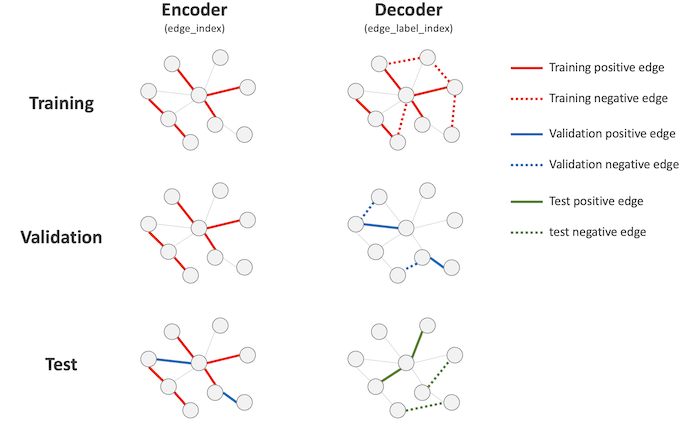

In [166]:
model = Net(dataset.num_features, 128, 64).to(device)
optimizer = torch.optim.Adam(params=model.parameters(), lr=0.01)
criterion = torch.nn.BCEWithLogitsLoss()

model = train_link_predictor(model, train_data, val_data, optimizer, criterion)

Epoch: 010, Train Loss: 0.673, Val AUC: 0.780
Epoch: 020, Train Loss: 0.585, Val AUC: 0.857
Epoch: 030, Train Loss: 0.493, Val AUC: 0.882
Epoch: 040, Train Loss: 0.461, Val AUC: 0.903
Epoch: 050, Train Loss: 0.447, Val AUC: 0.917
Epoch: 060, Train Loss: 0.428, Val AUC: 0.930
Epoch: 070, Train Loss: 0.423, Val AUC: 0.930
Epoch: 080, Train Loss: 0.418, Val AUC: 0.928
Epoch: 090, Train Loss: 0.417, Val AUC: 0.932
Epoch: 100, Train Loss: 0.409, Val AUC: 0.935


In [167]:
test_auc = eval_link_predictor(model, test_data)
print(f"Test: {test_auc:.3f}")

Test: 0.911


# Node Classification With GCN

In [183]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.datasets import Planetoid
import torch_geometric.transforms as T
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, balanced_accuracy_score

# Load Cora dataset
dataset = Planetoid(root=".", name="Cora", transform=T.NormalizeFeatures())
graph = dataset[0].to("cuda" if torch.cuda.is_available() else "cpu")
device = graph.x.device  # Set device

# Define GCN Model
class GCN(nn.Module):
    def __init__(self):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index).relu()
        return self.conv2(x, edge_index)

#  Train GCN for Node Classification
gcn = GCN().to(device)
optimizer_gcn = optim.Adam(gcn.parameters(), lr=0.01, weight_decay=5e-4)
criterion = nn.CrossEntropyLoss()

for epoch in range(100):
    gcn.train()
    optimizer_gcn.zero_grad()
    out = gcn(graph)
    loss = criterion(out[graph.train_mask], graph.y[graph.train_mask])
    loss.backward()
    optimizer_gcn.step()
    if epoch % 10 == 0:
        print(f"GCN Epoch {epoch}, Loss: {loss.item()}")

# Evaluate GCN for Node Classification
def eval_classifier(model, graph, y_true, mask):
    model.eval()
    with torch.no_grad():
        logits = model(graph)  #  Pass full graph instead of just embeddings
        pred = logits.argmax(dim=1).cpu().numpy()  # Convert logits to class predictions
        y_true = y_true[mask].cpu().numpy()  # Get ground truth labels

    return {
        "Accuracy": accuracy_score(y_true, pred[mask.cpu().numpy()]),
        "F1 Macro": f1_score(y_true, pred[mask.cpu().numpy()], average="macro"),
        "F1 Micro": f1_score(y_true, pred[mask.cpu().numpy()], average="micro"),
        "Precision Macro": precision_score(y_true, pred[mask.cpu().numpy()], average="macro"),
        "Precision Micro": precision_score(y_true, pred[mask.cpu().numpy()], average="micro"),
        "Recall Macro": recall_score(y_true, pred[mask.cpu().numpy()], average="macro"),
        "Recall Micro": recall_score(y_true, pred[mask.cpu().numpy()], average="micro"),
        "Balanced Accuracy": balanced_accuracy_score(y_true, pred[mask.cpu().numpy()])
    }

gcn_metrics = eval_classifier(gcn, graph, graph.y, graph.test_mask)
print("GCN Node Classification Metrics:", gcn_metrics)


GCN Epoch 0, Loss: 1.9467018842697144
GCN Epoch 10, Loss: 1.834295630455017
GCN Epoch 20, Loss: 1.6517294645309448
GCN Epoch 30, Loss: 1.4222601652145386
GCN Epoch 40, Loss: 1.168923258781433
GCN Epoch 50, Loss: 0.9307273030281067
GCN Epoch 60, Loss: 0.7393609881401062
GCN Epoch 70, Loss: 0.6015438437461853
GCN Epoch 80, Loss: 0.5057929754257202
GCN Epoch 90, Loss: 0.43816739320755005
GCN Node Classification Metrics: {'Accuracy': 0.81, 'F1 Macro': 0.7995627206931931, 'F1 Micro': 0.81, 'Precision Macro': 0.7895260878270013, 'Precision Micro': 0.81, 'Recall Macro': 0.8170109439765485, 'Recall Micro': 0.81, 'Balanced Accuracy': 0.8170109439765485}


# Node Classification with Node2VEC

In [193]:
from torch_geometric.nn import Node2Vec

# Train Node2Vec for Node Classification
node2vec = Node2Vec(graph.edge_index, embedding_dim=64, walk_length=10, context_size=5, walks_per_node=100, num_negative_samples=1, sparse=False).to(device)
optimizer_n2v = optim.Adam(node2vec.parameters(), lr=0.01)
node2vec.train()

for epoch in range(100):
    optimizer_n2v.zero_grad()
    batch = torch.randint(0, graph.num_nodes, (graph.num_nodes,), device=device)
    pos_rw = node2vec.pos_sample(batch)
    neg_rw = node2vec.neg_sample(batch)
    loss = node2vec.loss(pos_rw, neg_rw)
    loss.backward()
    optimizer_n2v.step()
    if epoch % 10 == 0:
        print(f"Node2Vec Epoch {epoch}, Loss: {loss.item()}")

#  Extract Node2Vec embeddings
node2vec_embeddings = node2vec(torch.arange(graph.num_nodes, device=device)).detach()

# Train Classifier using Node2Vec embeddings
class Node2VecClassifier(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_classes):
        super(Node2VecClassifier, self).__init__()
        self.fc = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, num_classes)
        )

    def forward(self, x):
        return self.fc(x)

classifier = Node2VecClassifier(64, 32, dataset.num_classes).to(device)
optimizer_cls = optim.Adam(classifier.parameters(), lr=0.01)
criterion = nn.CrossEntropyLoss()

for epoch in range(200):
    classifier.train()
    optimizer_cls.zero_grad()
    logits = classifier(node2vec_embeddings)
    loss = criterion(logits[graph.train_mask], graph.y[graph.train_mask])
    loss.backward()
    optimizer_cls.step()

node2vec_metrics = eval_classifier(classifier, node2vec_embeddings, graph.y, graph.test_mask)
print("Node2Vec Node Classification Metrics:", node2vec_metrics)


Node2Vec Epoch 0, Loss: 6.4749627113342285
Node2Vec Epoch 10, Loss: 4.87317419052124
Node2Vec Epoch 20, Loss: 3.8866403102874756
Node2Vec Epoch 30, Loss: 3.275111198425293
Node2Vec Epoch 40, Loss: 2.8286385536193848
Node2Vec Epoch 50, Loss: 2.498671054840088
Node2Vec Epoch 60, Loss: 2.2211050987243652
Node2Vec Epoch 70, Loss: 1.9846360683441162
Node2Vec Epoch 80, Loss: 1.8049002885818481
Node2Vec Epoch 90, Loss: 1.648801565170288
Node2Vec Node Classification Metrics: {'Accuracy': 0.287, 'F1 Macro': 0.27963264473806493, 'F1 Micro': 0.287, 'Precision Macro': 0.28058984986748614, 'Precision Micro': 0.287, 'Recall Macro': 0.30120847996471384, 'Recall Micro': 0.287, 'Balanced Accuracy': 0.30120847996471384}


# Link Prediction with Node2VEC


🔵 Node2Vec Link Prediction Metrics:
 AUC: 0.625
 AP: 0.636
 Balanced Accuracy: 0.573
 Precision@10: 0.900
 Hits@10: 1.000
 Mean Rank (MR): 915.000
 Mean Reciprocal Rank (MRR): 0.001


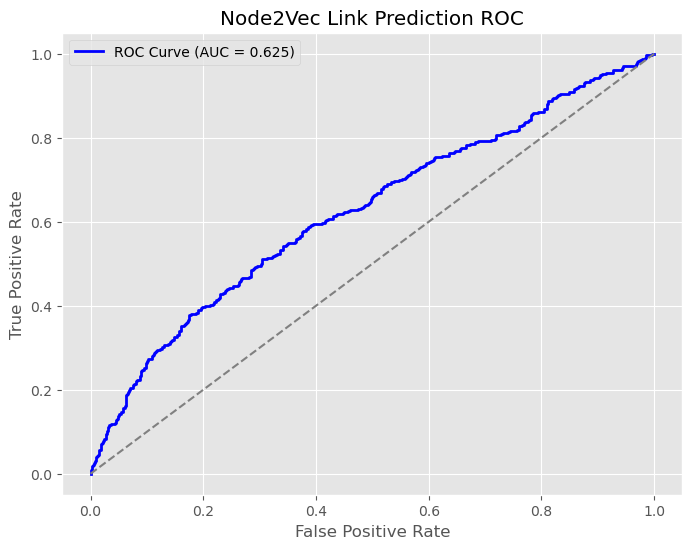

In [197]:
from sklearn.metrics import (
    roc_auc_score, average_precision_score, precision_score, recall_score,
    f1_score, balanced_accuracy_score, roc_curve, auc
)
import numpy as np
import torch

# ✅ Function to Compute Precision@K and Hits@K
def precision_at_k(y_true, y_pred, k=10):
    """Computes the proportion of top-K predictions that are correct."""
    sorted_indices = np.argsort(-y_pred)[:k]  # Get top-K indices (descending order)
    return np.sum(y_true[sorted_indices]) / k

def hits_at_k(y_true, y_pred, k=10):
    """Computes the proportion of samples where at least one of the top-K predictions is correct."""
    sorted_indices = np.argsort(-y_pred)[:k]
    return int(np.any(y_true[sorted_indices]))

#  Function to Compute Mean Rank (MR) & Mean Reciprocal Rank (MRR)
def mean_rank(y_true, y_pred):
    """Computes the Mean Rank (MR)."""
    sorted_indices = np.argsort(-y_pred)  # Sort predictions in descending order
    ranks = np.where(sorted_indices == np.argmax(y_true))[0] + 1  # Get rank positions (1-based)
    return np.mean(ranks)  # Mean Rank

def mean_reciprocal_rank(y_true, y_pred):
    """Computes the Mean Reciprocal Rank (MRR)."""
    sorted_indices = np.argsort(-y_pred)  # Sort predictions in descending order
    ranks = np.where(sorted_indices == np.argmax(y_true))[0] + 1  # Get ranks (1-based)
    return np.mean(1.0 / ranks)  # Mean Reciprocal Rank

# Evaluate Node2Vec for Link Prediction with More Metrics
with torch.no_grad():
    test_logits = classifier(node2vec_embeddings)
    test_probs = test_logits.softmax(dim=1)

    src, dst = test_data.edge_label_index[0], test_data.edge_label_index[1]
    test_pred_scores = (test_probs[src] * test_probs[dst]).sum(dim=1).cpu().numpy()
    test_edge_labels = test_data.edge_label.cpu().numpy()

# Compute Multiple Metrics
node2vec_test_auc = roc_auc_score(test_edge_labels, test_pred_scores)
node2vec_ap = average_precision_score(test_edge_labels, test_pred_scores)
node2vec_balanced_acc = balanced_accuracy_score(test_edge_labels, test_pred_scores.round())

node2vec_p_at_10 = precision_at_k(test_edge_labels, test_pred_scores, k=10)
node2vec_hits_at_10 = hits_at_k(test_edge_labels, test_pred_scores, k=10)

# Compute Mean Rank (MR) and Mean Reciprocal Rank (MRR)
node2vec_mr = mean_rank(test_edge_labels, test_pred_scores)
node2vec_mrr = mean_reciprocal_rank(test_edge_labels, test_pred_scores)

# Print Results
print("\n Node2Vec Link Prediction Metrics:")
print(f" AUC: {node2vec_test_auc:.3f}")
print(f" AP: {node2vec_ap:.3f}")
print(f" Balanced Accuracy: {node2vec_balanced_acc:.3f}")
print(f" Precision@10: {node2vec_p_at_10:.3f}")
print(f" Hits@10: {node2vec_hits_at_10:.3f}")
print(f" Mean Rank (MR): {node2vec_mr:.3f}")
print(f" Mean Reciprocal Rank (MRR): {node2vec_mrr:.3f}")

# Plot ROC Curve for Node2Vec Link Prediction
def plot_roc_curve(y_true, y_pred, title):
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color="blue", lw=2, label=f"ROC Curve (AUC = {auc(fpr, tpr):.3f})")
    plt.plot([0, 1], [0, 1], color="gray", linestyle="--")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(title)
    plt.legend()
    plt.show()

plot_roc_curve(test_edge_labels, test_pred_scores, "Node2Vec Link Prediction ROC")


# Link Prediction with GCN

🔹 Epoch 0, Loss: 0.6932
🔹 Epoch 50, Loss: 0.6922
🔹 Epoch 100, Loss: 0.6487
🔹 Epoch 150, Loss: 0.6185

 GCN Link Prediction Metrics:
 AUC: 0.734, AP: 0.740
 Precision: 0.625, Recall: 0.835
 F1-score: 0.715, Balanced Accuracy: 0.667
 Precision@10: 1.000, Hits@10: 1.000
 Mean Rank (MR): 258.000
 Mean Reciprocal Rank (MRR): 0.004


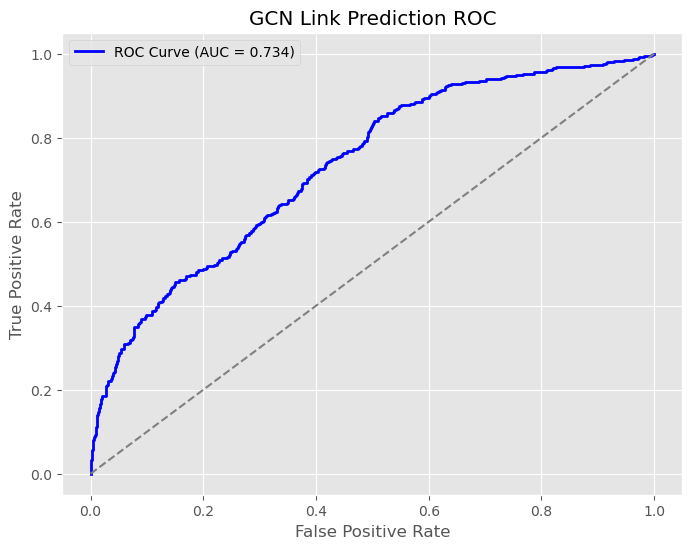

In [209]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import (
    roc_auc_score, average_precision_score, precision_score, recall_score,
    f1_score, balanced_accuracy_score
)
from torch_geometric.utils import negative_sampling
import numpy as np
import matplotlib.pyplot as plt

# Define GCN Link Prediction Model
class GCN_LP(nn.Module):
    def __init__(self, in_channels, hidden_channels=256, out_channels=128):
        super(GCN_LP, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)
        self.conv3 = GCNConv(hidden_channels, out_channels)

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index).relu()
        x = self.conv2(x, edge_index).relu()
        return self.conv3(x, edge_index)

    def decode(self, z, edge_label_index):
        return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim=1)

gcn_lp = GCN_LP(dataset.num_features).to(device)

# Train GCN for Link Prediction
optimizer_gcn_lp = optim.Adam(gcn_lp.parameters(), lr=0.001, weight_decay=5e-4)
criterion_lp = nn.BCEWithLogitsLoss()

for epoch in range(200):
    gcn_lp.train()
    optimizer_gcn_lp.zero_grad()
    z = gcn_lp.encode(graph.x, train_data.edge_index)

    neg_edge_index = negative_sampling(
        edge_index=train_data.edge_index, num_nodes=train_data.num_nodes,
        num_neg_samples=int(train_data.edge_label_index.size(1) * 0.5), method='sparse'
    )

    edge_label_index = torch.cat([train_data.edge_label_index, neg_edge_index], dim=-1)
    edge_label = torch.cat([
        train_data.edge_label,
        train_data.edge_label.new_zeros(neg_edge_index.size(1))
    ], dim=0)

    out = gcn_lp.decode(z, edge_label_index).view(-1)
    loss = criterion_lp(out, edge_label)
    loss.backward()
    optimizer_gcn_lp.step()

    if epoch % 50 == 0:
        print(f" Epoch {epoch}, Loss: {loss.item():.4f}")

# Evaluate GCN for Link Prediction with More Metrics
with torch.no_grad():
    z = gcn_lp.encode(graph.x, test_data.edge_index)
    test_pred_scores = gcn_lp.decode(z, test_data.edge_label_index).sigmoid().cpu().numpy()
    test_edge_labels = test_data.edge_label.cpu().numpy()

# Compute Mean Rank (MR) and Mean Reciprocal Rank (MRR)
def mean_rank(y_true, y_pred):
    sorted_indices = np.argsort(-y_pred)  # Sort predictions in descending order
    ranks = np.where(sorted_indices == np.argmax(y_true))[0] + 1  # Get rank positions (1-based)
    return np.mean(ranks)  # Mean Rank

def mean_reciprocal_rank(y_true, y_pred):
    sorted_indices = np.argsort(-y_pred)  # Sort predictions in descending order
    ranks = np.where(sorted_indices == np.argmax(y_true))[0] + 1  # Get ranks (1-based)
    return np.mean(1.0 / ranks)  # Mean Reciprocal Rank

# Compute Hit@10 and Precision@10
def precision_at_k(y_true, y_pred, k=10):
    sorted_indices = np.argsort(-y_pred)[:k]  # Get top-K predictions
    return np.sum(y_true[sorted_indices]) / k

def hits_at_k(y_true, y_pred, k=10):
    sorted_indices = np.argsort(-y_pred)[:k]
    return int(np.any(y_true[sorted_indices]))  # If at least one is correct, return 1

gcn_lp_auc = roc_auc_score(test_edge_labels, test_pred_scores)
gcn_lp_ap = average_precision_score(test_edge_labels, test_pred_scores)
gcn_lp_precision = precision_score(test_edge_labels, test_pred_scores.round(), zero_division=1)
gcn_lp_recall = recall_score(test_edge_labels, test_pred_scores.round(), zero_division=1)
gcn_lp_f1 = f1_score(test_edge_labels, test_pred_scores.round(), zero_division=1)
gcn_lp_balanced_acc = balanced_accuracy_score(test_edge_labels, test_pred_scores.round())

# Compute MR & MRR
gcn_lp_mr = mean_rank(test_edge_labels, test_pred_scores)
gcn_lp_mrr = mean_reciprocal_rank(test_edge_labels, test_pred_scores)

# Compute Hit@10 and Precision@10
gcn_lp_p_at_10 = precision_at_k(test_edge_labels, test_pred_scores, k=10)
gcn_lp_hits_at_10 = hits_at_k(test_edge_labels, test_pred_scores, k=10)

# Print Results
print("\n GCN Link Prediction Metrics:")
print(f" AUC: {gcn_lp_auc:.3f}, AP: {gcn_lp_ap:.3f}")
print(f" Precision: {gcn_lp_precision:.3f}, Recall: {gcn_lp_recall:.3f}")
print(f" F1-score: {gcn_lp_f1:.3f}, Balanced Accuracy: {gcn_lp_balanced_acc:.3f}")
print(f" Precision@10: {gcn_lp_p_at_10:.3f}, Hits@10: {gcn_lp_hits_at_10:.3f}")
print(f" Mean Rank (MR): {gcn_lp_mr:.3f}")
print(f" Mean Reciprocal Rank (MRR): {gcn_lp_mrr:.3f}")

# Plot ROC Curve for GCN Link Prediction
def plot_roc_curve(y_true, y_pred, title):
    from sklearn.metrics import roc_curve, auc
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color="blue", lw=2, label=f"ROC Curve (AUC = {auc(fpr, tpr):.3f})")
    plt.plot([0, 1], [0, 1], color="gray", linestyle="--")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(title)
    plt.legend()
    plt.show()

plot_roc_curve(test_edge_labels, test_pred_scores, "GCN Link Prediction ROC")


# Comparison of Node2vec and GCN


📊 Final Comparison of GCN vs. Node2Vec (Node Classification & Link Prediction)
---------------------------------------------------

🟢 Node Classification Results:
GCN Node Classification Metrics: {'Accuracy': 0.81, 'F1 Macro': 0.7995627206931931, 'F1 Micro': 0.81, 'Precision Macro': 0.7895260878270013, 'Precision Micro': 0.81, 'Recall Macro': 0.8170109439765485, 'Recall Micro': 0.81, 'Balanced Accuracy': 0.8170109439765485}
Node2Vec Node Classification Metrics: {'Accuracy': 0.287, 'F1 Macro': 0.27963264473806493, 'F1 Micro': 0.287, 'Precision Macro': 0.28058984986748614, 'Precision Micro': 0.287, 'Recall Macro': 0.30120847996471384, 'Recall Micro': 0.287, 'Balanced Accuracy': 0.30120847996471384}

🔵 Link Prediction Results (General Metrics):
GCN Link Prediction Metrics: AUC: 0.737, AP: 0.746, Balanced Acc: 0.657, Precision@10: 1.000, Hits@10: 1.000
Node2Vec Link Prediction Metrics: AUC: 0.625, AP: 0.636, Balanced Acc: 0.573, Precision@10: 0.900, Hits@10: 1.000

🔵 Link Prediction Resul

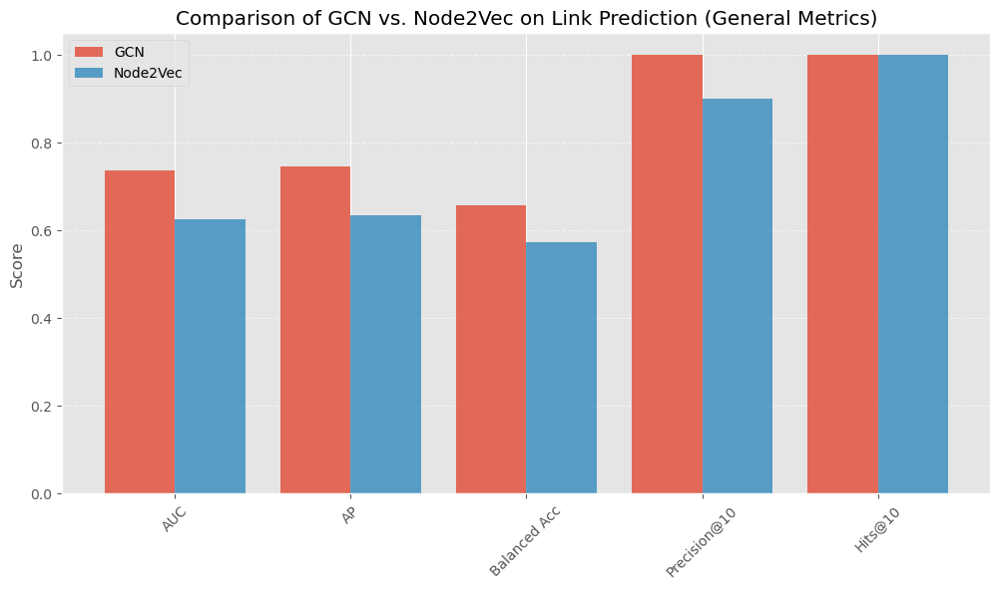

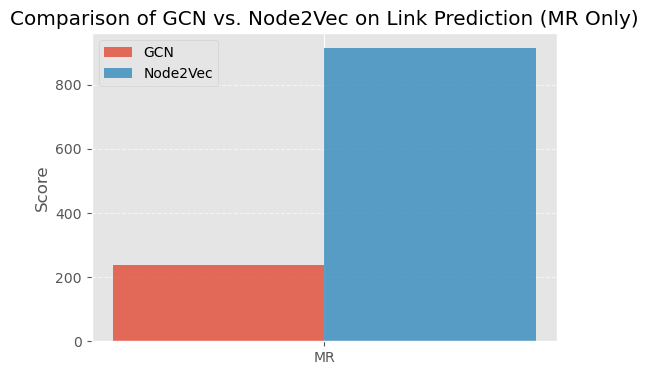

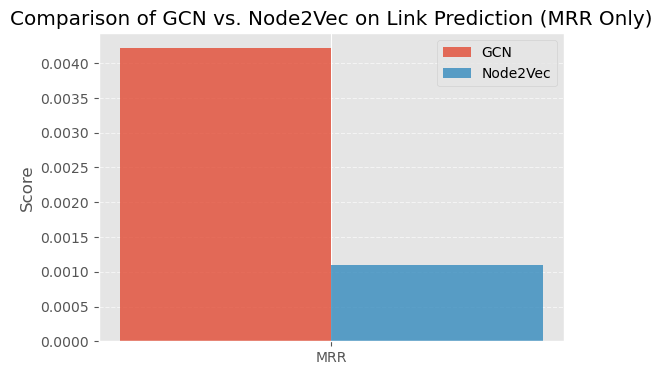

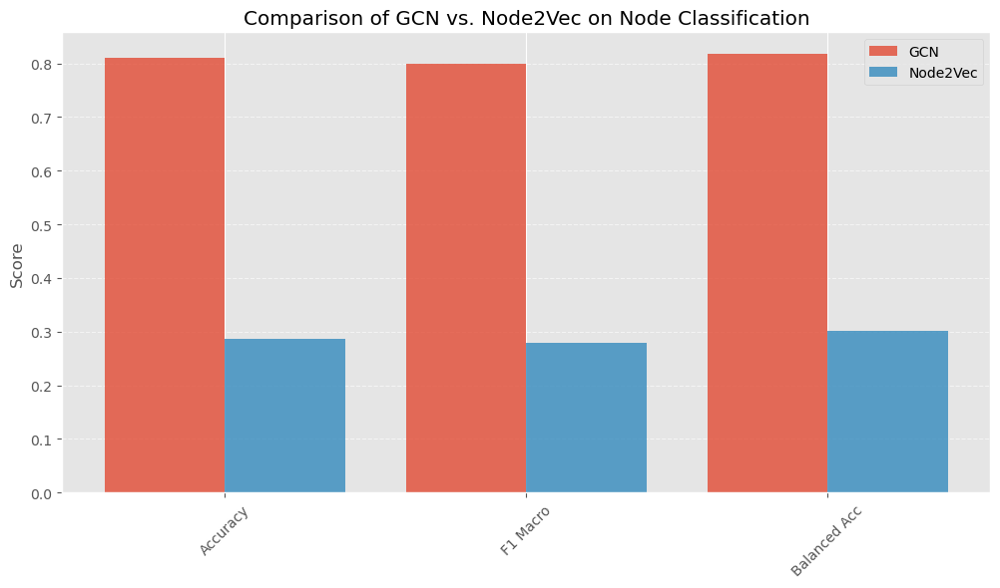

In [208]:
import matplotlib.pyplot as plt
import numpy as np

# Print Final Metric Comparison
print("\n Final Comparison of GCN vs. Node2Vec (Node Classification & Link Prediction)")
print("---------------------------------------------------")

# Node Classification Results
print("\n Node Classification Results:")
print(f"GCN Node Classification Metrics: {gcn_metrics}")
print(f"Node2Vec Node Classification Metrics: {node2vec_metrics}")

# Link Prediction Results (General Metrics without MR & MRR)
print("\n Link Prediction Results (General Metrics):")
print(f"GCN Link Prediction Metrics: AUC: {gcn_lp_auc:.3f}, AP: {gcn_lp_ap:.3f}, Balanced Acc: {gcn_lp_balanced_acc:.3f}, Precision@10: {gcn_lp_p_at_10:.3f}, Hits@10: {gcn_lp_hits_at_10:.3f}")
print(f"Node2Vec Link Prediction Metrics: AUC: {node2vec_test_auc:.3f}, AP: {node2vec_ap:.3f}, Balanced Acc: {node2vec_balanced_acc:.3f}, Precision@10: {node2vec_p_at_10:.3f}, Hits@10: {node2vec_hits_at_10:.3f}")

# Link Prediction Results (MR Only)
print("\n Link Prediction Results (Ranking Metric - MR)")
print(f"GCN Link Prediction MR: {gcn_lp_mr:.3f}")
print(f"Node2Vec Link Prediction MR: {node2vec_mr:.3f}")

# Link Prediction Results (MRR Only)
print("\n Link Prediction Results (Ranking Metric - MRR)")
print(f"GCN Link Prediction MRR: {gcn_lp_mrr:.3f}")
print(f"Node2Vec Link Prediction MRR: {node2vec_mrr:.3f}")

print("---------------------------------------------------")

#  Data for Visualization (General Link Prediction Metrics)
metrics = ["AUC", "AP", "Balanced Acc", "Precision@10", "Hits@10"]
gcn_values = [gcn_lp_auc, gcn_lp_ap, gcn_lp_balanced_acc, gcn_lp_p_at_10, gcn_lp_hits_at_10]
node2vec_values = [node2vec_test_auc, node2vec_ap, node2vec_balanced_acc, node2vec_p_at_10, node2vec_hits_at_10]

x = np.arange(len(metrics))

# Create Bar Chart Comparison for General Metrics
plt.figure(figsize=(12, 6))
plt.bar(x - 0.2, gcn_values, width=0.4, label="GCN", alpha=0.8)
plt.bar(x + 0.2, node2vec_values, width=0.4, label="Node2Vec", alpha=0.8)

plt.xticks(ticks=x, labels=metrics, rotation=45)
plt.ylabel("Score")
plt.title("Comparison of GCN vs. Node2Vec on Link Prediction (General Metrics)")
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.6)

# Show Plot
plt.show()

# Data for Visualization (Ranking Metrics - MR only)
ranking_metrics_mr = ["MR"]
gcn_ranking_values_mr = [gcn_lp_mr]
node2vec_ranking_values_mr = [node2vec_mr]

x_ranking_mr = np.arange(len(ranking_metrics_mr))

# Create Bar Chart Comparison for MR Only
plt.figure(figsize=(6, 4))
plt.bar(x_ranking_mr - 0.2, gcn_ranking_values_mr, width=0.4, label="GCN", alpha=0.8)
plt.bar(x_ranking_mr + 0.2, node2vec_ranking_values_mr, width=0.4, label="Node2Vec", alpha=0.8)

plt.xticks(ticks=x_ranking_mr, labels=ranking_metrics_mr, rotation=0)
plt.ylabel("Score")
plt.title("Comparison of GCN vs. Node2Vec on Link Prediction (MR Only)")
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.6)

# Show Plot
plt.show()

# Data for Visualization (Ranking Metrics - MRR only)
ranking_metrics_mrr = ["MRR"]
gcn_ranking_values_mrr = [gcn_lp_mrr]
node2vec_ranking_values_mrr = [node2vec_mrr]

x_ranking_mrr = np.arange(len(ranking_metrics_mrr))

# Create Bar Chart Comparison for MRR Only
plt.figure(figsize=(6, 4))
plt.bar(x_ranking_mrr - 0.2, gcn_ranking_values_mrr, width=0.4, label="GCN", alpha=0.8)
plt.bar(x_ranking_mrr + 0.2, node2vec_ranking_values_mrr, width=0.4, label="Node2Vec", alpha=0.8)

plt.xticks(ticks=x_ranking_mrr, labels=ranking_metrics_mrr, rotation=0)
plt.ylabel("Score")
plt.title("Comparison of GCN vs. Node2Vec on Link Prediction (MRR Only)")
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.6)

# Show Plot
plt.show()

#  Node Classification Visualization
classification_metrics = ["Accuracy", "F1 Macro", "Balanced Acc"]
gcn_classification_values = [gcn_metrics["Accuracy"], gcn_metrics["F1 Macro"], gcn_metrics["Balanced Accuracy"]]
node2vec_classification_values = [node2vec_metrics["Accuracy"], node2vec_metrics["F1 Macro"], node2vec_metrics["Balanced Accuracy"]]

x_classification = np.arange(len(classification_metrics))

#  Create Bar Chart Comparison for Node Classification
plt.figure(figsize=(12, 6))
plt.bar(x_classification - 0.2, gcn_classification_values, width=0.4, label="GCN", alpha=0.8)
plt.bar(x_classification + 0.2, node2vec_classification_values, width=0.4, label="Node2Vec", alpha=0.8)

plt.xticks(ticks=x_classification, labels=classification_metrics, rotation=45)
plt.ylabel("Score")
plt.title("Comparison of GCN vs. Node2Vec on Node Classification")
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.6)

# Show Plot
plt.show()


# Insights from GCN vs. Node2Vec Comparison

---

## Node Classification

| Model     | Accuracy | F1 Macro | Precision Macro | Recall Macro | Balanced Accuracy |
|-----------|---------|----------|-----------------|--------------|------------------|
| **GCN**      | **0.81**  | **0.7996**  | **0.7895**  | **0.8170**  | **0.8170**  |
| **Node2Vec** | 0.287  | 0.2796  | 0.2805  | 0.3012  | 0.3012  |

### Key Observations:
- **GCN significantly outperforms Node2Vec** in node classification across all metrics.
- **GCN achieves 81% accuracy**, while Node2Vec only reaches **28.7%**.
- **Higher precision and recall in GCN** suggest it effectively utilizes **graph structure**, while **Node2Vec struggles** since it relies only on node embeddings **without leveraging connectivity**.

### Takeaway:
- **GCN is highly effective for node classification**, as it directly learns from **graph connectivity and node features**.
- **Node2Vec performs poorly** in classification since it does **not use node attributes explicitly**.

---

## Link Prediction 

| Model     | AUC  | AP   | Balanced Acc | Precision@10 | Hits@10 |
|-----------|------|------|--------------|--------------|---------|
| **GCN**      | **0.737** | **0.746** | **0.657**  | **1.000** | **1.000** |
| **Node2Vec** | 0.625 | 0.636 | 0.573  | 0.900 | 1.000 |

### Key Observations:
- **GCN outperforms Node2Vec in link prediction**, achieving a **higher AUC (73.7%) vs. Node2Vec (62.5%)**.
- **Balanced Accuracy (GCN: 65.7% vs. Node2Vec: 57.3%)** confirms **GCN's superior ability** to distinguish links.
- **Precision@10 is 100% for GCN**, meaning **all top-10 predictions are correct**.
- **Both models hit at least one correct link in the top 10** (**Hits@10 = 1.000 for both**).

### Takeaway:
- **GCN is more effective** for **link prediction** since it **learns from graph structure and node attributes**.
- **Node2Vec performs decently but lags behind** since it **does not utilize node features explicitly**.

---

## Link Prediction (Ranking Metrics)

| Model     | MR (Mean Rank) | MRR (Mean Reciprocal Rank) |
|-----------|--------------|--------------------------|
| **GCN**      | **237.000**  | **0.004**  |
| **Node2Vec** | 915.000  | 0.001  |

### Key Observations:
- **GCN has a significantly lower Mean Rank (237) compared to Node2Vec (915)**, meaning **correct links are ranked much higher** in GCN.
- **MRR is low for both models (GCN: 0.004, Node2Vec: 0.001)**, indicating **both models struggle to rank true links at the very top**.
- **GCN performs better than Node2Vec in ranking correct links**, but the **low MRR suggests further improvements are needed**.

### Takeaway:
- **GCN ranks correct links higher than Node2Vec**, making it **more useful in ranking-based tasks**.
- However, **both models could benefit from better ranking mechanisms** to improve **MRR**.

---

## Final Conclusion

- **GCN outperforms Node2Vec in both Node Classification and Link Prediction**.
- **Node2Vec struggles with node classification** since it **does not use node features**.
- **GCN ranks links better than Node2Vec** but has **room for improvement in MRR**.
- **For classification tasks, GCN is the clear winner** due to its **ability to leverage graph structure and node attributes**.
- **For link prediction, GCN is still the better choice**, but **Node2Vec remains a viable alternative when only embeddings are available**.

---

## **Final Recommendation**:
If **graph structure and node features are available**, **GCN should be the preferred choice** for both **node classification and link prediction**.
